# Binary classification based on Logistic Regression using non-linear regression function

## import library

In [105]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

## load data

In [106]:
fname_data1 = 'assignment_09_data1.txt'
fname_data2 = 'assignment_09_data2.txt'

data1 = np.genfromtxt(fname_data1, delimiter=',')
data2 = np.genfromtxt(fname_data2, delimiter=',')

num_data=data1.shape[0]
label1 = np.zeros(num_data)
label2 = np.zeros(num_data)

for i in range(num_data):
    label1[i] = data1[i,2]
    label2[i] = data2[i,2]

# data[:,0] : x
# data[:,1] : y
# data[:,2] : label {0, 1}

## plot the data

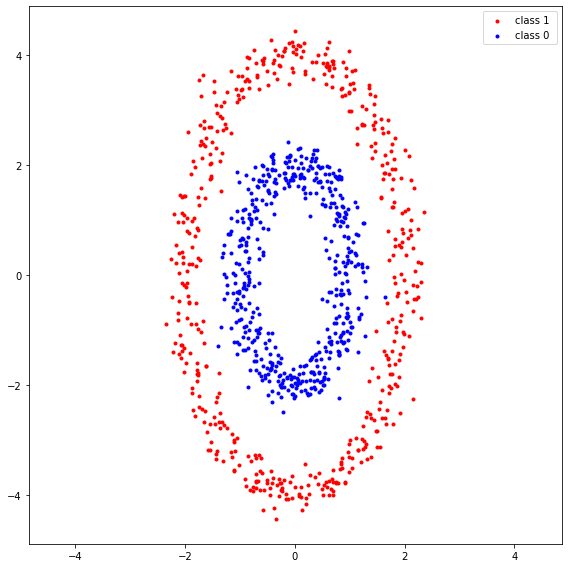

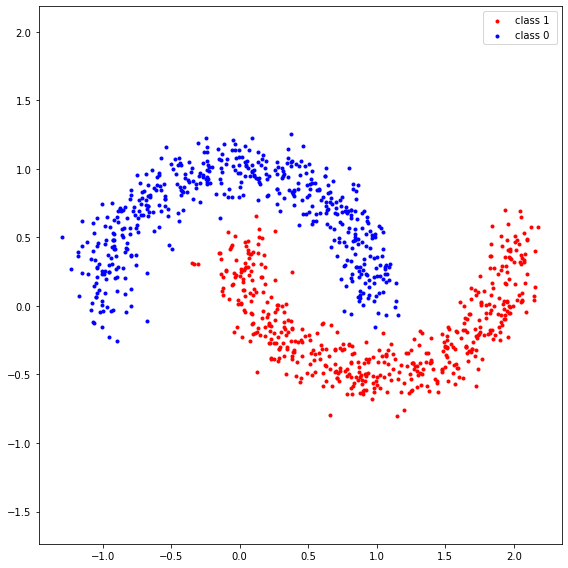

In [107]:
plt.figure(figsize=(8,8))

plt.scatter(data1[:, 0][label1 == 1],data1[:, 1][label1 == 1], c="r", marker=".", label="class 1 ")
plt.scatter(data1[:, 0][label1 == 0],data1[:, 1][label1 == 0], c="b", marker=".", label="class 0 ")

plt.axis('equal')
plt.legend()
plt.tight_layout()

plt.figure(figsize=(8,8))

plt.scatter(data2[:, 0][label2 == 1],data2[:, 1][label2 == 1], c="r", marker=".", label="class 1 ")
plt.scatter(data2[:, 0][label2 == 0],data2[:, 1][label2 == 0], c="b", marker=".", label="class 0 ")

plt.axis('equal')
plt.legend()
plt.tight_layout()

plt.show()

## define the feature function for each data to obtain the best accuracy

In [108]:
def feature_function1(x, y):
    
    feature = np.array([np.ones(x.size),x,y,x**3,y**3])
    
    return feature

In [109]:
def feature_function2(x, y):
    
    feature = np.array([np.ones(x.size),x,x**2,x**3,x**4,y])
    
    return feature

## define regression function with a vector $\theta$ model parameters and input data 

In [110]:
def regression_function(theta, feature):
    
    value = theta@feature
    
    return value

## define sigmoid function with input $x$

In [111]:
def logistic_function(theta,feature):
    
    x = regression_function(theta,feature)
    z = 1/(1+np.exp((-1)*x))
    
    return z

## define loss function with feature and label based on the logistic regression

In [120]:
def compute_loss_feature(theta, feature, label):
    
    Loss = 0
    feature=feature.T
    for i in range(num_data):
        h = logistic_function(theta,feature[i])
        
        Loss = Loss + label[i]*np.log(h)+(1-label[i])*np.log((1-h))
    
    Loss = Loss/num_data*(-1)
    
    return Loss

## define gradient vector for the model parameters $\theta$

In [113]:
def compute_gradient_feature(theta, feature, label):
    
    gradient = np.zeros(theta.size)
    feature=feature.T
    for i in range(num_data) :
        f = logistic_function(theta,feature[i])
        h = f-label[i]
        gradient = gradient + h*np.array((feature[i]))
    
    gradient = gradient/num_data
    
    return gradient

## compute the accuracy

In [ ]:
def compute_accuracy(theta, feature, label):
    
    h = np.array(logistic_function(theta,feature))
    print("h",h)
    p = (h >= 0.5)
    print("p",p)
    sum = np.sum(p.astype(int) == label)
    print("correct",correct)
    accuracy = sum/num_data
   
    return accuracy

## gradient descent for the model parameters $\theta$

In [115]:
num_iteration   = 30000         # USE THIS VALUE for the number of gradient descent iterations
learning_rate   = 0.004    # USE THIS VALUE for the learning rate

theta1 = np.array((0,0,0,0,0))
theta2 = np.array((0,0,0,0,0,0))

theta1_iteration =np.zeros((num_iteration, theta1.size))
loss1_iteration = np.zeros(num_iteration, dtype=object)

theta2_iteration =np.zeros((num_iteration, theta2.size))
loss2_iteration = np.zeros(num_iteration, dtype=object)

In [116]:
feature1 = feature_function1(data1[:, 0],data1[:, 1])
feature2 = feature_function2(data2[:, 0],data2[:, 1])
print(feature1.shape)

(5, 1000)


In [ ]:
for i in range(num_iteration):
    theta1 = theta1 - learning_rate * compute_gradient_feature(theta1, feature1, label1)
    theta2 = theta2 - learning_rate * compute_gradient_feature(theta2, feature2, label2)
   
    loss1 = compute_loss_feature(theta1, feature1, label1)
    loss2 = compute_loss_feature(theta2, feature2, label2)
   
    theta1_iteration[i] = theta1
    theta2_iteration[i] = theta2
    loss1_iteration[i] = loss1
    loss2_iteration[i] = loss2
   
    print("loss1",loss1_iteration[i]," theta1",theta1_iteration[i])
    print("loss2",loss2_iteration[i]," theta2",theta2_iteration[i])



theta1_optimal = theta1
theta2_optimal = theta2

loss1 0.6931392747181637  theta1 [-6.81866655e-08 -1.34493194e-05 -2.91084490e-05  4.31839914e-05
  2.92641982e-04]
loss2 0.6755085055132347  theta2 [-4.29822174e-05  2.93946523e-03  2.86802882e-03  7.42138339e-03
  1.17458915e-02 -2.34363555e-03]
loss1 0.6931391366709422  theta1 [-1.10580269e-07 -1.80284500e-05 -4.56560742e-05  5.73106864e-05
  3.01454831e-04]
loss2 0.6704479498272833  theta2 [-8.47312741e-05  3.87162199e-03  3.73724400e-03  9.73410398e-03
  1.53550171e-02 -3.12529645e-03]
loss1 0.6931390080663792  theta1 [-1.54186673e-07 -2.26510516e-05 -6.25726729e-05  7.12875163e-05
  3.05291112e-04]
loss2 0.6657414196316458  theta2 [-0.00013917  0.00478169  0.00456631  0.01197234  0.0188227  -0.00390712]
loss1 0.6931388814791408  theta1 [-1.98280362e-07 -2.73162426e-05 -7.96016601e-05  8.51148368e-05
  3.07460954e-04]
loss2 0.6613588865666162  theta2 [-0.00020568  0.00567069  0.00535715  0.01413972  0.02215592 -0.00468906]
loss1 0.6931387560561109  theta1 [-2.42617567e-07 -3.20233

loss1 0.6931347856676008  theta1 [-1.91100945e-06 -2.25067438e-04 -7.00395006e-04  5.06945421e-04
  3.56231365e-04]
loss2 0.5941739352131123  theta2 [-0.0075417   0.02997066  0.01938312  0.0663139   0.09296531 -0.03346593]
loss1 0.6931346869900922  theta1 [-1.95903073e-06 -2.30979842e-04 -7.16861637e-04  5.16296567e-04
  3.57512928e-04]
loss2 0.5933640759842636  theta2 [-0.00781402  0.03049321  0.01953281  0.06730629  0.09411068 -0.03423627]
loss1 0.6931345887931147  theta1 [-2.00712962e-06 -2.36916983e-04 -7.33311959e-04  5.25557229e-04
  3.58793185e-04]
loss2 0.5925740531826801  theta2 [-0.00808853  0.03101154  0.01967568  0.06828634  0.09523396 -0.03500616]
loss1 0.6931344910677691  theta1 [-2.05530521e-06 -2.42878517e-04 -7.49745982e-04  5.34728574e-04
  3.60072137e-04]
loss2 0.5918028981633706  theta2 [-0.00836516  0.03152577  0.01981193  0.06925445  0.09633587 -0.0357756 ]
loss1 0.6931343938053822  theta1 [-2.10355659e-06 -2.48864102e-04 -7.66163719e-04  5.43811756e-04
  3.613497

loss1 0.6931313126254321  theta1 [-3.78340815e-06 -4.64519333e-04 -1.31475956e-03  8.07505631e-04
  4.04024202e-04]
loss2 0.5721407917381409  theta2 [-0.01897264  0.04759229  0.02157648  0.0976967   0.12533743 -0.06241735]
loss1 0.693131227475873  theta1 [-3.83381817e-06 -4.71162852e-04 -1.33061471e-03  8.14124944e-04
  4.05257098e-04]
loss2 0.5717092583781148  theta2 [-0.01929389  0.04800915  0.0215642   0.098395    0.12596906 -0.06317038]
loss1 0.6931311425863406  theta1 [-3.88427759e-06 -4.77820699e-04 -1.34645401e-03  8.20688983e-04
  4.06488740e-04]
loss2 0.5712822794651419  theta2 [-0.01961582  0.04842419  0.02154935  0.09908853  0.12659268 -0.06392297]
loss1 0.6931310579533878  theta1 [-3.93478583e-06 -4.84492662e-04 -1.36227747e-03  8.27198459e-04
  4.07719129e-04]
loss2 0.5708597219155955  theta2 [-0.0199384   0.04883743  0.02153198  0.0997774   0.12720847 -0.06467511]
loss1 0.6931309735736422  theta1 [-3.98534230e-06 -4.91178536e-04 -1.37808511e-03  8.33654074e-04
  4.0894826

loss1 0.6931283131200674  theta1 [-5.67729452e-06 -7.18405882e-04 -1.89094451e-03  1.02056838e-03
  4.48816068e-04]
loss2 0.558440557857731  theta2 [-0.0311849   0.06198887  0.01973454  0.12093285  0.14440876 -0.08998821]
loss1 0.6931282358177913  theta1 [-5.72918511e-06 -7.25458731e-04 -1.90622190e-03  1.02555137e-03
  4.50003417e-04]
loss2 0.5581181021983452  theta2 [-0.03152122  0.06235325  0.01965303  0.12150017  0.14482603 -0.09072522]
loss1 0.693128158689603  theta1 [-5.78110703e-06 -7.32519711e-04 -1.92148393e-03  1.03050006e-03
  4.51189559e-04]
loss2 0.5577974954031478  theta2 [-0.03185774  0.06271653  0.01957019  0.1220649   0.14523919 -0.09146182]
loss1 0.6931280817340493  theta1 [-5.83305988e-06 -7.39588691e-04 -1.93673061e-03  1.03541490e-03
  4.52374496e-04]
loss2 0.5574787013834164  theta2 [-0.03219443  0.06307872  0.01948605  0.12262705  0.1456483  -0.09219799]
loss1 0.6931280049497072  theta1 [-5.88504327e-06 -7.46665544e-04 -1.95196196e-03  1.04029631e-03
  4.53558228

loss1 0.6931254162368888  theta1 [-7.72092809e-06 -9.98436520e-04 -2.47550541e-03  1.19306654e-03
  4.94239840e-04]
loss2 0.5469746018094803  theta2 [-0.04438114  0.07548152  0.01573227  0.14139669  0.15811538 -0.11842635]
loss1 0.693125344879699  theta1 [-7.77378021e-06 -1.00572438e-03 -2.49019389e-03  1.19699011e-03
  4.95381044e-04]
loss2 0.5467047929164336  theta2 [-0.04472012  0.0758104   0.01561121  0.14188291  0.15840882 -0.11914744]
loss1 0.6931252736574165  theta1 [-7.82665081e-06 -1.01301640e-03 -2.50486755e-03  1.20089285e-03
  4.96521088e-04]
loss2 0.5464359605516573  theta2 [-0.04505907  0.07613852  0.01548939  0.14236748  0.15869984 -0.11986814]
loss1 0.693125202569377  theta1 [-7.87953962e-06 -1.02031250e-03 -2.51952640e-03  1.20477503e-03
  4.97659975e-04]
loss2 0.5461680917706762  theta2 [-0.04539798  0.0764659   0.01536682  0.14285042  0.15898847 -0.12058844]
loss1 0.6931251316149304  theta1 [-7.93244637e-06 -1.02761260e-03 -2.53417046e-03  1.20863690e-03
  4.98797705

loss1 0.6931225288731101  theta1 [-9.95378732e-06 -1.30731960e-03 -3.07981778e-03  1.34259435e-03
  5.41186174e-04]
loss2 0.5363617775711919  theta2 [-0.05854692  0.0887077   0.01009408  0.16056278  0.1686458  -0.14837641]
loss1 0.6931224627182562  theta1 [-1.00072091e-05 -1.31472563e-03 -3.09389561e-03  1.34583482e-03
  5.42279720e-04]
loss2 0.5361244626076198  theta2 [-0.0588815   0.08900936  0.00994822  0.16099146  0.1688581  -0.14908126]
loss1 0.6931223966778868  theta1 [-1.00606398e-05 -1.32213331e-03 -3.10795921e-03  1.34906301e-03
  5.43372155e-04]
loss2 0.5358877612827391  theta2 [-0.05921593  0.08931047  0.00980192  0.161419    0.16906887 -0.14978574]
loss1 0.6931223307516505  theta1 [-1.01140794e-05 -1.32954258e-03 -3.12200857e-03  1.35227908e-03
  5.44463482e-04]
loss2 0.5356516680899757  theta2 [-0.05955019  0.08961102  0.00965518  0.16184542  0.16927814 -0.15048985]
loss1 0.6931222649391933  theta1 [-1.01675276e-05 -1.33695341e-03 -3.13604372e-03  1.35548317e-03
  5.455537

loss1 0.6931197221467398  theta1 [-1.23105884e-05 -1.63421831e-03 -3.68595223e-03  1.47533134e-03
  5.88267254e-04]
loss2 0.5264386763182437  theta2 [-0.07308994  0.10149446  0.00331416  0.17845521  0.17671953 -0.17903945]
loss1 0.6931196607384199  theta1 [-1.23642483e-05 -1.64166115e-03 -3.69941643e-03  1.47815236e-03
  5.89313031e-04]
loss2 0.5262241951982893  theta2 [-0.07341568  0.10177441  0.0031528   0.17884105  0.17687667 -0.17972814]
loss1 0.6931195994319279  theta1 [-1.24179102e-05 -1.64910414e-03 -3.71286698e-03  1.48096622e-03
  5.90357748e-04]
loss2 0.526010154602625  theta2 [-0.07374118  0.10205391  0.00299117  0.17922606  0.1770328  -0.18041647]
loss1 0.6931195382270292  theta1 [-1.24715741e-05 -1.65654724e-03 -3.72630392e-03  1.48377301e-03
  5.91401405e-04]
loss2 0.5257965517991928  theta2 [-0.07406645  0.10233299  0.00282927  0.17961024  0.17718791 -0.18110443]
loss1 0.6931194771234859  theta1 [-1.25252397e-05 -1.66399044e-03 -3.73972724e-03  1.48657280e-03
  5.9244400

loss1 0.6931171707802448  theta1 [-1.46182676e-05 -1.95411859e-03 -4.25276164e-03  1.59109894e-03
  6.32291057e-04]
loss2 0.5175841429336913  theta2 [-0.08687273  0.11316163 -0.00383298  0.19435174  0.18265185 -0.2083339 ]
loss1 0.6931171135524674  theta1 [-1.46719051e-05 -1.96154864e-03 -4.26565141e-03  1.59367710e-03
  6.33292188e-04]
loss2 0.5173865300068425  theta2 [-0.08718753  0.11342449 -0.00400349  0.19470583  0.18277189 -0.20900751]
loss1 0.6931170564174259  theta1 [-1.47255396e-05 -1.96897800e-03 -4.27852812e-03  1.59625093e-03
  6.34292303e-04]
loss2 0.5171892671330656  theta2 [-0.08750205  0.11368699 -0.00417418  0.19505926  0.1828912  -0.20968078]
loss1 0.6931169993749318  theta1 [-1.47791710e-05 -1.97640668e-03 -4.29139177e-03  1.59882048e-03
  6.35291405e-04]
loss2 0.5169923527165803  theta2 [-0.0878163   0.11394913 -0.00434502  0.19541205  0.18300979 -0.2103537 ]
loss1 0.6931169424247932  theta1 [-1.48327993e-05 -1.98383465e-03 -4.30424239e-03  1.60138580e-03
  6.362894

loss1 0.6931146847357423  theta1 [-1.70276442e-05 -2.28762404e-03 -4.82004907e-03  1.70343467e-03
  6.76351535e-04]
loss2 0.5090177657281455  theta2 [-0.10076101  0.1246519  -0.01164283  0.20968287  0.18740637 -0.23831196]
loss1 0.6931146315017057  theta1 [-1.70810545e-05 -2.29501194e-03 -4.83236363e-03  1.70585830e-03
  6.77307998e-04]
loss2 0.5088345367561169  theta2 [-0.10106302  0.1248998  -0.01181902  0.21001051  0.18749851 -0.23897049]
loss1 0.6931145783524457  theta1 [-1.71344578e-05 -2.30239868e-03 -4.84466569e-03  1.70827927e-03
  6.78263491e-04]
loss2 0.5086515999747643  theta2 [-0.10136475  0.12514739 -0.01199529  0.21033763  0.18759013 -0.23962869]
loss1 0.6931145252877962  theta1 [-1.71878539e-05 -2.30978425e-03 -4.85695529e-03  1.71069760e-03
  6.79218015e-04]
loss2 0.5084689543554722  theta2 [-0.10166618  0.12539467 -0.01217165  0.21066423  0.18768122 -0.24028656]
loss1 0.6931144723075945  theta1 [-1.72412428e-05 -2.31716866e-03 -4.86923242e-03  1.71311333e-03
  6.801715

loss1 0.6931125699397122  theta1 [-1.92108630e-05 -2.58950713e-03 -5.31483847e-03  1.80087783e-03
  7.14781972e-04]
loss2 0.50173481115136  theta2 [-0.1129      0.13457501 -0.01892966  0.22270638  0.19078759 -0.26504635]
loss1 0.6931125200505516  theta1 [-1.92639220e-05 -2.59684230e-03 -5.32665121e-03  1.80321126e-03
  7.15699486e-04]
loss2 0.5015628007026408  theta2 [-0.11318977  0.13481113 -0.01910871  0.22301409  0.19086076 -0.2656917 ]
loss1 0.6931124702397309  theta1 [-1.93169709e-05 -2.60417607e-03 -5.33845197e-03  1.80554290e-03
  7.16616071e-04]
loss2 0.5013910463171809  theta2 [-0.11347923  0.13504698 -0.0192878   0.22332135  0.19093353 -0.26633674]
loss1 0.693112420507102  theta1 [-1.93700097e-05 -2.61150843e-03 -5.35024076e-03  1.80787276e-03
  7.17531727e-04]
loss2 0.5012195472430074  theta2 [-0.11376839  0.13528257 -0.01946695  0.22362816  0.19100589 -0.26698147]
loss1 0.6931123708525108  theta1 [-1.94230383e-05 -2.61883939e-03 -5.36201759e-03  1.81020085e-03
  7.18446455e

loss1 0.6931107279880138  theta1 [-2.12194780e-05 -2.86722795e-03 -5.75540142e-03  1.88840742e-03
  7.49001847e-04]
loss2 0.49537242914988455  theta2 [-0.12369711  0.14336463 -0.02576126  0.23409828  0.19330392 -0.28935113]
loss1 0.6931106809734667  theta1 [-2.12721093e-05 -2.87450739e-03 -5.76676731e-03  1.89068232e-03
  7.49884690e-04]
loss2 0.4952096591762768  theta2 [-0.12397529  0.14359104 -0.02594162  0.23439008  0.19336334 -0.28998474]
loss1 0.6931106340318054  theta1 [-2.13247281e-05 -2.88178530e-03 -5.77812168e-03  1.89295591e-03
  7.50766638e-04]
loss2 0.49504711980182586  theta2 [-0.12425317  0.1438172  -0.02612201  0.2346815   0.19342245 -0.29061804]
loss1 0.6931105871628985  theta1 [-2.13773344e-05 -2.88906168e-03 -5.78946453e-03  1.89522820e-03
  7.51647694e-04]
loss2 0.49488481043101007  theta2 [-0.12453073  0.14404312 -0.02630241  0.23497252  0.19348124 -0.29125104]
loss1 0.6931105403666031  theta1 [-2.14299282e-05 -2.89633653e-03 -5.80079588e-03  1.89749919e-03
  7.525

loss1 0.6931089029257366  theta1 [-2.33144640e-05 -3.15719289e-03 -6.20116021e-03  1.97846534e-03
  7.83626881e-04]
loss2 0.4890358924655955  theta2 [-0.13458549  0.15223754 -0.03298638  0.24547769  0.19544743 -0.31446145]
loss1 0.6931088587222045  theta1 [-2.33665540e-05 -3.16440963e-03 -6.21207401e-03  1.98069423e-03
  7.84474651e-04]
loss2 0.48888191147879734  theta2 [-0.13485143  0.1524547  -0.03316713  0.2457548   0.19549532 -0.31508313]
loss1 0.6931088145862774  theta1 [-2.34186293e-05 -3.17162476e-03 -6.22297675e-03  1.98292211e-03
  7.85321563e-04]
loss2 0.48872813952550737  theta2 [-0.13511706  0.15267164 -0.03334789  0.24603156  0.19554295 -0.31570453]
loss1 0.693108770517825  theta1 [-2.34706900e-05 -3.17883829e-03 -6.23386843e-03  1.98514900e-03
  7.86167617e-04]
loss2 0.48857457611850064  theta2 [-0.13538239  0.15288836 -0.03352865  0.24630798  0.19559033 -0.31632563]
loss1 0.6931087265167248  theta1 [-2.35227360e-05 -3.18605022e-03 -6.24474906e-03  1.98737489e-03
  7.8701

loss1 0.6931072279455622  theta1 [-2.53346894e-05 -3.43744748e-03 -6.61869890e-03  2.06469429e-03
  8.16061608e-04]
loss2 0.4831812457282747  theta2 [-0.14473146  0.16054842 -0.04003164  0.25603852  0.19713687 -0.33849318]
loss1 0.693107186287024  theta1 [-2.53861731e-05 -3.44460089e-03 -6.62918928e-03  2.06688766e-03
  8.16876532e-04]
loss2 0.48303507466051987  theta2 [-0.14498555  0.16075737 -0.04021207  0.2563029   0.1971757  -0.33910367]
loss1 0.6931071446913364  theta1 [-2.54376403e-05 -3.45175267e-03 -6.63966903e-03  2.06908021e-03
  8.17690632e-04]
loss2 0.4828890950949021  theta2 [-0.14523933  0.16096611 -0.04039249  0.25656697  0.19721432 -0.33971387]
loss1 0.6931071031583818  theta1 [-2.54890910e-05 -3.45890280e-03 -6.65013814e-03  2.07127193e-03
  8.18503907e-04]
loss2 0.48274330661743947  theta2 [-0.14549281  0.16117465 -0.04057288  0.25683073  0.19725273 -0.3403238 ]
loss1 0.6931070616880417  theta1 [-2.55405251e-05 -3.46605129e-03 -6.66059664e-03  2.07346284e-03
  8.19316

loss1 0.693105688134189  theta1 [-2.72791153e-05 -3.70811860e-03 -7.00994569e-03  2.14748916e-03
  8.46455696e-04]
loss2 0.4777579899854265  theta2 [-0.1541755   0.16835009 -0.04687435  0.26587477  0.19847399 -0.36149591]
loss1 0.6931056487836044  theta1 [-2.73299424e-05 -3.71520927e-03 -7.02003937e-03  2.14965333e-03
  8.47239849e-04]
loss2 0.4776188174982396  theta2 [-0.1544182   0.16855166 -0.04705398  0.26612798  0.19850557 -0.36209587]
loss1 0.6931056094915812  theta1 [-2.73807514e-05 -3.72229827e-03 -7.03012281e-03  2.15181678e-03
  8.48023208e-04]
loss2 0.477479821801965  theta2 [-0.1546606   0.16875304 -0.04723357  0.2663809   0.19853699 -0.36269557]
loss1 0.6931055702580136  theta1 [-2.74315423e-05 -3.72938562e-03 -7.04019603e-03  2.15397953e-03
  8.48805775e-04]
loss2 0.4773410025352854  theta2 [-0.15490271  0.16895424 -0.04741314  0.26663355  0.19856823 -0.36329499]
loss1 0.6931055310827927  theta1 [-2.74823150e-05 -3.73647131e-03 -7.05025903e-03  2.15614155e-03
  8.49587549

loss1 0.6931041587377549  theta1 [-2.92977072e-05 -3.99044900e-03 -7.40581247e-03  2.23351657e-03
  8.77210588e-04]
loss2 0.4723255226905834  theta2 [-0.1636536   0.17627076 -0.05403634  0.27579129  0.19961077 -0.38528479]
loss1 0.6931041216471847  theta1 [-2.93477809e-05 -3.99747315e-03 -7.41550483e-03  2.23565356e-03
  8.77963612e-04]
loss2 0.47219315123212935  theta2 [-0.16388456  0.17646513 -0.05421473  0.27603381  0.19963606 -0.38587406]
loss1 0.6931040846110011  theta1 [-2.93978350e-05 -4.00449563e-03 -7.42518736e-03  2.23778991e-03
  8.78715875e-04]
loss2 0.47206094297946805  theta2 [-0.16411522  0.17665933 -0.05439309  0.27627607  0.19966121 -0.38646308]
loss1 0.6931040476291068  theta1 [-2.94478694e-05 -4.01151645e-03 -7.43486007e-03  2.23992561e-03
  8.79467376e-04]
loss2 0.4719288976139832  theta2 [-0.1643456   0.17685336 -0.05457141  0.27651809  0.19968622 -0.38705183]
loss1 0.6931040107014005  theta1 [-2.94978842e-05 -4.01853561e-03 -7.44452299e-03  2.24206067e-03
  8.8021

loss1 0.6931027516083829  theta1 [-3.12357501e-05 -4.26315699e-03 -7.77662475e-03  2.31639202e-03
  9.06020891e-04]
loss2 0.46728113407223126  theta2 [-0.17244755  0.18372582 -0.0609664   0.28506602  0.20049742 -0.4080745 ]
loss1 0.6931027165665452  theta1 [-3.12850346e-05 -4.27011622e-03 -7.78594126e-03  2.31850471e-03
  9.06744763e-04]
loss2 0.46715489974788665  theta2 [-0.17266733  0.18391366 -0.06114332  0.28529902  0.20051761 -0.40865373]
loss1 0.6931026815753362  theta1 [-3.13342981e-05 -4.27707378e-03 -7.79524833e-03  2.32061680e-03
  9.07467903e-04]
loss2 0.46702881685699676  theta2 [-0.17288683  0.18410134 -0.0613202   0.28553178  0.20053769 -0.4092327 ]
loss1 0.6931026466346595  theta1 [-3.13835408e-05 -4.28402967e-03 -7.80454597e-03  2.32272829e-03
  9.08190311e-04]
loss2 0.46690288511419387  theta2 [-0.17310604  0.18428886 -0.06149704  0.28576431  0.20055765 -0.40981142]
loss1 0.693102611744426  theta1 [-3.14327625e-05 -4.29098390e-03 -7.81383418e-03  2.32483918e-03
  9.089

loss1 0.6931014216589826  theta1 [-3.31420863e-05 -4.53333535e-03 -8.13305925e-03  2.39834798e-03
  9.33715985e-04]
loss2 0.4624676608348444  theta2 [-0.18081131  0.19093425 -0.06783533  0.29398389  0.20120128 -0.43047897]
loss1 0.6931013885245562  theta1 [-3.31905338e-05 -4.54022980e-03 -8.14201456e-03  2.40043776e-03
  9.34411841e-04]
loss2 0.46234712769647235  theta2 [-0.18102021  0.19111597 -0.06801059  0.29420811  0.20121719 -0.4310485 ]
loss1 0.6931013554372758  theta1 [-3.32389591e-05 -4.54712260e-03 -8.15096080e-03  2.40252696e-03
  9.35106994e-04]
loss2 0.4622267354005183  theta2 [-0.18122884  0.19129755 -0.06818581  0.29443212  0.201233   -0.43161778]
loss1 0.6931013223970539  theta1 [-3.32873624e-05 -4.55401375e-03 -8.15989798e-03  2.40461559e-03
  9.35801443e-04]
loss2 0.46210648368912355  theta2 [-0.1814372   0.19147897 -0.06836099  0.2946559   0.20124872 -0.43218682]
loss1 0.693101289403805  theta1 [-3.33357436e-05 -4.56090323e-03 -8.16882609e-03  2.40670364e-03
  9.36495

loss1 0.6931001322227222  theta1 [-3.50625233e-05 -4.80782320e-03 -8.48428455e-03  2.48149663e-03
  9.61008264e-04]
loss2 0.4577537020203876  theta2 [-0.18895536  0.19808728 -0.07481043  0.30278811  0.20176336 -0.45307174]
loss1 0.6931001009088266  theta1 [-3.51100683e-05 -4.81465155e-03 -8.49288402e-03  2.48356385e-03
  9.61676519e-04]
loss2 0.45763860759159875  theta2 [-0.18915344  0.19826311 -0.07498386  0.303004    0.20177556 -0.45363167]
loss1 0.6931000696387744  theta1 [-3.51575901e-05 -4.82147824e-03 -8.50147478e-03  2.48563052e-03
  9.62344098e-04]
loss2 0.4575236441694192  theta2 [-0.18935126  0.19843881 -0.07515724  0.30321969  0.20178768 -0.45419136]
loss1 0.693100038412484  theta1 [-3.52050888e-05 -4.82830329e-03 -8.51005684e-03  2.48769664e-03
  9.63011003e-04]
loss2 0.4574088115198909  theta2 [-0.18954881  0.19861436 -0.07533058  0.30343517  0.20179972 -0.45475082]
loss1 0.6931000072298813  theta1 [-3.52525644e-05 -4.83512669e-03 -8.51863021e-03  2.48976220e-03
  9.636772

loss1 0.6930989724588914  theta1 [-3.68528010e-05 -5.06614401e-03 -8.80501463e-03  2.55966466e-03
  9.85932693e-04]
loss2 0.4534702774762235  theta2 [-0.19629736  0.20467048 -0.08136712  0.31085391  0.20217009 -0.47418513]
loss1 0.6930989427565972  theta1 [-3.68994522e-05 -5.07290992e-03 -8.81328924e-03  2.56171108e-03
  9.86575750e-04]
loss2 0.4533600013405365  theta2 [-0.19648549  0.20484104 -0.08153873  0.31106242  0.20217929 -0.47473625]
loss1 0.6930989130952436  theta1 [-3.69460794e-05 -5.07967419e-03 -8.82155546e-03  2.56375695e-03
  9.87218156e-04]
loss2 0.4532498476930275  theta2 [-0.19667336  0.20501146 -0.08171028  0.31127075  0.20218842 -0.47528714]
loss1 0.6930988834747535  theta1 [-3.69926826e-05 -5.08643682e-03 -8.82981331e-03  2.56580229e-03
  9.87859913e-04]
loss2 0.4531398163193968  theta2 [-0.19686097  0.20518175 -0.08188179  0.3114789   0.20219747 -0.47583781]
loss1 0.6930988538950551  theta1 [-3.70392619e-05 -5.09319782e-03 -8.83806280e-03  2.56784709e-03
  9.885010

loss1 0.6930977874650838  theta1 [-3.87456334e-05 -5.34220658e-03 -9.13749166e-03  2.64312728e-03
  1.01177196e-03]
loss2 0.44904715965725084  theta2 [-0.2038016   0.21155458 -0.08836252  0.31925278  0.2024904  -0.49659642]
loss1 0.6930977593824935  theta1 [-3.87912855e-05 -5.34890559e-03 -9.14542957e-03  2.64515175e-03
  1.01238890e-03]
loss2 0.44894173481631594  theta2 [-0.20397934  0.21171976 -0.0885321   0.31945387  0.20249683 -0.49713837]
loss1 0.6930977313379445  theta1 [-3.88369129e-05 -5.35560297e-03 -9.15335946e-03  2.64717569e-03
  1.01300521e-03]
loss2 0.44883642405803587  theta2 [-0.20415684  0.2118848  -0.08870163  0.31965478  0.20250319 -0.49768009]
loss1 0.6930977033313646  theta1 [-3.88825155e-05 -5.36229873e-03 -9.16128131e-03  2.64919910e-03
  1.01362091e-03]
loss2 0.448731227186738  theta2 [-0.20433408  0.21204972 -0.08887112  0.31985552  0.2025095  -0.4982216 ]
loss1 0.6930976753626904  theta1 [-3.89280932e-05 -5.36899286e-03 -9.16919514e-03  2.65122197e-03
  1.0142

loss1 0.6930967198226035  theta1 [-4.05075441e-05 -5.60226627e-03 -9.44118899e-03  2.72169075e-03
  1.03537640e-03]
loss2 0.4450183721309552  theta2 [-0.21055129  0.21790329 -0.09493921  0.32696811  0.20269703 -0.51757123]
loss1 0.6930966931745124  theta1 [-4.05522169e-05 -5.60890211e-03 -9.44881944e-03  2.72369471e-03
  1.03596949e-03]
loss2 0.44491725530685033  theta2 [-0.2107195   0.21806361 -0.09510684  0.32716258  0.20270119 -0.51810475]
loss1 0.6930966665619122  theta1 [-4.05968642e-05 -5.61553635e-03 -9.45644218e-03  2.72569814e-03
  1.03656199e-03]
loss2 0.44481624523829844  theta2 [-0.21088746  0.21822381 -0.09527443  0.32735689  0.2027053  -0.51863806]
loss1 0.6930966399847411  theta1 [-4.06414861e-05 -5.62216897e-03 -9.46405719e-03  2.72770106e-03
  1.03715388e-03]
loss2 0.4447153417453326  theta2 [-0.21105519  0.21838389 -0.09544196  0.32755103  0.20270935 -0.51917115]
loss1 0.6930966134429356  theta1 [-4.06860825e-05 -5.62879997e-03 -9.47166450e-03  2.72970345e-03
  1.0377

loss1 0.6930956052433812  theta1 [-4.24053061e-05 -5.88615474e-03 -9.76241988e-03  2.80739206e-03
  1.06034571e-03]
loss2 0.44076457394440244  theta2 [-0.21757013  0.2246895  -0.10210229  0.33518482  0.20282968 -0.54032304]
loss1 0.6930955800662009  theta1 [-4.24488711e-05 -5.89272150e-03 -9.76972520e-03  2.80937374e-03
  1.06091358e-03]
loss2 0.4406678896674345  theta2 [-0.21772821  0.22484475 -0.10226777  0.33537244  0.20283169 -0.54084759]
loss1 0.69309555492192  theta1 [-4.24924100e-05 -5.89928666e-03 -9.77702314e-03  2.81135492e-03
  1.06148088e-03]
loss2 0.44057130473845235  theta2 [-0.21788606  0.22499988 -0.10243321  0.3355599   0.20283365 -0.54137194]
loss1 0.6930955298104808  theta1 [-4.25359228e-05 -5.90585022e-03 -9.78431369e-03  2.81333558e-03
  1.06204760e-03]
loss2 0.4404748189929464  theta2 [-0.21804369  0.22515489 -0.10259859  0.33574721  0.20283557 -0.54189609]
loss1 0.6930955047318255  theta1 [-4.25794095e-05 -5.91241219e-03 -9.79159686e-03  2.81531573e-03
  1.062613

loss1 0.6930946471932741  theta1 [-4.40849019e-05 -6.14107616e-03 -1.00419178e-02  2.88429854e-03
  1.08207299e-03]
loss2 0.4370660279295726  theta2 [-0.22356635  0.23066031 -0.10851935  0.34238978  0.20287524 -0.56063061]
loss1 0.6930946232574025  theta1 [-4.41274407e-05 -6.14758078e-03 -1.00489403e-02  2.88626031e-03
  1.08261892e-03]
loss2 0.4369730993495327  theta2 [-0.22371559  0.23081118 -0.1086829   0.34257155  0.20287556 -0.56114731]
loss1 0.6930945993522586  theta1 [-4.41699529e-05 -6.15408381e-03 -1.00559557e-02  2.88822156e-03
  1.08316430e-03]
loss2 0.43688026394498397  theta2 [-0.22386461  0.23096194 -0.1088464   0.34275318  0.20287584 -0.56166381]
loss1 0.6930945754777939  theta1 [-4.42124386e-05 -6.16058526e-03 -1.00629641e-02  2.89018231e-03
  1.08370913e-03]
loss2 0.4367875215640155  theta2 [-0.22401341  0.23111259 -0.10900985  0.34293466  0.20287608 -0.56218012]
loss1 0.6930945516339513  theta1 [-4.42548976e-05 -6.16708512e-03 -1.00699653e-02  2.89214255e-03
  1.08425

loss1 0.6930936450523284  theta1 [-4.58899662e-05 -6.41934598e-03 -1.03375590e-02  2.96819782e-03
  1.10505724e-03]
loss2 0.43315239886707235  theta2 [-0.22978564  0.23705052 -0.11550766  0.35007688  0.20285402 -0.58267224]
loss1 0.6930936223908009  theta1 [-4.59313541e-05 -6.42578266e-03 -1.03442825e-02  2.97013789e-03
  1.10557997e-03]
loss2 0.4330633433529696  theta2 [-0.22992551  0.2371968  -0.1156691   0.35025256  0.20285271 -0.58318059]
loss1 0.6930935997577939  theta1 [-4.59727151e-05 -6.43221777e-03 -1.03509991e-02  2.97207746e-03
  1.10610217e-03]
loss2 0.43297437475025474  theta2 [-0.23006517  0.23734297 -0.1158305   0.35042811  0.20285137 -0.58368874]
loss1 0.6930935771532621  theta1 [-4.60140490e-05 -6.43865131e-03 -1.03577090e-02  2.97401653e-03
  1.10662385e-03]
loss2 0.4328854929195617  theta2 [-0.23020461  0.23748904 -0.11599185  0.35060352  0.20284999 -0.58419671]
loss1 0.6930935545771517  theta1 [-4.60553559e-05 -6.44508327e-03 -1.03644121e-02  2.97595510e-03
  1.1071

loss1 0.6930927603609364  theta1 [-4.75243606e-05 -6.67558980e-03 -1.06012612e-02  3.04541103e-03
  1.12556033e-03]
loss2 0.42965661709769853  theta2 [-0.23521609  0.24282163 -0.12192791  0.35699907  0.20277541 -0.60285883]
loss1 0.6930927388028524  theta1 [-4.75646632e-05 -6.68196383e-03 -1.06077180e-02  3.04733116e-03
  1.12606238e-03]
loss2 0.4295709320072529  theta2 [-0.23534758  0.24296383 -0.12208744  0.3571694   0.20277279 -0.60335967]
loss1 0.6930927172713915  theta1 [-4.76049385e-05 -6.68833630e-03 -1.06141683e-02  3.04925079e-03
  1.12656392e-03]
loss2 0.42948532846297166  theta2 [-0.23547887  0.24310594 -0.12224692  0.35733961  0.20277013 -0.60386032]
loss1 0.6930926957665144  theta1 [-4.76451866e-05 -6.69470721e-03 -1.06206120e-02  3.05116993e-03
  1.12706495e-03]
loss2 0.42939980633605634  theta2 [-0.23560996  0.24324795 -0.12240635  0.35750968  0.20276743 -0.60436079]
loss1 0.6930926742881723  theta1 [-4.76854073e-05 -6.70107656e-03 -1.06270492e-02  3.05308857e-03
  1.127

loss1 0.6930919594954607  theta1 [-4.90366243e-05 -6.91670934e-03 -1.08420854e-02  3.11802869e-03
  1.14428632e-03]
loss2 0.4264568423997028  theta2 [-0.24007028  0.24815638 -0.12795677  0.36338174  0.2026545  -0.62176226]
loss1 0.6930919389179705  theta1 [-4.90758857e-05 -6.92302434e-03 -1.08482988e-02  3.11993009e-03
  1.14476948e-03]
loss2 0.42637416760296337  theta2 [-0.24019411  0.24829488 -0.12811451  0.36354725  0.20265075 -0.62225619]
loss1 0.6930919183654414  theta1 [-4.91151196e-05 -6.92933779e-03 -1.08545058e-02  3.12183099e-03
  1.14525215e-03]
loss2 0.4262915696304445  theta2 [-0.24031775  0.24843328 -0.1282722   0.36371263  0.20264698 -0.62274994]
loss1 0.6930918978378303  theta1 [-4.91543259e-05 -6.93564969e-03 -1.08607066e-02  3.12373140e-03
  1.14573434e-03]
loss2 0.42620904836252776  theta2 [-0.24044119  0.24857159 -0.12842985  0.36387789  0.20264319 -0.62324352]
loss1 0.6930918773350939  theta1 [-4.91935047e-05 -6.94196005e-03 -1.08669011e-02  3.12563132e-03
  1.1462

loss1 0.6930911750888306  theta1 [-5.05473896e-05 -7.16185091e-03 -1.10798094e-02  3.19182081e-03
  1.16277293e-03]
loss2 0.4232883775777307  theta2 [-0.24475501  0.25348801 -0.13407461  0.36974601  0.20248879 -0.64089452]
loss1 0.6930911554541854  theta1 [-5.05855746e-05 -7.16810582e-03 -1.10857824e-02  3.19370317e-03
  1.16323745e-03]
loss2 0.4232086123566206  theta2 [-0.24487127  0.25362286 -0.13423057  0.36990679  0.20248403 -0.64138159]
loss1 0.6930911358429085  theta1 [-5.06237320e-05 -7.17435919e-03 -1.10917495e-02  3.19558505e-03
  1.16370150e-03]
loss2 0.4231289194610867  theta2 [-0.24498734  0.25375762 -0.13438648  0.37006746  0.20247924 -0.64186848]
loss1 0.6930911162549649  theta1 [-5.06618618e-05 -7.18061103e-03 -1.10977105e-02  3.19746645e-03
  1.16416508e-03]
loss2 0.42304929878014264  theta2 [-0.24510322  0.25389229 -0.13454234  0.370228    0.20247443 -0.6423552 ]
loss1 0.6930910966903114  theta1 [-5.06999638e-05 -7.18686134e-03 -1.11036655e-02  3.19934736e-03
  1.16462

loss1 0.6930904450767533  theta1 [-5.19789392e-05 -7.39846163e-03 -1.13025943e-02  3.26301063e-03
  1.18009943e-03]
loss2 0.4203072231819945  theta2 [-0.24904073  0.25854868 -0.13996942  0.37577395  0.2022911  -0.65928256]
loss1 0.6930904263032714  theta1 [-5.20160705e-05 -7.40465847e-03 -1.13083423e-02  3.26487465e-03
  1.18054649e-03]
loss2 0.42023013006233556  theta2 [-0.24914989  0.25868012 -0.14012369  0.37593034  0.20228545 -0.65976314]
loss1 0.6930904075517212  theta1 [-5.20531739e-05 -7.41085378e-03 -1.13140844e-02  3.26673818e-03
  1.18099309e-03]
loss2 0.4201531051957897  theta2 [-0.24925887  0.25881146 -0.1402779   0.37608663  0.20227978 -0.66024356]
loss1 0.6930903888220683  theta1 [-5.20902496e-05 -7.41704758e-03 -1.13198208e-02  3.26860124e-03
  1.18143925e-03]
loss2 0.4200761484790964  theta2 [-0.24936766  0.25894272 -0.14043208  0.3762428   0.20227409 -0.66072381]
loss1 0.6930903701142768  theta1 [-5.21272975e-05 -7.42323985e-03 -1.13255514e-02  3.27046381e-03
  1.18188

loss1 0.6930896571820644  theta1 [-5.35504780e-05 -7.66355567e-03 -1.15445863e-02  3.34273122e-03
  1.19892162e-03]
loss2 0.417052600905317  theta2 [-0.25357124  0.26412186 -0.14656336  0.38239866  0.2020289  -0.67979774]
loss1 0.6930896393196869  theta1 [-5.35864134e-05 -7.66968738e-03 -1.15500899e-02  3.34457470e-03
  1.19934972e-03]
loss2 0.4169783517783621  theta2 [-0.25367268  0.26424958 -0.14671577  0.38255032  0.20202235 -0.68027123]
loss1 0.6930896214777397  theta1 [-5.36223210e-05 -7.67581757e-03 -1.15555879e-02  3.34641770e-03
  1.19977738e-03]
loss2 0.4169041666351245  theta2 [-0.25377394  0.26437722 -0.14686812  0.38270187  0.20201578 -0.68074455]
loss1 0.6930896036561873  theta1 [-5.36582007e-05 -7.68194626e-03 -1.15610803e-02  3.34826023e-03
  1.20020461e-03]
loss2 0.4168300453803498  theta2 [-0.25387502  0.26450478 -0.14702044  0.38285332  0.20200919 -0.68121771]
loss1 0.6930895858549974  theta1 [-5.36940526e-05 -7.68807344e-03 -1.15665673e-02  3.35010229e-03
  1.2006314

loss1 0.6930889753862315  theta1 [-5.49313345e-05 -7.90157796e-03 -1.17551583e-02  3.41427624e-03
  1.21530169e-03]
loss2 0.4142034407360167  theta2 [-0.25739867  0.2690413  -0.1524758   0.38823506  0.20175938 -0.69814456]
loss1 0.6930889582963288  theta1 [-5.49661845e-05 -7.90765111e-03 -1.17604492e-02  3.41610129e-03
  1.21571329e-03]
loss2 0.4141316179813836  theta2 [-0.25749338  0.2691658  -0.15262656  0.38838263  0.20175211 -0.69861182]
loss1 0.6930889412255941  theta1 [-5.50010066e-05 -7.91372276e-03 -1.17657348e-02  3.41792588e-03
  1.21612447e-03]
loss2 0.41405985562363773  theta2 [-0.25758792  0.26929021 -0.15277729  0.38853009  0.20174481 -0.69907891]
loss1 0.6930889241739957  theta1 [-5.50358010e-05 -7.91979292e-03 -1.17710151e-02  3.41975000e-03
  1.21653524e-03]
loss2 0.41398815357417174  theta2 [-0.2576823   0.26941454 -0.15292798  0.38867745  0.2017375  -0.69954584]
loss1 0.6930889071415042  theta1 [-5.50705675e-05 -7.92586159e-03 -1.17762901e-02  3.42157364e-03
  1.2169

loss1 0.6930882737634703  theta1 [-5.63710923e-05 -8.15536695e-03 -1.19728414e-02  3.49052543e-03
  1.23223675e-03]
loss2 0.41123788754620483  theta2 [-0.26123294  0.27420092 -0.15877295  0.39434582  0.20143891 -0.71763499]
loss1 0.6930882574525091  theta1 [-5.64047748e-05 -8.16137760e-03 -1.19779126e-02  3.49233085e-03
  1.23263130e-03]
loss2 0.41116852700732337  theta2 [-0.2613207   0.27432207 -0.15892201  0.39448918  0.20143092 -0.71809574]
loss1 0.6930882411594621  theta1 [-5.64384296e-05 -8.16738677e-03 -1.19829787e-02  3.49413582e-03
  1.23302545e-03]
loss2 0.41109922328058596  theta2 [-0.26140829  0.27444314 -0.15907104  0.39463243  0.20142292 -0.71855633]
loss1 0.6930882248842958  theta1 [-5.64720567e-05 -8.17339446e-03 -1.19880397e-02  3.49594031e-03
  1.23341921e-03]
loss2 0.4110299762839574  theta2 [-0.26149572  0.27456413 -0.15922002  0.39477559  0.2014149  -0.71901677]
loss1 0.6930882086269851  theta1 [-5.65056559e-05 -8.17940066e-03 -1.19930957e-02  3.49774435e-03
  1.233

loss1 0.6930876819672972  theta1 [-5.75988781e-05 -8.37677705e-03 -1.21571092e-02  3.55701772e-03
  1.24657376e-03]
loss2 0.4087087568176409  theta2 [-0.26437313  0.27863187 -0.16426217  0.39958552  0.20113309 -0.73458207]
loss1 0.6930876663003454  theta1 [-5.76315352e-05 -8.38273311e-03 -1.21619945e-02  3.55880603e-03
  1.24695389e-03]
loss2 0.4086414448336092  theta2 [-0.26445499  0.27875018 -0.16440978  0.39972532  0.20112454 -0.73503726]
loss1 0.6930876506502778  theta1 [-5.76641647e-05 -8.38868771e-03 -1.21668749e-02  3.56059389e-03
  1.24733363e-03]
loss2 0.40857418672358514  theta2 [-0.2645367   0.27886841 -0.16455736  0.39986503  0.20111597 -0.7354923 ]
loss1 0.6930876350170674  theta1 [-5.76967665e-05 -8.39464083e-03 -1.21717504e-02  3.56238128e-03
  1.24771299e-03]
loss2 0.4085069824108625  theta2 [-0.26461825  0.27898656 -0.1647049   0.40000464  0.20110739 -0.73594719]
loss1 0.6930876194006887  theta1 [-5.77293407e-05 -8.40059249e-03 -1.21766209e-02  3.56416822e-03
  1.24809

loss1 0.69308709827064  theta1 [-5.88204328e-05 -8.60207743e-03 -1.23393288e-02  3.62465127e-03
  1.26075291e-03]
loss2 0.4061881378261216  theta2 [-0.2673753   0.28307498 -0.16984481  0.40483265  0.20079822 -0.75177611]
loss1 0.6930870832268908  theta1 [-5.88520413e-05 -8.60797790e-03 -1.23440303e-02  3.62642219e-03
  1.26111877e-03]
loss2 0.4061228202761255  theta2 [-0.26745133  0.28319046 -0.16999098  0.40496894  0.20078914 -0.75222575]
loss1 0.6930870681990468  theta1 [-5.88836223e-05 -8.61387691e-03 -1.23487271e-02  3.62819265e-03
  1.26148427e-03]
loss2 0.40605755378019914  theta2 [-0.26752721  0.28330587 -0.17013712  0.40510515  0.20078005 -0.75267525]
loss1 0.6930870531870782  theta1 [-5.89151758e-05 -8.61977446e-03 -1.23534192e-02  3.62996265e-03
  1.26184940e-03]
loss2 0.405992338266699  theta2 [-0.26760294  0.28342121 -0.17028322  0.40524126  0.20077094 -0.7531246 ]
loss1 0.6930870381909615  theta1 [-5.89467017e-05 -8.62567056e-03 -1.23581065e-02  3.63173220e-03
  1.26221416

loss1 0.6930865375805263  theta1 [-6.00022457e-05 -8.82527376e-03 -1.25146943e-02  3.69162685e-03
  1.27440022e-03]
loss2 0.4037413668663363  theta2 [-0.27015989  0.28741269 -0.17537359  0.40994913  0.20044412 -0.76876229]
loss1 0.6930865231239269  theta1 [-6.00328115e-05 -8.83111909e-03 -1.25192190e-02  3.69338054e-03
  1.27475236e-03]
loss2 0.403677940065858  theta2 [-0.2702303   0.28752545 -0.17551837  0.41008206  0.20043455 -0.76920654]
loss1 0.6930865086823165  theta1 [-6.00633500e-05 -8.83696299e-03 -1.25237392e-02  3.69513378e-03
  1.27510415e-03]
loss2 0.40361456168477333  theta2 [-0.27030057  0.28763814 -0.17566312  0.4102149   0.20042498 -0.76965065]
loss1 0.6930864942556705  theta1 [-6.00938611e-05 -8.84280543e-03 -1.25282548e-02  3.69688657e-03
  1.27545559e-03]
loss2 0.40355123165612183  theta2 [-0.2703707   0.28775076 -0.17580783  0.41034765  0.20041539 -0.77009462]
loss1 0.6930864798439641  theta1 [-6.01243450e-05 -8.84864644e-03 -1.25327659e-02  3.69863891e-03
  1.27580

loss1 0.6930859153670987  theta1 [-6.13213432e-05 -9.08110627e-03 -1.27095279e-02  3.76836416e-03
  1.28956442e-03]
loss2 0.40099552137592953  theta2 [-0.27312287  0.29230823 -0.18171042  0.41571693  0.20001224 -0.78817848]
loss1 0.693085901548581  theta1 [-6.13507109e-05 -9.08688835e-03 -1.27138562e-02  3.77009812e-03
  1.28990133e-03]
loss2 0.40093416321965447  theta2 [-0.27318704  0.29241795 -0.18185364  0.41584612  0.20000217 -0.78861668]
loss1 0.6930858877440697  theta1 [-6.13800515e-05 -9.09266900e-03 -1.27181802e-02  3.77183163e-03
  1.29023790e-03]
loss2 0.4008728506453755  theta2 [-0.27325107  0.2925276  -0.18199684  0.41597523  0.19999209 -0.78905474]
loss1 0.6930858739535443  theta1 [-6.14093650e-05 -9.09844822e-03 -1.27224999e-02  3.77356470e-03
  1.29057413e-03]
loss2 0.40081158359112173  theta2 [-0.27331496  0.29263718 -0.18214     0.41610425  0.19998199 -0.78949267]
loss1 0.6930858601769838  theta1 [-6.14386514e-05 -9.10422601e-03 -1.27268151e-02  3.77529732e-03
  1.2909

loss1 0.6930853866323791  theta1 [-6.24466566e-05 -9.30555044e-03 -1.28751421e-02  3.83565931e-03
  1.30245609e-03]
loss2 0.3986357719573707  theta2 [-0.27552389  0.29653737 -0.18727099  0.42069452  0.19961157 -0.80516882]
loss1 0.6930853733446817  theta1 [-6.24749719e-05 -9.31127698e-03 -1.28793036e-02  3.83737597e-03
  1.30278005e-03]
loss2 0.39857614654937695  theta2 [-0.27558274  0.29664448 -0.18741289  0.42082053  0.19960109 -0.80560182]
loss1 0.6930853600701862  theta1 [-6.25032603e-05 -9.31700209e-03 -1.28834609e-02  3.83909219e-03
  1.30310368e-03]
loss2 0.39851656438474414  theta2 [-0.27564147  0.29675152 -0.18755476  0.42094647  0.1995906  -0.80603468]
loss1 0.6930853468088757  theta1 [-6.25315220e-05 -9.32272579e-03 -1.28876140e-02  3.84080797e-03
  1.30342699e-03]
loss2 0.3984570254055655  theta2 [-0.27570006  0.2968585  -0.18769659  0.42107232  0.1995801  -0.80646741]
loss1 0.6930853335607277  theta1 [-6.25597567e-05 -9.32844807e-03 -1.28917630e-02  3.84252331e-03
  1.3037

loss1 0.6930849036291511  theta1 [-6.34764921e-05 -9.51649032e-03 -1.30263591e-02  3.89888281e-03
  1.31422847e-03]
loss2 0.3964579885342707  theta2 [-0.27761367  0.30045718 -0.19249936  0.42530437  0.19921727 -0.8211027 ]
loss1 0.6930848908170368  theta1 [-6.35038184e-05 -9.52216460e-03 -1.30303684e-02  3.90058322e-03
  1.31454061e-03]
loss2 0.396399925329989  theta2 [-0.27766767  0.3005619  -0.19264005  0.42542748  0.19920643 -0.82153089]
loss1 0.6930848780174159  theta1 [-6.35311182e-05 -9.52783748e-03 -1.30343735e-02  3.90228319e-03
  1.31485244e-03]
loss2 0.39634190329169705  theta2 [-0.27772154  0.30066655 -0.1927807   0.42555051  0.19919559 -0.82195895]
loss1 0.6930848652302696  theta1 [-6.35583914e-05 -9.53350895e-03 -1.30383747e-02  3.90398273e-03
  1.31516395e-03]
loss2 0.3962839223650621  theta2 [-0.27777529  0.30077114 -0.19292132  0.42567347  0.19918473 -0.82238689]
loss1 0.6930848524555794  theta1 [-6.35856380e-05 -9.53917901e-03 -1.30423718e-02  3.90568184e-03
  1.315475

loss1 0.6930844253974006  theta1 [-6.44962632e-05 -9.73112722e-03 -1.31759063e-02  3.96319229e-03
  1.32587227e-03]
loss2 0.394280074898515  theta2 [-0.27957627  0.30439215 -0.19782301  0.429929    0.19879913 -0.83728462]
loss1 0.6930844130472668  theta1 [-6.45225844e-05 -9.73674830e-03 -1.31797650e-02  3.96487618e-03
  1.32617272e-03]
loss2 0.39422353857828785  theta2 [-0.27962547  0.30449448 -0.19796249  0.43004923  0.19878795 -0.83770801]
loss1 0.6930844007089444  theta1 [-6.45488793e-05 -9.74236797e-03 -1.31836198e-02  3.96655964e-03
  1.32647288e-03]
loss2 0.3941670414233321  theta2 [-0.27967454  0.30459675 -0.19810194  0.43016939  0.19877677 -0.83813127]
loss1 0.6930843883824174  theta1 [-6.45751479e-05 -9.74798626e-03 -1.31874707e-02  3.96824267e-03
  1.32677274e-03]
loss2 0.3941105833827246  theta2 [-0.27972349  0.30469897 -0.19824136  0.43028948  0.19876558 -0.8385544 ]
loss1 0.6930843760676668  theta1 [-6.46013903e-05 -9.75360315e-03 -1.31913177e-02  3.96992526e-03
  1.327072

loss1 0.6930839404374921  theta1 [-6.55286792e-05 -9.95488585e-03 -1.33272632e-02  4.03021159e-03
  1.33765851e-03]
loss2 0.39204867566213764  theta2 [-0.28144852  0.30843789 -0.2033782   0.4346812   0.19834571 -0.85412368]
loss1 0.6930839285466663  theta1 [-6.55539549e-05 -9.96045140e-03 -1.33309696e-02  4.03187826e-03
  1.33794715e-03]
loss2 0.3919936670704762  theta2 [-0.28149285  0.3085378  -0.20351645  0.43479852  0.19833421 -0.85454215]
loss1 0.693083916666984  theta1 [-6.55792046e-05 -9.96601558e-03 -1.33346722e-02  4.03354451e-03
  1.33823550e-03]
loss2 0.39193869567285045  theta2 [-0.28153705  0.30863764 -0.20365468  0.43491577  0.1983227  -0.85496049]
loss1 0.6930839047984326  theta1 [-6.56044284e-05 -9.97157837e-03 -1.33383712e-02  4.03521033e-03
  1.33852356e-03]
loss2 0.3918837614216603  theta2 [-0.28158114  0.30873743 -0.20379288  0.43503295  0.19831119 -0.85537872]
loss1 0.6930838929409927  theta1 [-6.56296262e-05 -9.97713978e-03 -1.33420664e-02  4.03687572e-03
  1.33881

loss1 0.6930834275754724  theta1 [-6.66163604e-05 -1.01984675e-02 -1.34868667e-02  4.10314181e-03
  1.35008872e-03]
loss2 0.38966286344467466  theta2 [-0.28328753  0.31277776 -0.20943341  0.43977663  0.19783259 -0.87242266]
loss1 0.6930834161602129  theta1 [-6.66405018e-05 -1.02039726e-02 -1.34904126e-02  4.10478976e-03
  1.35036490e-03]
loss2 0.38960944739750597  theta2 [-0.28332672  0.31287508 -0.20957037  0.43989087  0.19782076 -0.87283588]
loss1 0.6930834047554183  theta1 [-6.66646177e-05 -1.02094763e-02 -1.34939549e-02  4.10643728e-03
  1.35064080e-03]
loss2 0.3895560665234668  theta2 [-0.28336579  0.31297234 -0.2097073   0.44000504  0.19780893 -0.87324897]
loss1 0.6930833933610752  theta1 [-6.66887081e-05 -1.02149786e-02 -1.34974936e-02  4.10808438e-03
  1.35091643e-03]
loss2 0.38950272077832343  theta2 [-0.28340475  0.31306954 -0.2098442   0.44011914  0.19779709 -0.87366195]
loss1 0.693083381977167  theta1 [-6.67127728e-05 -1.02204796e-02 -1.35010288e-02  4.10973106e-03
  1.3511

loss1 0.6930830010297511  theta1 [-6.75158353e-05 -1.04067012e-02 -1.36191335e-02  4.16546722e-03
  1.36039140e-03]
loss2 0.38765741256420533  theta2 [-0.28469712  0.31643564 -0.21461784  0.44407011  0.19737837 -0.88804273]
loss1 0.6930829900019833  theta1 [-6.75390115e-05 -1.04121545e-02 -1.36225464e-02  4.16709916e-03
  1.36065726e-03]
loss2 0.3876053026090767  theta2 [-0.28473204  0.31653079 -0.21475372  0.44418179  0.19736629 -0.88845153]
loss1 0.6930829789841367  theta1 [-6.75621624e-05 -1.04176065e-02 -1.36259559e-02  4.16873068e-03
  1.36092285e-03]
loss2 0.387553226196619  theta2 [-0.28476685  0.31662589 -0.21488958  0.44429341  0.1973542  -0.88886022]
loss1 0.6930829679761964  theta1 [-6.75852881e-05 -1.04230571e-02 -1.36293620e-02  4.17036179e-03
  1.36118818e-03]
loss2 0.38750118328528954  theta2 [-0.28480155  0.31672093 -0.21502541  0.44440495  0.1973421  -0.88926879]
loss1 0.6930829569781485  theta1 [-6.76083887e-05 -1.04285063e-02 -1.36327646e-02  4.17199248e-03
  1.36145

loss1 0.6930825888340089  theta1 [-6.83788832e-05 -1.06129766e-02 -1.37464417e-02  4.22718750e-03
  1.37030921e-03]
loss2 0.38570046926236656  theta2 [-0.28594744  0.32001245 -0.21976202  0.44826794  0.19691478 -0.90349721]
loss1 0.6930825781737133  theta1 [-6.84011079e-05 -1.06183786e-02 -1.37497267e-02  4.22880360e-03
  1.37056514e-03]
loss2 0.3856496052881555  theta2 [-0.28597825  0.32010551 -0.21989687  0.44837714  0.19690246 -0.90390171]
loss1 0.6930825675228297  theta1 [-6.84233078e-05 -1.06237793e-02 -1.37530083e-02  4.23041928e-03
  1.37082081e-03]
loss2 0.38559877332472914  theta2 [-0.28600895  0.3201985  -0.22003168  0.44848629  0.19689013 -0.9043061 ]
loss1 0.6930825568813465  theta1 [-6.84454828e-05 -1.06291786e-02 -1.37562867e-02  4.23203456e-03
  1.37107623e-03]
loss2 0.3855479733330399  theta2 [-0.28603954  0.32029145 -0.22016647  0.44859537  0.1968778  -0.90471037]
loss1 0.69308254624925  theta1 [-6.84676330e-05 -1.06345766e-02 -1.37595618e-02  4.23364941e-03
  1.371331

loss1 0.6930821387839985  theta1 [-6.93122352e-05 -1.08440531e-02 -1.38847570e-02  4.29630662e-03
  1.38108616e-03]
loss2 0.3835417499463234  theta2 [-0.28717742  0.32396504 -0.22553627  0.45290684  0.19637983 -0.92079072]
loss1 0.6930821285170459  theta1 [-6.93334007e-05 -1.08493976e-02 -1.38879031e-02  4.29790499e-03
  1.38133131e-03]
loss2 0.38349222794443727  theta2 [-0.28720375  0.32405578 -0.22566998  0.45301335  0.19636727 -0.92119048]
loss1 0.6930821182589717  theta1 [-6.93545418e-05 -1.08547408e-02 -1.38910460e-02  4.29950294e-03
  1.38157621e-03]
loss2 0.383442736330103  theta2 [-0.28722997  0.32414648 -0.22580366  0.4531198   0.1963547  -0.92159014]
loss1 0.6930821080097614  theta1 [-6.93756585e-05 -1.08600826e-02 -1.38941858e-02  4.30110048e-03
  1.38182087e-03]
loss2 0.3833932750668912  theta2 [-0.2872561   0.32423712 -0.22593732  0.45322619  0.19634213 -0.92198968]
loss1 0.6930820977694054  theta1 [-6.93967508e-05 -1.08654231e-02 -1.38973224e-02  4.30269761e-03
  1.382065

loss1 0.6930817448432731  theta1 [-7.01196997e-05 -1.10515051e-02 -1.40051423e-02  4.35833983e-03
  1.39046756e-03]
loss2 0.38163258087321095  theta2 [-0.28812965  0.32746539 -0.23073196  0.45701567  0.19588598 -0.93630166]
loss1 0.6930817349138579  theta1 [-7.01399211e-05 -1.10567979e-02 -1.40081675e-02  4.35992228e-03
  1.39070333e-03]
loss2 0.38158421751743055  theta2 [-0.28815208  0.32755411 -0.23086467  0.45711982  0.19587322 -0.93669724]
loss1 0.6930817249928698  theta1 [-7.01601185e-05 -1.10620894e-02 -1.40111897e-02  4.36150432e-03
  1.39093886e-03]
loss2 0.3815358831707921  theta2 [-0.28817441  0.32764277 -0.23099737  0.45722392  0.19586045 -0.93709272]
loss1 0.6930817150802965  theta1 [-7.01802919e-05 -1.10673796e-02 -1.40142088e-02  4.36308595e-03
  1.39117416e-03]
loss2 0.38148757779906856  theta2 [-0.28819664  0.32773139 -0.23113003  0.45732795  0.19584767 -0.93748809]
loss1 0.6930817051761264  theta1 [-7.02004413e-05 -1.10726685e-02 -1.40172250e-02  4.36466718e-03
  1.391

loss1 0.6930813253517893  theta1 [-7.09676836e-05 -1.12779092e-02 -1.41325234e-02  4.42601973e-03
  1.40039576e-03]
loss2 0.37957873599978686  theta2 [-0.28900654  0.33123433 -0.23641657  0.46144122  0.19533281 -0.95321692]
loss1 0.6930813157748522  theta1 [-7.09868829e-05 -1.12831456e-02 -1.41354208e-02  4.42758481e-03
  1.40062161e-03]
loss2 0.37953158978494295  theta2 [-0.28902483  0.33132088 -0.23654823  0.46154286  0.19531984 -0.95360801]
loss1 0.6930813062058783  theta1 [-7.10060587e-05 -1.12883807e-02 -1.41383154e-02  4.42914950e-03
  1.40084723e-03]
loss2 0.3794844711551364  theta2 [-0.28904303  0.33140737 -0.23667987  0.46164445  0.19530687 -0.953999  ]
loss1 0.6930812966448586  theta1 [-7.10252109e-05 -1.12936144e-02 -1.41412070e-02  4.43071378e-03
  1.40107263e-03]
loss2 0.37943738007838257  theta2 [-0.28906113  0.33149382 -0.23681149  0.46174598  0.1952939  -0.95438989]
loss1 0.6930812870917804  theta1 [-7.10443397e-05 -1.12988469e-02 -1.41440957e-02  4.43227766e-03
  1.401

loss1 0.6930809483851385  theta1 [-7.17174106e-05 -1.14863491e-02 -1.42461830e-02  4.48831102e-03
  1.40925600e-03]
loss2 0.3777140922422693  theta2 [-0.28966555  0.33465764 -0.24166468  0.46546288  0.19481083 -0.96878094]
loss1 0.6930809391188396  theta1 [-7.17356773e-05 -1.14915335e-02 -1.42489665e-02  4.48986013e-03
  1.40947301e-03]
loss2 0.3776680249673247  theta2 [-0.28968015  0.33474222 -0.2417954   0.46556228  0.1947977  -0.96916796]
loss1 0.6930809298601044  theta1 [-7.17539209e-05 -1.14967166e-02 -1.42517471e-02  4.49140884e-03
  1.40968979e-03]
loss2 0.37762198403620184  theta2 [-0.28969465  0.33482676 -0.2419261   0.46566162  0.19478456 -0.96955488]
loss1 0.6930809206089228  theta1 [-7.17721415e-05 -1.15018984e-02 -1.42545250e-02  4.49295716e-03
  1.40990636e-03]
loss2 0.37757596941885224  theta2 [-0.28970906  0.33491124 -0.24205678  0.4657609   0.19477142 -0.96994171]
loss1 0.6930809113652843  theta1 [-7.17903389e-05 -1.15070789e-02 -1.42573001e-02  4.49450508e-03
  1.4101

loss1 0.6930805835386349  theta1 [-7.24301823e-05 -1.16927186e-02 -1.43553731e-02  4.54996652e-03
  1.41776927e-03]
loss2 0.37589165672126984  theta2 [-0.29017932  0.33800353 -0.24687574  0.46939607  0.19428243 -0.98418427]
loss1 0.6930805745674978  theta1 [-7.24475343e-05 -1.16978515e-02 -1.43580472e-02  4.55149982e-03
  1.41797778e-03]
loss2 0.37584662021171295  theta2 [-0.29019035  0.3380862  -0.24700555  0.46949329  0.19426914 -0.98456733]
loss1 0.6930805656035512  theta1 [-7.24648637e-05 -1.17029831e-02 -1.43607185e-02  4.55303273e-03
  1.41818608e-03]
loss2 0.3758016088794223  theta2 [-0.29020129  0.33816883 -0.24713534  0.46959046  0.19425585 -0.98495029]
loss1 0.6930805566467847  theta1 [-7.24821705e-05 -1.17081134e-02 -1.43633872e-02  4.55456524e-03
  1.41839417e-03]
loss2 0.3757566226961469  theta2 [-0.29021214  0.33825141 -0.24726511  0.46968757  0.19424256 -0.98533315]
loss1 0.6930805476971893  theta1 [-7.24994546e-05 -1.17132425e-02 -1.43660532e-02  4.55609736e-03
  1.4186

loss1 0.6930802563260462  theta1 [-7.30572216e-05 -1.18817839e-02 -1.44525495e-02  4.60643754e-03
  1.42534713e-03]
loss2 0.374241857221422  theta2 [-0.29052992  0.3410314  -0.25166411  0.47295808  0.19378848 -0.99829276]
loss1 0.693080247615054  theta1 [-7.30737438e-05 -1.18868696e-02 -1.44551262e-02  4.60795636e-03
  1.42554808e-03]
loss2 0.3741977337849919  theta2 [-0.29053777  0.34111235 -0.25179311  0.47305336  0.19377507 -0.99867223]
loss1 0.6930802389109276  theta1 [-7.30902437e-05 -1.18919540e-02 -1.44577004e-02  4.60947479e-03
  1.42574883e-03]
loss2 0.37415363450866884  theta2 [-0.29054554  0.34119326 -0.25192209  0.47314858  0.19376165 -0.99905162]
loss1 0.6930802302136623  theta1 [-7.31067215e-05 -1.18970371e-02 -1.44602719e-02  4.61099283e-03
  1.42594938e-03]
loss2 0.374109559365749  theta2 [-0.29055323  0.34127412 -0.25205105  0.47324375  0.19374823 -0.9994309 ]
loss1 0.6930802215232442  theta1 [-7.31231771e-05 -1.19021189e-02 -1.44628409e-02  4.61251048e-03
  1.42614973

loss1 0.6930798962811616  theta1 [-7.37321631e-05 -1.20942910e-02 -1.45585798e-02  4.66989393e-03
  1.43361689e-03]
loss2 0.37240917265802864  theta2 [-0.2907881   0.34439241 -0.25706374  0.47691566  0.1932224  -1.01414915]
loss1 0.6930798878514565  theta1 [-7.37477624e-05 -1.20993235e-02 -1.45610504e-02  4.67139648e-03
  1.43380960e-03]
loss2 0.3723660414111389  theta2 [-0.29079248  0.34447146 -0.25719185  0.47700881  0.19320886 -1.01452466]
loss1 0.6930798794282744  theta1 [-7.37633401e-05 -1.21043548e-02 -1.45635185e-02  4.67289865e-03
  1.43400211e-03]
loss2 0.3723229332368463  theta2 [-0.29079678  0.34455047 -0.25731994  0.4771019   0.19319531 -1.01490008]
loss1 0.6930798710116084  theta1 [-7.37788960e-05 -1.21093849e-02 -1.45659842e-02  4.67440044e-03
  1.43419444e-03]
loss2 0.37227984811008696  theta2 [-0.290801    0.34462944 -0.25744801  0.47719494  0.19318177 -1.0152754 ]
loss1 0.6930798626014497  theta1 [-7.37944302e-05 -1.21144136e-02 -1.45684473e-02  4.67590183e-03
  1.4343

loss1 0.6930795722858907  theta1 [-7.43245478e-05 -1.22896309e-02 -1.46531231e-02  4.72820910e-03
  1.44099209e-03]
loss2 0.3707439248112977  theta2 [-0.29089957  0.34744286 -0.26204475  0.48051155  0.19269219 -1.02872549]
loss1 0.6930795641048989  theta1 [-7.43393086e-05 -1.22946146e-02 -1.46554991e-02  4.72969671e-03
  1.44117746e-03]
loss2 0.37070167516075114  theta2 [-0.29090084  0.3475202  -0.26217206  0.48060277  0.19267854 -1.02909741]
loss1 0.6930795559301332  theta1 [-7.43540482e-05 -1.22995970e-02 -1.46578727e-02  4.73118394e-03
  1.44136264e-03]
loss2 0.37065944763251485  theta2 [-0.29090204  0.3475975  -0.26229935  0.48069395  0.19266489 -1.02946923]
loss1 0.6930795477615873  theta1 [-7.43687665e-05 -1.23045782e-02 -1.46602440e-02  4.73267078e-03
  1.44154764e-03]
loss2 0.37061724220293896  theta2 [-0.29090316  0.34767475 -0.26242662  0.48078508  0.19265123 -1.02984096]
loss1 0.6930795395992522  theta1 [-7.43834636e-05 -1.23095582e-02 -1.46626128e-02  4.73415725e-03
  1.441

loss1 0.6930792736795257  theta1 [-7.48566277e-05 -1.24731999e-02 -1.47394710e-02  4.78299751e-03
  1.44772920e-03]
loss2 0.3691952397382247  theta2 [-0.29089528  0.35027576 -0.26674198  0.48385496  0.19218557 -1.04242614]
loss1 0.6930792657240954  theta1 [-7.48706096e-05 -1.24781376e-02 -1.47417606e-02  4.78447108e-03
  1.44790786e-03]
loss2 0.36915379313146557  theta2 [-0.29089371  0.35035151 -0.26686856  0.48394443  0.19217184 -1.04279472]
loss1 0.6930792577746283  theta1 [-7.48845706e-05 -1.24830742e-02 -1.47440480e-02  4.78594428e-03
  1.44808634e-03]
loss2 0.3691123677948841  theta2 [-0.29089207  0.35042722 -0.26699512  0.48403384  0.1921581  -1.04316321]
loss1 0.6930792498311164  theta1 [-7.48985108e-05 -1.24880095e-02 -1.47463331e-02  4.78741709e-03
  1.44826465e-03]
loss2 0.36907096370608783  theta2 [-0.29089035  0.35050289 -0.26712166  0.48412321  0.19214436 -1.04353162]
loss1 0.6930792418935515  theta1 [-7.49124303e-05 -1.24929435e-02 -1.47486159e-02  4.78888953e-03
  1.4484

loss1 0.6930789446062444  theta1 [-7.54260692e-05 -1.26795256e-02 -1.48336929e-02  4.84456348e-03
  1.45508207e-03]
loss2 0.3674725424376478  theta2 [-0.29076526  0.3534212  -0.27204168  0.48757244  0.1916068  -1.05783047]
loss1 0.6930789368953694  theta1 [-7.54391865e-05 -1.26844117e-02 -1.48358884e-02  4.84602128e-03
  1.45525342e-03]
loss2 0.3674319702689336  theta2 [-0.29076058  0.35349519 -0.27216745  0.48765997  0.19159298 -1.05819535]
loss1 0.6930789291901746  theta1 [-7.54522834e-05 -1.26892966e-02 -1.48380817e-02  4.84747870e-03
  1.45542460e-03]
loss2 0.3673914184575279  theta2 [-0.29075583  0.35356915 -0.27229321  0.48774745  0.19157916 -1.05856015]
loss1 0.6930789214906545  theta1 [-7.54653601e-05 -1.26941803e-02 -1.48402729e-02  4.84893575e-03
  1.45559562e-03]
loss2 0.36735088698236995  theta2 [-0.290751    0.35364306 -0.27241895  0.48783488  0.19156533 -1.05892486]
loss1 0.6930789137967998  theta1 [-7.54784164e-05 -1.26990628e-02 -1.48424618e-02  4.85039243e-03
  1.45576

loss1 0.6930786480329446  theta1 [-7.59226870e-05 -1.28691803e-02 -1.49177134e-02  4.90114169e-03
  1.46164018e-03]
loss2 0.3659051226169266  theta2 [-0.29052964  0.35627673 -0.27693309  0.4909527   0.19106635 -1.07199701]
loss1 0.6930786405389017  theta1 [-7.59350202e-05 -1.28740189e-02 -1.49198250e-02  4.90258499e-03
  1.46180502e-03]
loss2 0.3658653290508019  theta2 [-0.29052218  0.35634914 -0.27705814  0.49103848  0.19105246 -1.07235854]
loss1 0.6930786330502955  theta1 [-7.59473336e-05 -1.28788563e-02 -1.49219345e-02  4.90402793e-03
  1.46196969e-03]
loss2 0.36582555504269576  theta2 [-0.29051465  0.35642151 -0.27718317  0.49112422  0.19103856 -1.07271999]
loss1 0.6930786255671184  theta1 [-7.59596270e-05 -1.28836925e-02 -1.49240419e-02  4.90547049e-03
  1.46213420e-03]
loss2 0.3657858005726996  theta2 [-0.29050705  0.35649383 -0.27730819  0.49120992  0.19102467 -1.07308135]
loss1 0.6930786180893654  theta1 [-7.59719007e-05 -1.28885275e-02 -1.49261472e-02  4.90691269e-03
  1.46229

loss1 0.6930783524520266  theta1 [-7.64006367e-05 -1.30617821e-02 -1.50005553e-02  4.95858640e-03
  1.46810761e-03]
loss2 0.36432844108495316  theta2 [-0.29017729  0.35914189 -0.28192117  0.49435023  0.19050949 -1.08639246]
loss1 0.6930783451707735  theta1 [-7.64121845e-05 -1.30665725e-02 -1.50025843e-02  4.96001499e-03
  1.46826603e-03]
loss2 0.364289414586693  theta2 [-0.29016708  0.35921271 -0.2820455   0.49443429  0.19049554 -1.08675063]
loss1 0.6930783378947215  theta1 [-7.64237129e-05 -1.30713616e-02 -1.50046112e-02  4.96144321e-03
  1.46842429e-03]
loss2 0.36425040687179666  theta2 [-0.2901568   0.35928349 -0.28216982  0.4945183   0.19048159 -1.08710871]
loss1 0.6930783306238631  theta1 [-7.64352220e-05 -1.30761496e-02 -1.50066361e-02  4.96287107e-03
  1.46858239e-03]
loss2 0.36421141792145806  theta2 [-0.29014646  0.35935423 -0.28229413  0.49460227  0.19046764 -1.08746672]
loss1 0.693078323358194  theta1 [-7.64467116e-05 -1.30809363e-02 -1.50086590e-02  4.96429857e-03
  1.46874

loss1 0.6930780652028415  theta1 [-7.68475420e-05 -1.32524622e-02 -1.50801553e-02  5.01544556e-03
  1.47432327e-03]
loss2 0.3627818487678398  theta2 [-0.28971688  0.36194424 -0.28688109  0.49767969  0.18995053 -1.1006549 ]
loss1 0.6930780581252541  theta1 [-7.68583235e-05 -1.32572047e-02 -1.50821049e-02  5.01685959e-03
  1.47447552e-03]
loss2 0.36274355919355566  theta2 [-0.28970402  0.36201351 -0.28700474  0.49776207  0.18993653 -1.10100979]
loss1 0.6930780510526489  theta1 [-7.68690860e-05 -1.32619461e-02 -1.50840525e-02  5.01827326e-03
  1.47462762e-03]
loss2 0.36270528767067894  theta2 [-0.28969109  0.36208274 -0.28712836  0.49784441  0.18992253 -1.10136459]
loss1 0.6930780439850153  theta1 [-7.68798297e-05 -1.32666862e-02 -1.50859982e-02  5.01968657e-03
  1.47477957e-03]
loss2 0.36266703418143326  theta2 [-0.2896781   0.36215193 -0.28725198  0.49792671  0.18990853 -1.10171931]
loss1 0.6930780369223521  theta1 [-7.68905544e-05 -1.32714252e-02 -1.50879420e-02  5.02109951e-03
  1.474

loss1 0.6930777652984699  theta1 [-7.72942109e-05 -1.34553207e-02 -1.51622570e-02  5.07592302e-03
  1.48073572e-03]
loss2 0.3611514811450044  theta2 [-0.28910589  0.36488848 -0.29218266  0.50118537  0.18934779 -1.11584209]
loss1 0.6930777584302921  theta1 [-7.73041897e-05 -1.34600123e-02 -1.51641248e-02  5.07732156e-03
  1.48088162e-03]
loss2 0.3611139520309847  theta2 [-0.28909029  0.36495612 -0.29230558  0.50126601  0.18933375 -1.11619352]
loss1 0.693077751566874  theta1 [-7.73141501e-05 -1.34647028e-02 -1.51659907e-02  5.07871975e-03
  1.48102737e-03]
loss2 0.36107644022594104  theta2 [-0.28907463  0.36502373 -0.29242849  0.50134662  0.18931972 -1.11654487]
loss1 0.6930777447082079  theta1 [-7.73240922e-05 -1.34693921e-02 -1.51678548e-02  5.08011758e-03
  1.48117299e-03]
loss2 0.36103894571312944  theta2 [-0.2890589   0.36509129 -0.29255139  0.50142718  0.18930568 -1.11689614]
loss1 0.6930777378542882  theta1 [-7.73340158e-05 -1.34740802e-02 -1.51697170e-02  5.08151505e-03
  1.48131

loss1 0.6930774875520094  theta1 [-7.76883761e-05 -1.36467157e-02 -1.52373306e-02  5.13297071e-03
  1.48660065e-03]
loss2 0.3596268046593698  theta2 [-0.28841551  0.36763152 -0.29720933  0.50445937  0.18877179 -1.13018619]
loss1 0.6930774808748816  theta1 [-7.76976100e-05 -1.36513593e-02 -1.52391237e-02  5.13435465e-03
  1.48674074e-03]
loss2 0.3595899717265135  theta2 [-0.28839739  0.36769765 -0.29733159  0.50453841  0.18875773 -1.1305344 ]
loss1 0.6930774742023136  theta1 [-7.77068260e-05 -1.36560018e-02 -1.52409149e-02  5.13573823e-03
  1.48688069e-03]
loss2 0.3595531554347221  theta2 [-0.28837922  0.36776375 -0.29745384  0.5046174   0.18874367 -1.13088254]
loss1 0.6930774675342997  theta1 [-7.77160240e-05 -1.36606431e-02 -1.52427044e-02  5.13712146e-03
  1.48702051e-03]
loss2 0.3595163557681701  theta2 [-0.28836098  0.36782981 -0.29757607  0.50469636  0.18872961 -1.1312306 ]
loss1 0.6930774608708371  theta1 [-7.77252042e-05 -1.36652832e-02 -1.52444921e-02  5.13850434e-03
  1.487160

loss1 0.693077217479125  theta1 [-7.80523953e-05 -1.38361506e-02 -1.53094011e-02  5.18942270e-03
  1.49223229e-03]
loss2 0.3581301335482683  theta2 [-0.28762383  0.3703134  -0.30220928  0.50766853  0.18819498 -1.14439986]
loss1 0.6930772109851616  theta1 [-7.80609040e-05 -1.38407466e-02 -1.53111225e-02  5.19079219e-03
  1.49236682e-03]
loss2 0.3580939701490365  theta2 [-0.28760329  0.37037806 -0.30233091  0.50774601  0.1881809  -1.14474493]
loss1 0.6930772044955674  theta1 [-7.80693953e-05 -1.38453415e-02 -1.53128421e-02  5.19216133e-03
  1.49250121e-03]
loss2 0.35805782275937525  theta2 [-0.28758269  0.37044268 -0.30245251  0.50782345  0.18816683 -1.14508992]
loss1 0.6930771980103434  theta1 [-7.80778692e-05 -1.38499352e-02 -1.53145600e-02  5.19353012e-03
  1.49263547e-03]
loss2 0.358021691364319  theta2 [-0.28756203  0.37050727 -0.30257411  0.50790086  0.18815275 -1.14543484]
loss1 0.6930771915294847  theta1 [-7.80863257e-05 -1.38545278e-02 -1.53162762e-02  5.19489855e-03
  1.4927695

loss1 0.6930769295184527  theta1 [-7.84181886e-05 -1.40418333e-02 -1.53851912e-02  5.25070399e-03
  1.49815611e-03]
loss2 0.356518420637143  theta2 [-0.28664272  0.37318827 -0.30766731  0.51111856  0.18756147 -1.15985348]
loss1 0.6930769232170083  theta1 [-7.84259241e-05 -1.40463776e-02 -1.53868372e-02  5.25205779e-03
  1.49828478e-03]
loss2 0.3564829631324267  theta2 [-0.28661962  0.37325136 -0.30778825  0.51119438  0.18754739 -1.16019518]
loss1 0.6930769169197435  theta1 [-7.84336427e-05 -1.40509209e-02 -1.53884816e-02  5.25341125e-03
  1.49841333e-03]
loss2 0.3564475209832769  theta2 [-0.28659646  0.37331441 -0.30790918  0.51127017  0.18753331 -1.1605368 ]
loss1 0.6930769106266574  theta1 [-7.84413444e-05 -1.40554629e-02 -1.53901244e-02  5.25476436e-03
  1.49854175e-03]
loss2 0.35641209417560155  theta2 [-0.28657325  0.37337742 -0.3080301   0.51134593  0.18751923 -1.16087835]
loss1 0.6930769043377447  theta1 [-7.84490291e-05 -1.40600039e-02 -1.53917655e-02  5.25611713e-03
  1.498670

loss1 0.6930766991182693  theta1 [-7.86932254e-05 -1.42092162e-02 -1.54450171e-02  5.30056474e-03
  1.50283333e-03]
loss2 0.3552166115133762  theta2 [-0.2857513   0.37549953 -0.31213246  0.51390039  0.18704063 -1.17244724]
loss1 0.6930766929688482  theta1 [-7.87003427e-05 -1.42137185e-02 -1.54466037e-02  5.30190578e-03
  1.50295739e-03]
loss2 0.35518171292423883  theta2 [-0.28572617  0.37556135 -0.31225286  0.5139749   0.18702656 -1.17278623]
loss1 0.6930766868234567  theta1 [-7.87074435e-05 -1.42182197e-02 -1.54481887e-02  5.30324649e-03
  1.50308132e-03]
loss2 0.3551468291815918  theta2 [-0.28570099  0.37562313 -0.31237325  0.51404938  0.18701248 -1.17312514]
loss1 0.6930766806820957  theta1 [-7.87145278e-05 -1.42227197e-02 -1.54497722e-02  5.30458685e-03
  1.50320513e-03]
loss2 0.3551119602720177  theta2 [-0.28567576  0.37568488 -0.31249362  0.51412382  0.18699841 -1.17346397]
loss1 0.6930766745447615  theta1 [-7.87215957e-05 -1.42272186e-02 -1.54513540e-02  5.30592686e-03
  1.50332

loss1 0.693076462244367  theta1 [-7.89586867e-05 -1.43839693e-02 -1.55057414e-02  5.35261206e-03
  1.50758193e-03]
loss2 0.35386644661838873  theta2 [-0.2847319   0.37788558 -0.31681761  0.51678063  0.18649203 -1.1856141 ]
loss1 0.6930764562494117  theta1 [-7.89651694e-05 -1.43884276e-02 -1.55072677e-02  5.35393979e-03
  1.50770131e-03]
loss2 0.35383211726063873  theta2 [-0.28470471  0.37794609 -0.31693746  0.51685379  0.18647797 -1.18595028]
loss1 0.6930764502583415  theta1 [-7.89716361e-05 -1.43928849e-02 -1.55087926e-02  5.35526718e-03
  1.50782056e-03]
loss2 0.3537978022390158  theta2 [-0.28467746  0.37800658 -0.3170573   0.51692693  0.18646391 -1.18628638]
loss1 0.6930764442711543  theta1 [-7.89780867e-05 -1.43973410e-02 -1.55103159e-02  5.35659423e-03
  1.50793970e-03]
loss2 0.35376350154077124  theta2 [-0.28465017  0.37806702 -0.31717712  0.51700002  0.18644985 -1.18662242]
loss1 0.6930764382878455  theta1 [-7.89845214e-05 -1.44017960e-02 -1.55118377e-02  5.35792094e-03
  1.5080

loss1 0.6930762371371276  theta1 [-7.91938487e-05 -1.45526006e-02 -1.55626904e-02  5.40282767e-03
  1.51203642e-03]
loss2 0.35257190300296043  theta2 [-0.28366253  0.38016203 -0.32136216  0.51953719  0.18595819 -1.19833915]
loss1 0.69307623128729  theta1 [-7.91997298e-05 -1.45570165e-02 -1.55641602e-02  5.40414255e-03
  1.51215140e-03]
loss2 0.3525381095953177  theta2 [-0.28363339  0.3802213  -0.32148149  0.51960908  0.18594416 -1.19867265]
loss1 0.6930762254412036  theta1 [-7.92055953e-05 -1.45614313e-02 -1.55656286e-02  5.40545710e-03
  1.51226627e-03]
loss2 0.35250433005088666  theta2 [-0.28360421  0.38028054 -0.3216008   0.51968094  0.18593012 -1.19900608]
loss1 0.6930762195988638  theta1 [-7.92114452e-05 -1.45658450e-02 -1.55670956e-02  5.40677130e-03
  1.51238103e-03]
loss2 0.3524705643575341  theta2 [-0.28357498  0.38033975 -0.3217201   0.51975276  0.18591609 -1.19933944]
loss1 0.6930762137602644  theta1 [-7.92172796e-05 -1.45702576e-02 -1.55685611e-02  5.40808518e-03
  1.512495

loss1 0.693076000332016  theta1 [-7.94222927e-05 -1.47327455e-02 -1.56217757e-02  5.45646289e-03
  1.51665922e-03]
loss2 0.35119761334350535  theta2 [-0.28242743  0.38256578 -0.3262435   0.52245784  0.18538334 -1.21195578]
loss1 0.6930759946331182  theta1 [-7.94275430e-05 -1.47371161e-02 -1.56231870e-02  5.45776406e-03
  1.51676965e-03]
loss2 0.3511643785421573  theta2 [-0.28239627  0.38262374 -0.32636227  0.52252839  0.18536934 -1.21228645]
loss1 0.6930759889378308  theta1 [-7.94327781e-05 -1.47414856e-02 -1.56245969e-02  5.45906488e-03
  1.51687998e-03]
loss2 0.35113115711910436  theta2 [-0.28236507  0.38268167 -0.32648104  0.52259892  0.18535534 -1.21261705]
loss1 0.6930759832461504  theta1 [-7.94379980e-05 -1.47458540e-02 -1.56260054e-02  5.46036538e-03
  1.51699020e-03]
loss2 0.35109794906283376  theta2 [-0.28233382  0.38273957 -0.32659979  0.52266941  0.18534133 -1.21294758]
loss1 0.6930759775580764  theta1 [-7.94432029e-05 -1.47502213e-02 -1.56274126e-02  5.46166554e-03
  1.5171

loss1 0.6930757696037331  theta1 [-7.96252467e-05 -1.49110408e-02 -1.56785090e-02  5.50953848e-03
  1.52109925e-03]
loss2 0.34984583543602643  theta2 [-0.28111093  0.38491634 -0.33110269  0.52532456  0.18481001 -1.22545744]
loss1 0.6930757640502463  theta1 [-7.96298848e-05 -1.49153665e-02 -1.56798642e-02  5.51082607e-03
  1.52120533e-03]
loss2 0.3498131398586194  theta2 [-0.28107782  0.38497302 -0.33122093  0.52539382  0.18479605 -1.22578533]
loss1 0.6930757585002368  theta1 [-7.96345082e-05 -1.49196911e-02 -1.56812180e-02  5.51211332e-03
  1.52131129e-03]
loss2 0.3497804571992817  theta2 [-0.28104468  0.38502966 -0.33133917  0.52546305  0.18478209 -1.22611316]
loss1 0.6930757529537074  theta1 [-7.96391169e-05 -1.49240147e-02 -1.56825705e-02  5.51340025e-03
  1.52141716e-03]
loss2 0.3497477874470823  theta2 [-0.28101148  0.38508627 -0.33145739  0.52553225  0.18476813 -1.22644091]
loss1 0.69307574741065  theta1 [-7.96437110e-05 -1.49283371e-02 -1.56839217e-02  5.51468684e-03
  1.5215229

loss1 0.6930755501485217  theta1 [-7.97994148e-05 -1.50832223e-02 -1.57316836e-02  5.56078585e-03
  1.52526196e-03]
loss2 0.3485479816901275  theta2 [-0.27975091  0.38715944 -0.33582265  0.52807094  0.18425248 -1.23852122]
loss1 0.6930755447318637  theta1 [-7.98034735e-05 -1.50875047e-02 -1.57329861e-02  5.56206033e-03
  1.52536395e-03]
loss2 0.34851579444419273  theta2 [-0.27971597  0.38721489 -0.33594039  0.52813898  0.18423857 -1.23884646]
loss1 0.6930755393185676  theta1 [-7.98075180e-05 -1.50917859e-02 -1.57342875e-02  5.56333448e-03
  1.52546583e-03]
loss2 0.3484836196896544  theta2 [-0.279681    0.38727031 -0.33605812  0.52820698  0.18422466 -1.23917163]
loss1 0.6930755339086248  theta1 [-7.98115482e-05 -1.50960661e-02 -1.57355875e-02  5.56460831e-03
  1.52556762e-03]
loss2 0.34845145741611677  theta2 [-0.27964597  0.3873257  -0.33617584  0.52827496  0.18421075 -1.23949674]
loss1 0.6930755285020389  theta1 [-7.98155641e-05 -1.51003453e-02 -1.57368862e-02  5.56588181e-03
  1.5256

loss1 0.6930753413617554  theta1 [-7.99472358e-05 -1.52494371e-02 -1.57815426e-02  5.61024976e-03
  1.52916623e-03]
loss2 0.3473018412662475  theta2 [-0.27835552  0.38929983 -0.3404055   0.53070213  0.18371091 -1.25115719]
loss1 0.6930753360739789  theta1 [-7.99507463e-05 -1.52536776e-02 -1.57827959e-02  5.61151159e-03
  1.52926439e-03]
loss2 0.34727013359784603  theta2 [-0.27831886  0.38935411 -0.34052276  0.530769    0.18369705 -1.25147989]
loss1 0.6930753307894507  theta1 [-7.99542430e-05 -1.52579170e-02 -1.57840480e-02  5.61277310e-03
  1.52936245e-03]
loss2 0.3472384380247959  theta2 [-0.27828216  0.38940837 -0.34064002  0.53083585  0.18368319 -1.25180253]
loss1 0.6930753255081665  theta1 [-7.99577258e-05 -1.52621553e-02 -1.57852989e-02  5.61403428e-03
  1.52946042e-03]
loss2 0.34720675453719024  theta2 [-0.27824541  0.38946259 -0.34075726  0.53090266  0.18366934 -1.25212511]
loss1 0.6930753202301235  theta1 [-7.99611949e-05 -1.52663926e-02 -1.57865485e-02  5.61529514e-03
  1.5295

loss1 0.6930751323568586  theta1 [-8.00769654e-05 -1.54182253e-02 -1.58307231e-02  5.66047207e-03
  1.53301851e-03]
loss2 0.34604287212970003  theta2 [-0.27685569  0.39144829 -0.3450868   0.53335443  0.18315783 -1.26401534]
loss1 0.693075127196863  theta1 [-8.00799305e-05 -1.54224232e-02 -1.58319279e-02  5.66172106e-03
  1.53311290e-03]
loss2 0.3460116406669924  theta2 [-0.27681732  0.3915014  -0.34520359  0.53342015  0.18314403 -1.26433549]
loss1 0.6930751220400053  theta1 [-8.00828823e-05 -1.54266201e-02 -1.58331316e-02  5.66296973e-03
  1.53320719e-03]
loss2 0.345980420912697  theta2 [-0.27677891  0.39155449 -0.34532037  0.53348584  0.18313024 -1.26465557]
loss1 0.6930751168862861  theta1 [-8.00858206e-05 -1.54308159e-02 -1.58343340e-02  5.66421808e-03
  1.53330139e-03]
loss2 0.34594921285738145  theta2 [-0.27674046  0.39160754 -0.34543713  0.5335515   0.18311645 -1.2649756 ]
loss1 0.693075111735699  theta1 [-8.00887455e-05 -1.54350107e-02 -1.58355352e-02  5.66546611e-03
  1.5333955

loss1 0.6930749283799339  theta1 [-8.01852099e-05 -1.55853200e-02 -1.58780001e-02  5.71018330e-03
  1.53672282e-03]
loss2 0.34480265401598664  theta2 [-0.27528875  0.39355035 -0.34974934  0.53596114  0.18260745 -1.27677232]
loss1 0.6930749233434853  theta1 [-8.01876466e-05 -1.55894758e-02 -1.58791583e-02  5.71141957e-03
  1.53681358e-03]
loss2 0.3447718836432795  theta2 [-0.27524874  0.39360232 -0.34986567  0.53602573  0.18259373 -1.27708997]
loss1 0.6930749183100751  theta1 [-8.01900702e-05 -1.55936306e-02 -1.58803153e-02  5.71265553e-03
  1.53690426e-03]
loss2 0.3447411246104134  theta2 [-0.27520869  0.39365425 -0.34998199  0.5360903   0.18258001 -1.27740755]
loss1 0.6930749132796963  theta1 [-8.01924808e-05 -1.55977843e-02 -1.58814712e-02  5.71389118e-03
  1.53699484e-03]
loss2 0.3447103769083984  theta2 [-0.27516859  0.39370616 -0.35009829  0.53615484  0.18256629 -1.27772507]
loss1 0.6930749082523523  theta1 [-8.01948785e-05 -1.56019370e-02 -1.58826260e-02  5.71512651e-03
  1.53708

loss1 0.6930747194350866  theta1 [-8.02764750e-05 -1.57589649e-02 -1.59256747e-02  5.76183576e-03
  1.54045949e-03]
loss2 0.3435199599712765  theta2 [-0.27357383  0.39570864 -0.35462541  0.53865055  0.18203278 -1.29006037]
loss1 0.693074714524046  theta1 [-8.02783745e-05 -1.57630769e-02 -1.59267860e-02  5.76305883e-03
  1.54054660e-03]
loss2 0.3434896582548654  theta2 [-0.27353215  0.39575943 -0.35474126  0.538714    0.18201915 -1.29037543]
loss1 0.6930747096159412  theta1 [-8.02802615e-05 -1.57671879e-02 -1.59278961e-02  5.76428159e-03
  1.54063363e-03]
loss2 0.34345936750988587  theta2 [-0.27349043  0.39581018 -0.35485711  0.53877742  0.18200551 -1.29069044]
loss1 0.693074704710767  theta1 [-8.02821359e-05 -1.57712979e-02 -1.59290052e-02  5.76550404e-03
  1.54072057e-03]
loss2 0.34342908772778824  theta2 [-0.27344868  0.39586092 -0.35497294  0.53884082  0.18199187 -1.29100538]
loss1 0.6930746998085229  theta1 [-8.02839978e-05 -1.57754068e-02 -1.59301131e-02  5.76672618e-03
  1.540807

loss1 0.6930745156705784  theta1 [-8.03455514e-05 -1.59307798e-02 -1.59714178e-02  5.81293655e-03
  1.54404599e-03]
loss2 0.3422566372636055  theta2 [-0.27179016  0.39781793 -0.35948195  0.5412926   0.18146174 -1.30324113]
loss1 0.6930745108807501  theta1 [-8.03469318e-05 -1.59348485e-02 -1.59724840e-02  5.81414656e-03
  1.54412960e-03]
loss2 0.3422267891013031  theta2 [-0.27174688  0.39786757 -0.35959735  0.54135494  0.18144819 -1.30355366]
loss1 0.6930745060937593  theta1 [-8.03483001e-05 -1.59389161e-02 -1.59735492e-02  5.81535626e-03
  1.54421313e-03]
loss2 0.3421969515599297  theta2 [-0.27170356  0.39791717 -0.35971274  0.54141726  0.18143464 -1.30386614]
loss1 0.6930745013096034  theta1 [-8.03496562e-05 -1.59429827e-02 -1.59746134e-02  5.81656565e-03
  1.54429658e-03]
loss2 0.3421671246313491  theta2 [-0.2716602   0.39796675 -0.35982811  0.54147955  0.1814211  -1.30417856]
loss1 0.6930744965282793  theta1 [-8.03510002e-05 -1.59470483e-02 -1.59756765e-02  5.81777473e-03
  1.544379

loss1 0.6930743309489186  theta1 [-8.03904797e-05 -1.60886999e-02 -1.60122342e-02  5.85989850e-03
  1.54724729e-03]
loss2 0.3411003554618265  theta2 [-0.27007456  0.39973362 -0.36397461  0.54370477  0.180935   -1.31538615]
loss1 0.6930743262680765  theta1 [-8.03913939e-05 -1.60927287e-02 -1.60132603e-02  5.86109651e-03
  1.54732779e-03]
loss2 0.3410709155728147  theta2 [-0.27002984  0.3997822  -0.36408959  0.54376611  0.18092154 -1.31569638]
loss1 0.6930743215899849  theta1 [-8.03922963e-05 -1.60967565e-02 -1.60142854e-02  5.86229421e-03
  1.54740820e-03]
loss2 0.34104148599435447  theta2 [-0.26998508  0.39983076 -0.36420456  0.54382743  0.18090809 -1.31600655]
loss1 0.6930743169146432  theta1 [-8.03931869e-05 -1.61007833e-02 -1.60153096e-02  5.86349161e-03
  1.54748854e-03]
loss2 0.3410120667186715  theta2 [-0.26994028  0.39987929 -0.36431953  0.54388872  0.18089463 -1.31631667]
loss1 0.6930743122420472  theta1 [-8.03940659e-05 -1.61048091e-02 -1.60163327e-02  5.86468869e-03
  1.54756

loss1 0.6930741549928257  theta1 [-8.04170347e-05 -1.62410826e-02 -1.60505276e-02  5.90520819e-03
  1.55025170e-03]
loss2 0.33998882306667466  theta2 [-0.2683499   0.4015612  -0.36833675  0.54601804  0.18042526 -1.32713403]
loss1 0.6930741504150272  theta1 [-8.04175090e-05 -1.62450730e-02 -1.60515161e-02  5.90639461e-03
  1.55032927e-03]
loss2 0.339959769587867  theta2 [-0.26830382  0.40160879 -0.36845134  0.54607843  0.1804119  -1.32744206]
loss1 0.6930741458398988  theta1 [-8.04179718e-05 -1.62490623e-02 -1.60525037e-02  5.90758074e-03
  1.55040677e-03]
loss2 0.3399307261303818  theta2 [-0.26825771  0.40165634 -0.36856592  0.54613879  0.18039854 -1.32775002]
loss1 0.6930741412674405  theta1 [-8.04184233e-05 -1.62530507e-02 -1.60534903e-02  5.90876656e-03
  1.55048419e-03]
loss2 0.3399016926867771  theta2 [-0.26821156  0.40170387 -0.36868049  0.54619913  0.18038518 -1.32805793]
loss1 0.693074136697648  theta1 [-8.04188634e-05 -1.62570380e-02 -1.60544760e-02  5.90995208e-03
  1.5505615

loss1 0.6930739605343863  theta1 [-8.04272623e-05 -1.64117616e-02 -1.60921717e-02  5.95595172e-03
  1.55352016e-03]
loss2 0.33874848192800766  theta2 [-0.26633738  0.4035838  -0.3732551   0.5485928   0.17985289 -1.34032747]
loss1 0.6930739560696175  theta1 [-8.04272555e-05 -1.64157089e-02 -1.60931194e-02  5.95712518e-03
  1.55359456e-03]
loss2 0.3387198527493992  theta2 [-0.26628982  0.40363027 -0.37336926  0.54865215  0.17983964 -1.34063304]
loss1 0.6930739516074365  theta1 [-8.04272378e-05 -1.64196551e-02 -1.60940662e-02  5.95829834e-03
  1.55366889e-03]
loss2 0.3386912332796393  theta2 [-0.26624223  0.40367672 -0.37348341  0.54871147  0.17982639 -1.34093856]
loss1 0.6930739471478355  theta1 [-8.04272091e-05 -1.64236004e-02 -1.60950121e-02  5.95947120e-03
  1.55374314e-03]
loss2 0.3386626235116414  theta2 [-0.26619461  0.40372314 -0.37359755  0.54877077  0.17981314 -1.34124402]
loss1 0.6930739426908182  theta1 [-8.04271694e-05 -1.64275447e-02 -1.60959571e-02  5.96064376e-03
  1.55381

loss1 0.6930737795780398  theta1 [-8.04180835e-05 -1.65727848e-02 -1.61302772e-02  6.00381849e-03
  1.55651203e-03]
loss2 0.33758257211584575  theta2 [-0.26436035  0.40546828 -0.37792761  0.55100663  0.17931179 -1.35280996]
loss1 0.6930737752176811  theta1 [-8.04176343e-05 -1.65766914e-02 -1.61311876e-02  6.00497972e-03
  1.55658353e-03]
loss2 0.33755433527287354  theta2 [-0.26431144  0.40551371 -0.37804137  0.55106501  0.17929865 -1.35311323]
loss1 0.6930737708598315  theta1 [-8.04171746e-05 -1.65805970e-02 -1.61320971e-02  6.00614065e-03
  1.55665495e-03]
loss2 0.33752610785462506  theta2 [-0.2642625   0.40555912 -0.37815512  0.55112337  0.17928552 -1.35341646]
loss1 0.6930737665044848  theta1 [-8.04167043e-05 -1.65845016e-02 -1.61330058e-02  6.00730129e-03
  1.55672631e-03]
loss2 0.33749788985433266  theta2 [-0.26421352  0.4056045  -0.37826886  0.55118171  0.17927238 -1.35371963]
loss1 0.6930737621516412  theta1 [-8.04162234e-05 -1.65884053e-02 -1.61339135e-02  6.00846163e-03
  1.55

loss1 0.6930736028394034  theta1 [-8.03910803e-05 -1.67321487e-02 -1.61668835e-02  6.05118636e-03
  1.55938729e-03]
loss2 0.33643251843560773  theta2 [-0.26232869  0.40731064 -0.38258389  0.55338142  0.17877549 -1.36519919]
loss1 0.6930735985803241  theta1 [-8.03902044e-05 -1.67360150e-02 -1.61677582e-02  6.05233548e-03
  1.55945600e-03]
loss2 0.3364046625358269  theta2 [-0.26227847  0.40735506 -0.38269726  0.55343886  0.17876247 -1.36550021]
loss1 0.6930735943236801  theta1 [-8.03893182e-05 -1.67398804e-02 -1.61686319e-02  6.05348432e-03
  1.55952464e-03]
loss2 0.3363768157893519  theta2 [-0.26222822  0.40739945 -0.38281062  0.55349628  0.17874945 -1.36580118]
loss1 0.693073590069466  theta1 [-8.03884219e-05 -1.67437448e-02 -1.61695049e-02  6.05463285e-03
  1.55959322e-03]
loss2 0.3363489781897167  theta2 [-0.26217794  0.40744382 -0.38292397  0.55355368  0.17873644 -1.3661021 ]
loss1 0.6930735858176806  theta1 [-8.03875153e-05 -1.67476082e-02 -1.61703769e-02  6.05578110e-03
  1.559661

loss1 0.6930734094127511  theta1 [-8.03403489e-05 -1.69089927e-02 -1.62062448e-02  6.10374340e-03
  1.56248022e-03]
loss2 0.3351605236930756  theta2 [-0.25998664  0.4093286  -0.38778921  0.55600072  0.1781798  -1.37899034]
loss1 0.6930734052637568  theta1 [-8.03390122e-05 -1.69128143e-02 -1.62070810e-02  6.10487909e-03
  1.56254594e-03]
loss2 0.3351330822582461  theta2 [-0.25993501  0.4093719  -0.38790215  0.55605714  0.17816692 -1.37928888]
loss1 0.6930734011171167  theta1 [-8.03376658e-05 -1.69166350e-02 -1.62079164e-02  6.10601450e-03
  1.56261160e-03]
loss2 0.33510564968645  theta2 [-0.25988335  0.40941518 -0.38801509  0.55611355  0.17815405 -1.37958738]
loss1 0.693073396972826  theta1 [-8.03363095e-05 -1.69204547e-02 -1.62087509e-02  6.10714962e-03
  1.56267719e-03]
loss2 0.3350782259715373  theta2 [-0.25983166  0.40945843 -0.38812801  0.55616992  0.17814117 -1.37988581]
loss1 0.6930733928308853  theta1 [-8.03349435e-05 -1.69242735e-02 -1.62095847e-02  6.10828445e-03
  1.56274272e

loss1 0.693073249330157  theta1 [-8.02810343e-05 -1.70573233e-02 -1.62382593e-02  6.14782130e-03
  1.56499690e-03]
loss2 0.33409681958312454  theta2 [-0.25795103  0.41099964 -0.39218726  0.55818516  0.17767997 -1.39059421]
loss1 0.6930732452716906  theta1 [-8.02793217e-05 -1.70611075e-02 -1.62390643e-02  6.14894574e-03
  1.56506020e-03]
loss2 0.3340697193098567  theta2 [-0.25789825  0.41104201 -0.39229985  0.55824074  0.17766722 -1.39089069]
loss1 0.6930732412155104  theta1 [-8.02775997e-05 -1.70648907e-02 -1.62398685e-02  6.15006989e-03
  1.56512343e-03]
loss2 0.3340426276646456  theta2 [-0.25784543  0.41108436 -0.39241243  0.5582963   0.17765447 -1.39118711]
loss1 0.6930732371616197  theta1 [-8.02758682e-05 -1.70686729e-02 -1.62406719e-02  6.15119375e-03
  1.56518660e-03]
loss2 0.3340155446415939  theta2 [-0.25779259  0.41112669 -0.392525    0.55835184  0.17764173 -1.39148349]
loss1 0.6930732331100123  theta1 [-8.02741273e-05 -1.70724542e-02 -1.62414745e-02  6.15231733e-03
  1.565249

loss1 0.693073088760624  theta1 [-8.02052352e-05 -1.72079455e-02 -1.62698544e-02  6.19257548e-03
  1.56748162e-03]
loss2 0.3330194808551927  theta2 [-0.25581735  0.41267631 -0.396684    0.56039202  0.17717252 -1.40241261]
loss1 0.6930730847924513  theta1 [-8.02031508e-05 -1.72116915e-02 -1.62706286e-02  6.19368848e-03
  1.56754251e-03]
loss2 0.3329927211669352  theta2 [-0.25576342  0.41271775 -0.39679624  0.56044676  0.17715991 -1.402707  ]
loss1 0.6930730808265018  theta1 [-8.02010573e-05 -1.72154367e-02 -1.62714021e-02  6.19480120e-03
  1.56760335e-03]
loss2 0.3329659698757405  theta2 [-0.25570947  0.41275917 -0.39690847  0.56050149  0.17714729 -1.40300135]
loss1 0.6930730768627759  theta1 [-8.01989547e-05 -1.72191808e-02 -1.62721748e-02  6.19591364e-03
  1.56766414e-03]
loss2 0.33293922697595774  theta2 [-0.25565549  0.41280056 -0.39702069  0.56055619  0.17713468 -1.40329564]
loss1 0.6930730729012733  theta1 [-8.01968429e-05 -1.72229241e-02 -1.62729467e-02  6.19702579e-03
  1.567724

loss1 0.6930729201195156  theta1 [-8.01074729e-05 -1.73681739e-02 -1.63024746e-02  6.24017888e-03
  1.57004805e-03]
loss2 0.3318763278164176  theta2 [-0.25347367  0.4144375  -0.40150249  0.56272751  0.17663311 -1.41502524]
loss1 0.6930729162456444  theta1 [-8.01050039e-05 -1.73718794e-02 -1.63032171e-02  6.24127973e-03
  1.57010648e-03]
loss2 0.33184992417311565  theta2 [-0.25341857  0.41447795 -0.40161436  0.56278138  0.17662064 -1.41531743]
loss1 0.6930729123739318  theta1 [-8.01025261e-05 -1.73755840e-02 -1.63039589e-02  6.24238029e-03
  1.57016486e-03]
loss2 0.3318235286892494  theta2 [-0.25336343  0.41451839 -0.40172622  0.56283523  0.17660818 -1.41560958]
loss1 0.693072908504378  theta1 [-8.01000395e-05 -1.73792877e-02 -1.63046999e-02  6.24348057e-03
  1.57022317e-03]
loss2 0.33179714135941973  theta2 [-0.25330828  0.4145588  -0.40183808  0.56288905  0.17659572 -1.41590167]
loss1 0.6930729046369809  theta1 [-8.00975443e-05 -1.73829904e-02 -1.63054403e-02  6.24458058e-03
  1.57028

loss1 0.6930727668349455  theta1 [-8.00019588e-05 -1.75156669e-02 -1.63316190e-02  6.28399412e-03
  1.57234203e-03]
loss2 0.3308264936095826  theta2 [-0.25124871  0.4160382  -0.40597074  0.5648667   0.1761372  -1.42667365]
loss1 0.6930727630463331  theta1 [-7.99991458e-05 -1.75193351e-02 -1.63323332e-02  6.28508378e-03
  1.57239826e-03]
loss2 0.33080041218731465  theta2 [-0.25119254  0.41607776 -0.40608228  0.56491978  0.17612488 -1.42696383]
loss1 0.693072759259823  theta1 [-7.99963242e-05 -1.75230024e-02 -1.63330467e-02  6.28617315e-03
  1.57245444e-03]
loss2 0.3307743387128385  theta2 [-0.25113635  0.4161173  -0.40619381  0.56497284  0.17611256 -1.42725396]
loss1 0.6930727554754144  theta1 [-7.99934943e-05 -1.75266688e-02 -1.63337595e-02  6.28726225e-03
  1.57251056e-03]
loss2 0.3307482731809761  theta2 [-0.25108014  0.41615681 -0.40630533  0.56502587  0.17610024 -1.42754404]
loss1 0.6930727516931039  theta1 [-7.99906559e-05 -1.75303343e-02 -1.63344716e-02  6.28835107e-03
  1.572566

loss1 0.6930726132104711  theta1 [-7.98797919e-05 -1.76653059e-02 -1.63603405e-02  6.32844255e-03
  1.57460374e-03]
loss2 0.32976361781205255  theta2 [-0.24892494  0.41764201 -0.41053698  0.56702694  0.17563497 -1.43853039]
loss1 0.6930726095068908  theta1 [-7.98766396e-05 -1.76689363e-02 -1.63610269e-02  6.32952085e-03
  1.57465780e-03]
loss2 0.32973785805861006  theta2 [-0.24886773  0.41768067 -0.41064818  0.56707923  0.1756228  -1.43881854]
loss1 0.6930726058053546  theta1 [-7.98734791e-05 -1.76725658e-02 -1.63617126e-02  6.33059888e-03
  1.57471181e-03]
loss2 0.3297121060449238  theta2 [-0.24881049  0.41771931 -0.41075938  0.5671315   0.17561064 -1.43910665]
loss1 0.6930726021058627  theta1 [-7.98703106e-05 -1.76761943e-02 -1.63623976e-02  6.33167663e-03
  1.57476577e-03]
loss2 0.3296863617660273  theta2 [-0.24875323  0.41775792 -0.41087056  0.56718375  0.17559847 -1.4393947 ]
loss1 0.6930725984084108  theta1 [-7.98671340e-05 -1.76798219e-02 -1.63630820e-02  6.33275411e-03
  1.5748

loss1 0.6930724594051946  theta1 [-7.97405048e-05 -1.78169932e-02 -1.63886030e-02  6.37349501e-03
  1.57683034e-03]
loss2 0.3286883156538396  theta2 [-0.2465008   0.41924694 -0.41520053  0.56920677  0.17512708 -1.45059077]
loss1 0.6930724557863398  theta1 [-7.97370188e-05 -1.78205852e-02 -1.63892620e-02  6.37456181e-03
  1.57688227e-03]
loss2 0.3286628767521985  theta2 [-0.24644256  0.41928469 -0.4153114   0.56925826  0.17511507 -1.45087688]
loss1 0.6930724521694733  theta1 [-7.97335249e-05 -1.78241763e-02 -1.63899203e-02  6.37562834e-03
  1.57693415e-03]
loss2 0.32863744538604384  theta2 [-0.24638429  0.41932242 -0.41542226  0.56930975  0.17510306 -1.45116294]
loss1 0.6930724485545949  theta1 [-7.97300233e-05 -1.78277665e-02 -1.63905781e-02  6.37669459e-03
  1.57698598e-03]
loss2 0.32861202155061964  theta2 [-0.246326    0.41936012 -0.41553311  0.56936121  0.17509106 -1.45144895]
loss1 0.6930724449417026  theta1 [-7.97265140e-05 -1.78313557e-02 -1.63912352e-02  6.37776057e-03
  1.5770

loss1 0.693072316189392  theta1 [-7.95950701e-05 -1.79599657e-02 -1.64144725e-02  6.41595515e-03
  1.57886938e-03]
loss2 0.3276765906890079  theta2 [-0.24415249  0.42074034 -0.4196291   0.57125249  0.17464973 -1.46199766]
loss1 0.6930723126490783  theta1 [-7.95912789e-05 -1.79635215e-02 -1.64151066e-02  6.41701111e-03
  1.57891937e-03]
loss2 0.3276514495420668  theta2 [-0.2440933   0.42077724 -0.41973966  0.57130326  0.17463788 -1.46228185]
loss1 0.6930723091107035  theta1 [-7.95874801e-05 -1.79670764e-02 -1.64157400e-02  6.41806680e-03
  1.57896931e-03]
loss2 0.3276263157439531  theta2 [-0.24403408  0.42081412 -0.41985021  0.57135402  0.17462603 -1.462566  ]
loss1 0.6930723055742621  theta1 [-7.95836739e-05 -1.79706304e-02 -1.64163727e-02  6.41912221e-03
  1.57901920e-03]
loss2 0.3276011892900938  theta2 [-0.24397484  0.42085098 -0.41996075  0.57140475  0.17461419 -1.4628501 ]
loss1 0.6930723020397566  theta1 [-7.95798602e-05 -1.79741835e-02 -1.64170049e-02  6.42017736e-03
  1.5790690

loss1 0.693072165689958  theta1 [-7.94253869e-05 -1.81120547e-02 -1.64411899e-02  6.46111864e-03
  1.58097629e-03]
loss2 0.32660210149916047  theta2 [-0.24158653  0.42230828 -0.4243761   0.5734196   0.17414371 -1.47417533]
loss1 0.6930721622318288  theta1 [-7.94212809e-05 -1.81155720e-02 -1.64417982e-02  6.46216306e-03
  1.58102427e-03]
loss2 0.3265772722790602  theta2 [-0.24152636  0.42234429 -0.42448633  0.57346961  0.17413204 -1.4744575 ]
loss1 0.6930721587755829  theta1 [-7.94171678e-05 -1.81190883e-02 -1.64424058e-02  6.46320722e-03
  1.58107220e-03]
loss2 0.3265524502152442  theta2 [-0.24146617  0.42238027 -0.42459655  0.5735196   0.17412036 -1.47473962]
loss1 0.6930721553212227  theta1 [-7.94130475e-05 -1.81226039e-02 -1.64430129e-02  6.46425111e-03
  1.58112009e-03]
loss2 0.32652763530333223  theta2 [-0.24140595  0.42241624 -0.42470677  0.57356957  0.17410869 -1.47502169]
loss1 0.6930721518687422  theta1 [-7.94089200e-05 -1.81261185e-02 -1.64436194e-02  6.46529473e-03
  1.58116

loss1 0.6930720186771339  theta1 [-7.92424561e-05 -1.82624965e-02 -1.64668222e-02  6.50578891e-03
  1.58299869e-03]
loss2 0.3255408536166938  theta2 [-0.23897917  0.42383812 -0.42910923  0.57555442  0.17364527 -1.48626663]
loss1 0.6930720152989501  theta1 [-7.92380489e-05 -1.82659757e-02 -1.64674058e-02  6.50682193e-03
  1.58304475e-03]
loss2 0.325516328212988  theta2 [-0.23891806  0.42387325 -0.42921914  0.57560369  0.17363377 -1.48654681]
loss1 0.6930720119226014  theta1 [-7.92336349e-05 -1.82694540e-02 -1.64679888e-02  6.50785468e-03
  1.58309076e-03]
loss2 0.32549180978099007  theta2 [-0.23885692  0.42390836 -0.42932905  0.57565294  0.17362227 -1.48682694]
loss1 0.693072008548084  theta1 [-7.92292140e-05 -1.82729314e-02 -1.64685712e-02  6.50888717e-03
  1.58313673e-03]
loss2 0.32546729831649895  theta2 [-0.23879576  0.42394345 -0.42943894  0.57570218  0.17361078 -1.48710702]
loss1 0.6930720051753974  theta1 [-7.92247863e-05 -1.82764079e-02 -1.64691531e-02  6.50991940e-03
  1.583182

loss1 0.6930718783586868  theta1 [-7.90515404e-05 -1.84078662e-02 -1.64908549e-02  6.54894939e-03
  1.58489589e-03]
loss2 0.3245167415231383  theta2 [-0.23639399  0.4252963  -0.43371922  0.5776093   0.1731659  -1.49799473]
loss1 0.6930718750565141  theta1 [-7.90468517e-05 -1.84113086e-02 -1.64914154e-02  6.54997139e-03
  1.58494015e-03]
loss2 0.32449250536008584  theta2 [-0.23633199  0.42533059 -0.43382883  0.57765787  0.17315458 -1.49827299]
loss1 0.6930718717561253  theta1 [-7.90421565e-05 -1.84147501e-02 -1.64919753e-02  6.55099313e-03
  1.58498437e-03]
loss2 0.32446827599573697  theta2 [-0.23626996  0.42536486 -0.43393843  0.57770642  0.17314326 -1.49855121]
loss1 0.693071868457522  theta1 [-7.90374547e-05 -1.84181907e-02 -1.64925347e-02  6.55201461e-03
  1.58502854e-03]
loss2 0.3244440534260558  theta2 [-0.23620792  0.42539911 -0.43404802  0.57775496  0.17313195 -1.49882938]
loss1 0.6930718651607009  theta1 [-7.90327464e-05 -1.84216305e-02 -1.64930935e-02  6.55303582e-03
  1.58507

loss1 0.6930717411918574  theta1 [-7.88490542e-05 -1.85516973e-02 -1.65139372e-02  6.59164949e-03
  1.58671906e-03]
loss2 0.32350463046778294  theta2 [-0.23377224  0.42671949 -0.4383166   0.57963509  0.17269411 -1.50964309]
loss1 0.6930717379637169  theta1 [-7.88440963e-05 -1.85551033e-02 -1.65144755e-02  6.59266059e-03
  1.58676159e-03]
loss2 0.3234806764201451  theta2 [-0.23370939  0.42675296 -0.43842591  0.57968297  0.17268297 -1.50991947]
loss1 0.6930717347373152  theta1 [-7.88391321e-05 -1.85585083e-02 -1.65150133e-02  6.59367143e-03
  1.58680408e-03]
loss2 0.32345672900502076  theta2 [-0.23364651  0.4267864  -0.43853521  0.57973084  0.17267183 -1.51019581]
loss1 0.693071731512651  theta1 [-7.88341616e-05 -1.85619126e-02 -1.65155506e-02  6.59468201e-03
  1.58684653e-03]
loss2 0.3234327882185314  theta2 [-0.23358361  0.42681983 -0.43864451  0.5797787   0.1726607  -1.5104721 ]
loss1 0.6930717282897262  theta1 [-7.88291849e-05 -1.85653159e-02 -1.65160874e-02  6.59569234e-03
  1.58688

loss1 0.693071613412242  theta1 [-7.86459168e-05 -1.86872636e-02 -1.65350728e-02  6.63189276e-03
  1.58838936e-03]
loss2 0.32255160395106  theta2 [-0.2312426   0.42804296 -0.44268359  0.58153809  0.17225196 -1.5206638 ]
loss1 0.6930716102528357  theta1 [-7.86407135e-05 -1.86906351e-02 -1.65355908e-02  6.63289358e-03
  1.58843032e-03]
loss2 0.32252791221577864  theta2 [-0.23117897  0.42807565 -0.44279262  0.58158534  0.172241   -1.52093842]
loss1 0.6930716070951298  theta1 [-7.86355042e-05 -1.86940059e-02 -1.65361084e-02  6.63389415e-03
  1.58847123e-03]
loss2 0.3225042269607471  theta2 [-0.23111531  0.42810832 -0.44290165  0.58163257  0.17223004 -1.52121299]
loss1 0.6930716039391174  theta1 [-7.86302889e-05 -1.86973757e-02 -1.65366255e-02  6.63489447e-03
  1.58851211e-03]
loss2 0.3224805481822318  theta2 [-0.23105163  0.42814097 -0.44301067  0.58167979  0.17221908 -1.52148751]
loss1 0.6930716007848006  theta1 [-7.86250676e-05 -1.87007448e-02 -1.65371421e-02  6.63589453e-03
  1.58855295

loss1 0.6930714821663271  theta1 [-7.84222881e-05 -1.88281367e-02 -1.65564113e-02  6.67370821e-03
  1.59007664e-03]
loss2 0.3215620880849062  theta2 [-0.22855339  0.42939964 -0.44725716  0.58350933  0.17179539 -1.5321601 ]
loss1 0.6930714790773019  theta1 [-7.84168385e-05 -1.88314726e-02 -1.65569090e-02  6.67469836e-03
  1.59011601e-03]
loss2 0.321538665344676  theta2 [-0.22848896  0.42943154 -0.44736591  0.58355594  0.17178462 -1.53243289]
loss1 0.6930714759899287  theta1 [-7.84113831e-05 -1.88348076e-02 -1.65574062e-02  6.67568826e-03
  1.59015534e-03]
loss2 0.32151524893081795  theta2 [-0.22842451  0.42946341 -0.44747466  0.58360253  0.17177385 -1.53270564]
loss1 0.6930714729042085  theta1 [-7.84059220e-05 -1.88381418e-02 -1.65579030e-02  6.67667791e-03
  1.59019463e-03]
loss2 0.3214918388397401  theta2 [-0.22836004  0.42949527 -0.44758339  0.5836491   0.17176308 -1.53297834]
loss1 0.6930714698201411  theta1 [-7.84004552e-05 -1.88414751e-02 -1.65583992e-02  6.67766730e-03
  1.590233

loss1 0.6930713629106449  theta1 [-7.82055666e-05 -1.89576114e-02 -1.65754736e-02  6.71213743e-03
  1.59158479e-03]
loss2 0.3206532565042346  theta2 [-0.22602702  0.43062972 -0.45149349  0.58531575  0.17137861 -1.54276707]
loss1 0.6930713598853785  theta1 [-7.81998983e-05 -1.89609144e-02 -1.65759531e-02  6.71311777e-03
  1.59162274e-03]
loss2 0.3206300778610788  theta2 [-0.22596188  0.43066089 -0.45160198  0.58536177  0.17136801 -1.54303818]
loss1 0.6930713568617279  theta1 [-7.81942245e-05 -1.89642166e-02 -1.65764322e-02  6.71409786e-03
  1.59166065e-03]
loss2 0.3206069054066391  theta2 [-0.22589672  0.43069204 -0.45171047  0.58540777  0.17135742 -1.54330926]
loss1 0.6930713538396908  theta1 [-7.81885453e-05 -1.89675180e-02 -1.65769108e-02  6.71507770e-03
  1.59169853e-03]
loss2 0.3205837391374491  theta2 [-0.22583154  0.43072317 -0.45181895  0.58545376  0.17134683 -1.54358029]
loss1 0.693071350819268  theta1 [-7.81828605e-05 -1.89708186e-02 -1.65773889e-02  6.71605730e-03
  1.5917363

loss1 0.6930712461133137  theta1 [-7.79804980e-05 -1.90858121e-02 -1.65938402e-02  6.75018595e-03
  1.59303870e-03]
loss2 0.3197538438443255  theta2 [-0.2234735   0.43183168 -0.45571987  0.58709963  0.17096884 -1.55330934]
loss1 0.6930712431503274  theta1 [-7.79746205e-05 -1.90890827e-02 -1.65943022e-02  6.75115658e-03
  1.59307529e-03]
loss2 0.3197309040215486  theta2 [-0.22340768  0.43186213 -0.45582811  0.58714507  0.17095843 -1.55357882]
loss1 0.6930712401889181  theta1 [-7.79687378e-05 -1.90923524e-02 -1.65947638e-02  6.75212697e-03
  1.59311184e-03]
loss2 0.3197079702546281  theta2 [-0.22334184  0.43189257 -0.45593634  0.58719051  0.17094802 -1.55384825]
loss1 0.6930712372290867  theta1 [-7.79628498e-05 -1.90956213e-02 -1.65952250e-02  6.75309710e-03
  1.59314836e-03]
loss2 0.3196850425402191  theta2 [-0.22327598  0.43192298 -0.45604457  0.58723593  0.17093761 -1.55411764]
loss1 0.6930712342708305  theta1 [-7.79569566e-05 -1.90988894e-02 -1.65956857e-02  6.75406699e-03
  1.593184

loss1 0.6930711230156416  theta1 [-7.77291990e-05 -1.92224641e-02 -1.66128722e-02  6.79073988e-03
  1.59454618e-03]
loss2 0.3187955473060962  theta2 [-0.22069432  0.43309518 -0.46026045  0.58899616  0.17053552 -1.56459127]
loss1 0.6930711201181208  theta1 [-7.77231065e-05 -1.92257000e-02 -1.66133161e-02  6.79170016e-03
  1.59458135e-03]
loss2 0.31877285898282953  theta2 [-0.22062778  0.43312487 -0.46036842  0.58904101  0.17052531 -1.564859  ]
loss1 0.6930711172221389  theta1 [-7.77170090e-05 -1.92289351e-02 -1.66137597e-02  6.79266020e-03
  1.59461650e-03]
loss2 0.31875017657745064  theta2 [-0.22056124  0.43315455 -0.46047639  0.58908585  0.1705151  -1.56512668]
loss1 0.6930711143276955  theta1 [-7.77109066e-05 -1.92321693e-02 -1.66142028e-02  6.79361999e-03
  1.59465161e-03]
loss2 0.3187275000867354  theta2 [-0.22049467  0.43318421 -0.46058435  0.58913067  0.17050489 -1.56539432]
loss1 0.6930711114347887  theta1 [-7.77047991e-05 -1.92354028e-02 -1.66146455e-02  6.79457954e-03
  1.5946

loss1 0.6930710139840488  theta1 [-7.74942245e-05 -1.93448535e-02 -1.66294497e-02  6.82705879e-03
  1.59586003e-03]
loss2 0.31793752432043326  theta2 [-0.21815463  0.43421117 -0.46435905  0.59069068  0.17015069 -1.57473593]
loss1 0.6930710111443705  theta1 [-7.74879465e-05 -1.93480584e-02 -1.66298779e-02  6.82800980e-03
  1.59589398e-03]
loss2 0.31791505863527875  theta2 [-0.21808748  0.43424019 -0.46446679  0.59073501  0.17014066 -1.57500209]
loss1 0.6930710083061974  theta1 [-7.74816636e-05 -1.93512625e-02 -1.66303058e-02  6.82896057e-03
  1.59592790e-03]
loss2 0.3178925987475344  theta2 [-0.21802032  0.4342692  -0.46457452  0.59077932  0.17013063 -1.57526822]
loss1 0.6930710054695286  theta1 [-7.74753760e-05 -1.93544657e-02 -1.66307332e-02  6.82991109e-03
  1.59596179e-03]
loss2 0.3178701446540836  theta2 [-0.21795313  0.43429819 -0.46468225  0.59082361  0.17012061 -1.5755343 ]
loss1 0.693071002634362  theta1 [-7.74690836e-05 -1.93576682e-02 -1.66311602e-02  6.83086138e-03
  1.59599

loss1 0.6930709015619635  theta1 [-7.72394362e-05 -1.94724165e-02 -1.66462669e-02  6.86491056e-03
  1.59719367e-03]
loss2 0.3170433883512459  theta2 [-0.21545638  0.43535848 -0.46866378  0.592453    0.16975311 -1.58535097]
loss1 0.6930708987817917  theta1 [-7.72329717e-05 -1.94755890e-02 -1.66466792e-02  6.86585191e-03
  1.59722638e-03]
loss2 0.3170211521583619  theta2 [-0.21538861  0.43538681 -0.46877128  0.59249678  0.16974327 -1.58561551]
loss1 0.693070896003092  theta1 [-7.72265027e-05 -1.94787608e-02 -1.66470911e-02  6.86679302e-03
  1.59725906e-03]
loss2 0.3169989216403292  theta2 [-0.21532081  0.43541511 -0.46887876  0.59254055  0.16973344 -1.58588002]
loss1 0.6930708932258606  theta1 [-7.72200291e-05 -1.94819317e-02 -1.66475027e-02  6.86773389e-03
  1.59729171e-03]
loss2 0.3169766967941372  theta2 [-0.21525301  0.43544341 -0.46898625  0.5925843   0.16972361 -1.58614449]
loss1 0.693070890450095  theta1 [-7.72135510e-05 -1.94851018e-02 -1.66479138e-02  6.86867452e-03
  1.59732433

loss1 0.6930707860506026  theta1 [-7.69640769e-05 -1.96049718e-02 -1.66632537e-02  6.90424120e-03
  1.59854163e-03]
loss2 0.31611432003316847  theta2 [-0.21259676  0.43653338 -0.47317337  0.5942804   0.16934405 -1.5964276 ]
loss1 0.6930707833314367  theta1 [-7.69574263e-05 -1.96081107e-02 -1.66636500e-02  6.90517252e-03
  1.59857309e-03]
loss2 0.3160923196221439  theta2 [-0.21252835  0.43656099 -0.47328062  0.59432363  0.16933441 -1.59669047]
loss1 0.6930707806137054  theta1 [-7.69507713e-05 -1.96112488e-02 -1.66640459e-02  6.90610359e-03
  1.59860452e-03]
loss2 0.31607032476176644  theta2 [-0.21245992  0.43658857 -0.47338785  0.59436685  0.16932478 -1.59695331]
loss1 0.6930707778974086  theta1 [-7.69441120e-05 -1.96143861e-02 -1.66644414e-02  6.90703443e-03
  1.59863592e-03]
loss2 0.31604833544913163  theta2 [-0.21239149  0.43661615 -0.47349509  0.59441005  0.16931516 -1.5972161 ]
loss1 0.6930707751825422  theta1 [-7.69374484e-05 -1.96175226e-02 -1.66648366e-02  6.90796504e-03
  1.598

loss1 0.6930706810585238  theta1 [-7.67015519e-05 -1.97268005e-02 -1.66784358e-02  6.94038694e-03
  1.59974718e-03]
loss2 0.31526039070347306  theta2 [-0.20991803  0.4375975  -0.47735153  0.5959567   0.16897198 -1.60665049]
loss1 0.6930706783946932  theta1 [-7.66947369e-05 -1.97299085e-02 -1.66788178e-02  6.94130903e-03
  1.59977752e-03]
loss2 0.31523860463890857  theta2 [-0.20984905  0.43762444 -0.47745854  0.59599943  0.16896254 -1.60691183]
loss1 0.6930706757322623  theta1 [-7.66879178e-05 -1.97330157e-02 -1.66791995e-02  6.94223089e-03
  1.59980784e-03]
loss2 0.31521682401358075  theta2 [-0.20978007  0.43765138 -0.47756555  0.59604214  0.1689531  -1.60717314]
loss1 0.6930706730712338  theta1 [-7.66810945e-05 -1.97361221e-02 -1.66795808e-02  6.94315251e-03
  1.59983812e-03]
loss2 0.31519504882468097  theta2 [-0.20971106  0.43767829 -0.47767256  0.59608484  0.16894367 -1.6074344 ]
loss1 0.6930706704116069  theta1 [-7.66742672e-05 -1.97392277e-02 -1.66799617e-02  6.94407389e-03
  1.59

loss1 0.6930705677703348  theta1 [-7.64048607e-05 -1.98597343e-02 -1.66945419e-02  6.97982514e-03
  1.60102695e-03]
loss2 0.31432846718736374  theta2 [-0.20693949  0.43874127 -0.48194801  0.59778256  0.16857053 -1.61785307]
loss1 0.6930705651660873  theta1 [-7.63978738e-05 -1.98628086e-02 -1.66949087e-02  6.98073717e-03
  1.60105611e-03]
loss2 0.3143069125027474  theta2 [-0.20686992  0.43876751 -0.48205478  0.59782475  0.1685613  -1.61811274]
loss1 0.693070562563211  theta1 [-7.63908829e-05 -1.98658821e-02 -1.66952753e-02  6.98164897e-03
  1.60108525e-03]
loss2 0.3142853631387039  theta2 [-0.20680033  0.43879373 -0.48216155  0.59786692  0.16855208 -1.61837238]
loss1 0.6930705599617026  theta1 [-7.63838881e-05 -1.98689548e-02 -1.66956415e-02  6.98256053e-03
  1.60111435e-03]
loss2 0.3142638190925254  theta2 [-0.20673073  0.43881993 -0.48226831  0.59790908  0.16854287 -1.61863197]
loss1 0.6930705573615599  theta1 [-7.63768895e-05 -1.98720267e-02 -1.66960073e-02  6.98347186e-03
  1.601143

loss1 0.6930704646601831  theta1 [-7.61224000e-05 -1.99820981e-02 -1.67089517e-02  7.01612534e-03
  1.60217274e-03]
loss2 0.31347040328763515  theta2 [-0.20414606  0.43977794 -0.48621441  0.5994605   0.16820544 -1.62821016]
loss1 0.6930704621100681  theta1 [-7.61152615e-05 -1.99851413e-02 -1.67093051e-02  7.01702810e-03
  1.60220085e-03]
loss2 0.3134490593348296  theta2 [-0.20407595  0.43980353 -0.48632095  0.59950219  0.16819642 -1.62846831]
loss1 0.6930704595612912  theta1 [-7.61081193e-05 -1.99881837e-02 -1.67096581e-02  7.01793064e-03
  1.60222893e-03]
loss2 0.3134277205959626  theta2 [-0.20400583  0.43982909 -0.48642749  0.59954388  0.1681874  -1.62872641]
loss1 0.6930704570138503  theta1 [-7.61009735e-05 -1.99912254e-02 -1.67100108e-02  7.01883294e-03
  1.60225699e-03]
loss2 0.31340638706841334  theta2 [-0.20393569  0.43985464 -0.48653403  0.59958556  0.16817838 -1.62898448]
loss1 0.693070454467747  theta1 [-7.60938239e-05 -1.99942663e-02 -1.67103632e-02  7.01973502e-03
  1.60228

loss1 0.6930703711908773  theta1 [-7.58558584e-05 -2.00941838e-02 -1.67218087e-02  7.04937472e-03
  1.60319575e-03]
loss2 0.3126841292926759  theta2 [-0.20154339  0.4407138  -0.4901529   0.6009954   0.16787496 -1.63773637]
loss1 0.6930703686897526  theta1 [-7.58485867e-05 -2.00971986e-02 -1.67221501e-02  7.05026901e-03
  1.60322292e-03]
loss2 0.31266297652656094  theta2 [-0.20147281  0.44073879 -0.49025925  0.60103666  0.16786613 -1.63799312]
loss1 0.6930703661899346  theta1 [-7.58413116e-05 -2.01002126e-02 -1.67224911e-02  7.05116306e-03
  1.60325006e-03]
loss2 0.31264182887882125  theta2 [-0.20140221  0.44076377 -0.49036558  0.60107791  0.1678573  -1.63824983]
loss1 0.693070363691426  theta1 [-7.58340329e-05 -2.01032258e-02 -1.67228318e-02  7.05205689e-03
  1.60327718e-03]
loss2 0.3126206863469134  theta2 [-0.2013316   0.44078872 -0.49047191  0.60111914  0.16784847 -1.63850651]
loss1 0.6930703611942263  theta1 [-7.58267508e-05 -2.01062383e-02 -1.67231722e-02  7.05295048e-03
  1.60330

loss1 0.6930702721601859  theta1 [-7.55623050e-05 -2.02141792e-02 -1.67352174e-02  7.08496862e-03
  1.60426337e-03]
loss2 0.31184198604349084  theta2 [-0.1987102   0.441701   -0.49440234  0.60263664  0.16752556 -1.64797725]
loss1 0.6930702697108793  theta1 [-7.55548968e-05 -2.02171635e-02 -1.67355462e-02  7.08585382e-03
  1.60428956e-03]
loss2 0.31182103604906103  theta2 [-0.19863912  0.44172536 -0.49450847  0.60267743  0.16751693 -1.64823251]
loss1 0.6930702672628531  theta1 [-7.55474853e-05 -2.02201470e-02 -1.67358748e-02  7.08673880e-03
  1.60431573e-03]
loss2 0.31180009107287554  theta2 [-0.19856802  0.4417497  -0.49461459  0.60271821  0.16750831 -1.64848773]
loss1 0.6930702648161077  theta1 [-7.55400705e-05 -2.02231298e-02 -1.67362030e-02  7.08762355e-03
  1.60434187e-03]
loss2 0.31177915111247134  theta2 [-0.19849691  0.44177402 -0.4947207   0.60275898  0.16749969 -1.64874292]
loss1 0.6930702623706413  theta1 [-7.55326523e-05 -2.02261118e-02 -1.67365309e-02  7.08850807e-03
  1.60

loss1 0.6930701751797648  theta1 [-7.52634356e-05 -2.03329621e-02 -1.67481355e-02  7.12020107e-03
  1.60529267e-03]
loss2 0.31100787634954247  theta2 [-0.1958575   0.44266309 -0.49864321  0.60425949  0.16718441 -1.65815893]
loss1 0.693070172781128  theta1 [-7.52558983e-05 -2.03359163e-02 -1.67484523e-02  7.12107729e-03
  1.60531793e-03]
loss2 0.3109871251836975  theta2 [-0.19578594  0.44268682 -0.49874912  0.60429983  0.16717599 -1.65841272]
loss1 0.6930701703837431  theta1 [-7.52483579e-05 -2.03388697e-02 -1.67487689e-02  7.12195328e-03
  1.60534316e-03]
loss2 0.3109663789391282  theta2 [-0.19571437  0.44271054 -0.49885503  0.60434016  0.16716757 -1.65866647]
loss1 0.6930701679876105  theta1 [-7.52408143e-05 -2.03418223e-02 -1.67490851e-02  7.12282904e-03
  1.60536837e-03]
loss2 0.3109456376134498  theta2 [-0.19564278  0.44273425 -0.49896094  0.60438048  0.16715916 -1.65892019]
loss1 0.6930701655927278  theta1 [-7.52332677e-05 -2.03447742e-02 -1.67494011e-02  7.12370458e-03
  1.605393

loss1 0.6930700802041876  theta1 [-7.49595436e-05 -2.04505448e-02 -1.67605822e-02  7.15507576e-03
  1.60628516e-03]
loss2 0.31018164491971156  theta2 [-0.19298605  0.44360046 -0.50287568  0.60586441  0.16685157 -1.66828218]
loss1 0.6930700778551018  theta1 [-7.49518844e-05 -2.04534691e-02 -1.67608875e-02  7.15594308e-03
  1.60630951e-03]
loss2 0.310161088763177  theta2 [-0.19291403  0.44362358 -0.50298138  0.60590431  0.16684335 -1.66853452]
loss1 0.6930700755072371  theta1 [-7.49442223e-05 -2.04563926e-02 -1.67611925e-02  7.15681017e-03
  1.60633384e-03]
loss2 0.3101405374339761  theta2 [-0.192842    0.44364669 -0.50308708  0.60594419  0.16683514 -1.66878682]
loss1 0.6930700731605997  theta1 [-7.49365572e-05 -2.04593155e-02 -1.67614972e-02  7.15767705e-03
  1.60635815e-03]
loss2 0.3101199909297982  theta2 [-0.19276996  0.44366978 -0.50319278  0.60598407  0.16682694 -1.66903909]
loss1 0.6930700708151849  theta1 [-7.49288892e-05 -2.04622375e-02 -1.67618017e-02  7.15854370e-03
  1.606382

loss1 0.6930699940983346  theta1 [-7.46742188e-05 -2.05582506e-02 -1.67716918e-02  7.18701950e-03
  1.60717166e-03]
loss2 0.30942426429500547  theta2 [-0.19031391  0.44444585 -0.50678336  0.60733338  0.16655112 -1.67759483]
loss1 0.6930699917941098  theta1 [-7.46664531e-05 -2.05611475e-02 -1.67719868e-02  7.18787866e-03
  1.60719521e-03]
loss2 0.30940388522466955  theta2 [-0.19024148  0.44446841 -0.50688888  0.60737287  0.1665431  -1.67784585]
loss1 0.6930699894910851  theta1 [-7.46586847e-05 -2.05640437e-02 -1.67722815e-02  7.18873761e-03
  1.60721874e-03]
loss2 0.3093835108973523  theta2 [-0.19016904  0.44449096 -0.50699439  0.60741236  0.16653509 -1.67809682]
loss1 0.6930699871892593  theta1 [-7.46509134e-05 -2.05669392e-02 -1.67725760e-02  7.18959634e-03
  1.60724225e-03]
loss2 0.3093631413108084  theta2 [-0.19009659  0.44451349 -0.5070999   0.60745184  0.16652708 -1.67834777]
loss1 0.693069984888634  theta1 [-7.46431393e-05 -2.05698339e-02 -1.67728702e-02  7.19045485e-03
  1.60726

loss1 0.6930699051166125  theta1 [-7.43693230e-05 -2.06706880e-02 -1.67829978e-02  7.22036506e-03
  1.60807450e-03]
loss2 0.3086329747504126  theta2 [-0.18748126  0.44531473 -0.51089477  0.60886591  0.16624222 -1.6873581 ]
loss1 0.6930699028586916  theta1 [-7.43614513e-05 -2.06735564e-02 -1.67832823e-02  7.22121572e-03
  1.60809723e-03]
loss2 0.30861277900973155  theta2 [-0.18740842  0.44533671 -0.51100009  0.608905    0.16623441 -1.68760773]
loss1 0.6930699006019464  theta1 [-7.43535770e-05 -2.06764240e-02 -1.67835667e-02  7.22206617e-03
  1.60811995e-03]
loss2 0.30859258792577116  theta2 [-0.18733557  0.44535868 -0.5111054   0.60894407  0.1662266  -1.68785733]
loss1 0.6930698983463747  theta1 [-7.43457001e-05 -2.06792910e-02 -1.67838507e-02  7.22291639e-03
  1.60814264e-03]
loss2 0.30857240149635223  theta2 [-0.1872627   0.44538063 -0.51121071  0.60898314  0.16621879 -1.6881069 ]
loss1 0.6930698960919746  theta1 [-7.43378205e-05 -2.06821572e-02 -1.67841345e-02  7.22376640e-03
  1.608

loss1 0.69306981349792  theta1 [-7.40444686e-05 -2.07876966e-02 -1.67944533e-02  7.25506475e-03
  1.60899000e-03]
loss2 0.30780874483274717  theta2 [-0.18448626  0.44620395 -0.51520885  0.61045993  0.16592614 -1.69756438]
loss1 0.6930698112876201  theta1 [-7.40364922e-05 -2.07905353e-02 -1.67947274e-02  7.25590655e-03
  1.60901191e-03]
loss2 0.30778873824841835  theta2 [-0.184413    0.44622533 -0.51531397  0.61049859  0.16591854 -1.69781258]
loss1 0.6930698090784653  theta1 [-7.40285135e-05 -2.07933733e-02 -1.67950011e-02  7.25674815e-03
  1.60903381e-03]
loss2 0.30776873623281853  theta2 [-0.18433973  0.44624669 -0.51541908  0.61053725  0.16591095 -1.69806075]
loss1 0.6930698068704584  theta1 [-7.40205322e-05 -2.07962105e-02 -1.67952747e-02  7.25758952e-03
  1.60905568e-03]
loss2 0.30774873878383624  theta2 [-0.18426644  0.44626805 -0.51552419  0.61057589  0.16590336 -1.69830888]
loss1 0.6930698046636  theta1 [-7.40125485e-05 -2.07990470e-02 -1.67955480e-02  7.25843069e-03
  1.6090775

loss1 0.693069728141155  theta1 [-7.37315996e-05 -2.08978723e-02 -1.68049567e-02  7.28773662e-03
  1.60983009e-03]
loss2 0.3070318542993667  theta2 [-0.18162174  0.4470271  -0.51930487  0.6119603   0.16563374 -1.70721863]
loss1 0.6930697259751643  theta1 [-7.37235299e-05 -2.09006830e-02 -1.68052211e-02  7.28857010e-03
  1.60985125e-03]
loss2 0.30701202434479763  theta2 [-0.1815481   0.44704792 -0.5194098   0.61199857  0.16562635 -1.70746548]
loss1 0.6930697238102972  theta1 [-7.37154579e-05 -2.09034930e-02 -1.68054852e-02  7.28940336e-03
  1.60987238e-03]
loss2 0.3069921988777496  theta2 [-0.18147445  0.44706872 -0.51951473  0.61203684  0.16561897 -1.70771231]
loss1 0.6930697216465563  theta1 [-7.37073837e-05 -2.09063023e-02 -1.68057492e-02  7.29023641e-03
  1.60989350e-03]
loss2 0.30697237789617055  theta2 [-0.18140078  0.44708951 -0.51961965  0.61207509  0.16561159 -1.70795909]
loss1 0.6930697194839367  theta1 [-7.36993071e-05 -2.09091108e-02 -1.68060128e-02  7.29106924e-03
  1.60991

loss1 0.6930696444947398  theta1 [-7.34152029e-05 -2.10069619e-02 -1.68150913e-02  7.32008505e-03
  1.61064133e-03]
loss2 0.30626179270297227  theta2 [-0.17874262  0.44782846 -0.52339359  0.61344555  0.16534945 -1.71682072]
loss1 0.693069642372128  theta1 [-7.34070458e-05 -2.10097449e-02 -1.68153464e-02  7.32091027e-03
  1.61066176e-03]
loss2 0.30624213625561153  theta2 [-0.17866861  0.44784873 -0.52349834  0.61348344  0.16534226 -1.71706624]
loss1 0.6930696402506175  theta1 [-7.33988865e-05 -2.10125271e-02 -1.68156013e-02  7.32173528e-03
  1.61068218e-03]
loss2 0.3062224842168932  theta2 [-0.17859459  0.44786898 -0.52360308  0.61352132  0.16533509 -1.71731174]
loss1 0.693069638130206  theta1 [-7.33907251e-05 -2.10153087e-02 -1.68158560e-02  7.32256008e-03
  1.61070257e-03]
loss2 0.3062028365848249  theta2 [-0.17852056  0.44788921 -0.52370781  0.61355919  0.16532791 -1.7175572 ]
loss1 0.693069636010893  theta1 [-7.33825615e-05 -2.10180896e-02 -1.68161104e-02  7.32338467e-03
  1.6107229

loss1 0.693069566686216  theta1 [-7.31119758e-05 -2.11094627e-02 -1.68243780e-02  7.35047850e-03
  1.61138530e-03]
loss2 0.3055374249189613  theta2 [-0.17599817  0.44856888 -0.527266    0.61484098  0.16508724 -1.72588275]
loss1 0.693069564603916  theta1 [-7.31037410e-05 -2.11122196e-02 -1.68246247e-02  7.35129597e-03
  1.61140507e-03]
loss2 0.3055179302754979  theta2 [-0.17592383  0.44858862 -0.52737057  0.61487851  0.16508026 -1.72612703]
loss1 0.6930695625226946  theta1 [-7.30955041e-05 -2.11149758e-02 -1.68248711e-02  7.35211323e-03
  1.61142482e-03]
loss2 0.3054984399679122  theta2 [-0.17584947  0.44860836 -0.52747514  0.61491603  0.16507328 -1.72637128]
loss1 0.6930695604425505  theta1 [-7.30872653e-05 -2.11177314e-02 -1.68251173e-02  7.35293028e-03
  1.61144455e-03]
loss2 0.30547895399426417  theta2 [-0.17577511  0.44862807 -0.5275797   0.61495354  0.16506631 -1.72661549]
loss1 0.6930695583634837  theta1 [-7.30790244e-05 -2.11204862e-02 -1.68253633e-02  7.35374712e-03
  1.6114642

loss1 0.6930694903547375  theta1 [-7.28059635e-05 -2.12110043e-02 -1.68333569e-02  7.38058642e-03
  1.61210518e-03]
loss2 0.3048189958281108  theta2 [-0.17324158  0.44929024 -0.53113206  0.61622339  0.16483238 -1.73489894]
loss1 0.6930694883119488  theta1 [-7.27976559e-05 -2.12137355e-02 -1.68335954e-02  7.38139621e-03
  1.61212431e-03]
loss2 0.3047996603313156  theta2 [-0.17316692  0.44930947 -0.53123646  0.61626058  0.16482559 -1.73514198]
loss1 0.693069486270216  theta1 [-7.27893465e-05 -2.12164659e-02 -1.68338337e-02  7.38220579e-03
  1.61214342e-03]
loss2 0.30478032909956804  theta2 [-0.17309224  0.44932869 -0.53134085  0.61629775  0.16481881 -1.735385  ]
loss1 0.6930694842295392  theta1 [-7.27810351e-05 -2.12191957e-02 -1.68340718e-02  7.38301517e-03
  1.61216252e-03]
loss2 0.30476100213098084  theta2 [-0.17301756  0.4493479  -0.53144525  0.61633492  0.16481204 -1.73562798]
loss1 0.6930694821899189  theta1 [-7.27727219e-05 -2.12219247e-02 -1.68343096e-02  7.38382434e-03
  1.61218

loss1 0.6930694114639211  theta1 [-7.24805943e-05 -2.13170063e-02 -1.68425001e-02  7.41201567e-03
  1.61283884e-03]
loss2 0.3040680547095242  theta2 [-0.17032336  0.45003024 -0.53520033  0.61766677  0.1645717  -1.74435342]
loss1 0.6930694094619319  theta1 [-7.24722153e-05 -2.13197105e-02 -1.68427304e-02  7.41281745e-03
  1.61285732e-03]
loss2 0.3040488841628467  theta2 [-0.17024837  0.45004894 -0.53530455  0.61770359  0.16456512 -1.74459518]
loss1 0.6930694074609768  theta1 [-7.24638345e-05 -2.13224140e-02 -1.68429604e-02  7.41361902e-03
  1.61287579e-03]
loss2 0.3040297178085769  theta2 [-0.17017337  0.45006763 -0.53540877  0.61774041  0.16455855 -1.74483692]
loss1 0.6930694054610558  theta1 [-7.24554520e-05 -2.13251168e-02 -1.68431902e-02  7.41442038e-03
  1.61289424e-03]
loss2 0.3040105556448786  theta2 [-0.17009836  0.45008631 -0.53551299  0.61777722  0.16455199 -1.74507862]
loss1 0.6930694034621685  theta1 [-7.24470677e-05 -2.13278190e-02 -1.68434198e-02  7.41522154e-03
  1.612912

loss1 0.6930693361111552  theta1 [-7.21609811e-05 -2.14192846e-02 -1.68511037e-02  7.44233976e-03
  1.61352979e-03]
loss2 0.303342505805524  theta2 [-0.16746801  0.45073147 -0.53915771  0.61905985  0.16432559 -1.7535176 ]
loss1 0.6930693341481017  theta1 [-7.21525374e-05 -2.14219628e-02 -1.68513262e-02  7.44313380e-03
  1.61354767e-03]
loss2 0.30332349329054026  theta2 [-0.16739271  0.45074966 -0.53926177  0.61909633  0.16431922 -1.75375813]
loss1 0.6930693321860634  theta1 [-7.21440921e-05 -2.14246403e-02 -1.68515484e-02  7.44392764e-03
  1.61356552e-03]
loss2 0.303304484899103  theta2 [-0.16731741  0.45076784 -0.53936582  0.61913281  0.16431285 -1.75399863]
loss1 0.6930693302250379  theta1 [-7.21356452e-05 -2.14273172e-02 -1.68517705e-02  7.44472128e-03
  1.61358336e-03]
loss2 0.3032854806294251  theta2 [-0.1672421   0.45078601 -0.53946987  0.61916928  0.16430649 -1.75423909]
loss1 0.6930693282650253  theta1 [-7.21271967e-05 -2.14299934e-02 -1.68519923e-02  7.44551471e-03
  1.6136011

loss1 0.6930692564516632  theta1 [-7.18134851e-05 -2.15285353e-02 -1.68600615e-02  7.47472988e-03
  1.61424984e-03]
loss2 0.3025663550732467  theta2 [-0.16437455  0.45146646 -0.54342038  0.62054853  0.16406878 -1.7633529 ]
loss1 0.6930692545297383  theta1 [-7.18049771e-05 -2.15311857e-02 -1.68602759e-02  7.47551566e-03
  1.61426708e-03]
loss2 0.30254751017137915  theta2 [-0.16429894  0.45148411 -0.54352426  0.62058466  0.16406263 -1.76359211]
loss1 0.6930692526088061  theta1 [-7.17964676e-05 -2.15338355e-02 -1.68604901e-02  7.47630124e-03
  1.61428431e-03]
loss2 0.3025286693207982  theta2 [-0.16422332  0.45150174 -0.54362813  0.62062078  0.16405649 -1.76383129]
loss1 0.6930692506888654  theta1 [-7.17879565e-05 -2.15364846e-02 -1.68607041e-02  7.47708662e-03
  1.61430152e-03]
loss2 0.3025098325197668  theta2 [-0.16414769  0.45151937 -0.54373199  0.62065688  0.16405035 -1.76407044]
loss1 0.693069248769918  theta1 [-7.17794440e-05 -2.15391331e-02 -1.68609179e-02  7.47787180e-03
  1.614318

loss1 0.6930691841114216  theta1 [-7.14891495e-05 -2.16287804e-02 -1.68680741e-02  7.50444903e-03
  1.61489450e-03]
loss2 0.3018530822943984  theta2 [-0.16149617  0.45212793 -0.54736463  0.62191527  0.16383888 -1.77242056]
loss1 0.6930691822268206  theta1 [-7.14805866e-05 -2.16314054e-02 -1.68682813e-02  7.50522723e-03
  1.61491117e-03]
loss2 0.30183439013061664  theta2 [-0.16142028  0.45214508 -0.54746834  0.62195107  0.16383293 -1.77265857]
loss1 0.6930691803431901  theta1 [-7.14720223e-05 -2.16340297e-02 -1.68684883e-02  7.50600523e-03
  1.61492784e-03]
loss2 0.3018157019529658  theta2 [-0.16134439  0.45216222 -0.54757205  0.62198686  0.16382699 -1.77289654]
loss1 0.6930691784605318  theta1 [-7.14634566e-05 -2.16366534e-02 -1.68686951e-02  7.50678303e-03
  1.61494449e-03]
loss2 0.3017970177597543  theta2 [-0.16126848  0.45217935 -0.54767575  0.62202265  0.16382106 -1.77313448]
loss1 0.6930691765788441  theta1 [-7.14548895e-05 -2.16392764e-02 -1.68689017e-02  7.50756064e-03
  1.61496

loss1 0.6930691113274541  theta1 [-7.11541971e-05 -2.17306617e-02 -1.68760186e-02  7.53465221e-03
  1.61553426e-03]
loss2 0.30112702626522075  theta2 [-0.15853127  0.45278734 -0.55140626  0.62330525  0.16361105 -1.78167941]
loss1 0.6930691094803756  theta1 [-7.11455825e-05 -2.17332608e-02 -1.68762187e-02  7.53542271e-03
  1.61555038e-03]
loss2 0.3011084883175902  theta2 [-0.15845511  0.45280399 -0.55150981  0.62334072  0.16360531 -1.78191619]
loss1 0.6930691076342497  theta1 [-7.11369666e-05 -2.17358592e-02 -1.68764186e-02  7.53619301e-03
  1.61556649e-03]
loss2 0.3010899542909697  theta2 [-0.15837894  0.45282063 -0.55161335  0.62337619  0.16359958 -1.78215294]
loss1 0.6930691057890762  theta1 [-7.11283494e-05 -2.17384570e-02 -1.68766183e-02  7.53696311e-03
  1.61558258e-03]
loss2 0.3010714241837111  theta2 [-0.15830276  0.45283725 -0.55171689  0.62341165  0.16359386 -1.78238966]
loss1 0.6930691039448549  theta1 [-7.11197309e-05 -2.17410541e-02 -1.68768179e-02  7.53773302e-03
  1.61559

loss1 0.6930690399922195  theta1 [-7.08173144e-05 -2.18315379e-02 -1.68836911e-02  7.56455644e-03
  1.61615271e-03]
loss2 0.3004069368143229  theta2 [-0.15555592  0.45342731 -0.55544151  0.62468262  0.16339145 -1.79089075]
loss1 0.6930690381818965  theta1 [-7.08086526e-05 -2.18341114e-02 -1.68838844e-02  7.56531931e-03
  1.61616829e-03]
loss2 0.3003885505757115  theta2 [-0.1554795   0.45344347 -0.55554489  0.62471778  0.16338592 -1.79112632]
loss1 0.6930690363725023  theta1 [-7.07999896e-05 -2.18366841e-02 -1.68840775e-02  7.56608199e-03
  1.61618386e-03]
loss2 0.30037016819469403  theta2 [-0.15540306  0.45345961 -0.55564827  0.62475292  0.16338041 -1.79136186]
loss1 0.6930690345640435  theta1 [-7.07913255e-05 -2.18392563e-02 -1.68842704e-02  7.56684447e-03
  1.61619942e-03]
loss2 0.30035178966966464  theta2 [-0.15532663  0.45347574 -0.55575165  0.62478806  0.1633749  -1.79159736]
loss1 0.6930690327565135  theta1 [-7.07826602e-05 -2.18418278e-02 -1.68844631e-02  7.56760675e-03
  1.6162

loss1 0.6930689736273615  theta1 [-7.04960816e-05 -2.19263208e-02 -1.68907281e-02  7.59265346e-03
  1.61672045e-03]
loss2 0.29972920274879566  theta2 [-0.15272391  0.45401674 -0.55926401  0.62597796  0.16319072 -1.79958629]
loss1 0.6930689718512066  theta1 [-7.04873790e-05 -2.19288702e-02 -1.68909151e-02  7.59340917e-03
  1.61673555e-03]
loss2 0.2997109581810394  theta2 [-0.15264725  0.45403243 -0.55936724  0.62601282  0.1631854  -1.79982072]
loss1 0.6930689700759682  theta1 [-7.04786754e-05 -2.19314189e-02 -1.68911020e-02  7.59416468e-03
  1.61675063e-03]
loss2 0.2996927174122313  theta2 [-0.15257058  0.45404811 -0.55947047  0.62604767  0.16318008 -1.80005512]
loss1 0.6930689683016423  theta1 [-7.04699708e-05 -2.19339669e-02 -1.68912886e-02  7.59492000e-03
  1.61676570e-03]
loss2 0.29967448044080625  theta2 [-0.1524939   0.45406378 -0.55957369  0.62608251  0.16317477 -1.80028949]
loss1 0.69306896652823  theta1 [-7.04612651e-05 -2.19365143e-02 -1.68914751e-02  7.59567513e-03
  1.616780

loss1 0.6930689050304382  theta1 [-7.01559317e-05 -2.20252666e-02 -1.68978998e-02  7.62198361e-03
  1.61729961e-03]
loss2 0.2990204654093399  theta2 [-0.1497295   0.45461959 -0.56328709  0.62733157  0.16298717 -1.80870658]
loss1 0.6930689032895844  theta1 [-7.01471904e-05 -2.20277908e-02 -1.68980804e-02  7.62273184e-03
  1.61731421e-03]
loss2 0.29900236785033074  theta2 [-0.1496526   0.45463481 -0.56339017  0.62736612  0.16298206 -1.80893982]
loss1 0.6930689015496267  theta1 [-7.01384481e-05 -2.20303143e-02 -1.68982609e-02  7.62347987e-03
  1.61732879e-03]
loss2 0.29898427402999705  theta2 [-0.14957569  0.45465001 -0.56349324  0.62740066  0.16297696 -1.80917304]
loss1 0.6930688998105627  theta1 [-7.01297049e-05 -2.20328372e-02 -1.68984413e-02  7.62422772e-03
  1.61734337e-03]
loss2 0.29896618394681385  theta2 [-0.14949878  0.45466519 -0.56359631  0.6274352   0.16297186 -1.80940623]
loss1 0.6930688980723946  theta1 [-7.01209608e-05 -2.20353595e-02 -1.68986215e-02  7.62497537e-03
  1.617

loss1 0.6930688395036072  theta1 [-6.98231231e-05 -2.21207361e-02 -1.69046539e-02  7.65028246e-03
  1.61784559e-03]
loss2 0.29833537366387297  theta2 [-0.14680309  0.45518905 -0.56720117  0.62863911  0.16279676 -1.81754881]
loss1 0.6930688377964539  theta1 [-6.98143479e-05 -2.21232360e-02 -1.69048286e-02  7.65102347e-03
  1.61785972e-03]
loss2 0.2983174171107873  theta2 [-0.14672596  0.4552038  -0.56730409  0.62867337  0.16279186 -1.81778091]
loss1 0.6930688360901803  theta1 [-6.98055719e-05 -2.21257353e-02 -1.69050031e-02  7.65176429e-03
  1.61787383e-03]
loss2 0.2982994642391204  theta2 [-0.14664883  0.45521853 -0.56740701  0.62870762  0.16278696 -1.81801299]
loss1 0.6930688343847821  theta1 [-6.97967950e-05 -2.21282339e-02 -1.69051775e-02  7.65250493e-03
  1.61788794e-03]
loss2 0.2982815150473853  theta2 [-0.1465717   0.45523326 -0.56750993  0.62874187  0.16278206 -1.81824503]
loss1 0.6930688326802614  theta1 [-6.97880173e-05 -2.21307320e-02 -1.69053517e-02  7.65324537e-03
  1.61790

loss1 0.6930687752449874  theta1 [-6.94890983e-05 -2.22152875e-02 -1.69111858e-02  7.67830838e-03
  1.61837412e-03]
loss2 0.2976556002052875  theta2 [-0.14386839  0.45574103 -0.57110954  0.62993569  0.16261416 -1.82634788]
loss1 0.6930687735708652  theta1 [-6.94802931e-05 -2.22177634e-02 -1.69113548e-02  7.67904225e-03
  1.61838780e-03]
loss2 0.2976377825084002  theta2 [-0.14379105  0.45575532 -0.57121232  0.62996966  0.16260946 -1.82657885]
loss1 0.693068771897604  theta1 [-6.94714871e-05 -2.22202387e-02 -1.69115236e-02  7.67977592e-03
  1.61840147e-03]
loss2 0.297619968437074  theta2 [-0.14371371  0.4557696  -0.57131509  0.63000363  0.16260477 -1.8268098 ]
loss1 0.6930687702252044  theta1 [-6.94626803e-05 -2.22227133e-02 -1.69116922e-02  7.68050941e-03
  1.61841512e-03]
loss2 0.2976021579898578  theta2 [-0.14363636  0.45578387 -0.57141786  0.63003759  0.16260008 -1.82704072]
loss1 0.6930687685536632  theta1 [-6.94538729e-05 -2.22251873e-02 -1.69118608e-02  7.68124271e-03
  1.61842877

loss1 0.6930687122294094  theta1 [-6.91539981e-05 -2.23089297e-02 -1.69175037e-02  7.70606401e-03
  1.61888585e-03]
loss2 0.2969810643166311  theta2 [-0.14092579  0.45627577 -0.5750123   0.63122153  0.16243936 -1.83510425]
loss1 0.6930687105876668  theta1 [-6.91451664e-05 -2.23113818e-02 -1.69176671e-02  7.70679080e-03
  1.61889910e-03]
loss2 0.29696338337847483  theta2 [-0.14084825  0.45628961 -0.57511493  0.63125523  0.16243487 -1.83533411]
loss1 0.6930687089467649  theta1 [-6.91363340e-05 -2.23138332e-02 -1.69178304e-02  7.70751740e-03
  1.61891233e-03]
loss2 0.29694570601137177  theta2 [-0.1407707   0.45630344 -0.57521756  0.63128892  0.16243038 -1.83556394]
loss1 0.6930687073067061  theta1 [-6.91275010e-05 -2.23162840e-02 -1.69179936e-02  7.70824381e-03
  1.61892555e-03]
loss2 0.296928032213905  theta2 [-0.14069315  0.45631726 -0.57532018  0.6313226   0.16242589 -1.83579374]
loss1 0.6930687056674913  theta1 [-6.91186674e-05 -2.23187342e-02 -1.69181566e-02  7.70897004e-03
  1.61893

loss1 0.693068650432257  theta1 [-6.88179579e-05 -2.24016713e-02 -1.69236154e-02  7.73355196e-03
  1.61938138e-03]
loss2 0.29631168723301293  theta2 [-0.13797565  0.4567935  -0.57890954  0.63249687  0.16227236 -1.84381838]
loss1 0.6930686488222483  theta1 [-6.88091033e-05 -2.24040998e-02 -1.69237735e-02  7.73427173e-03
  1.61939421e-03]
loss2 0.2962941410065674  theta2 [-0.13789791  0.4568069  -0.57901203  0.63253029  0.16226807 -1.84404713]
loss1 0.6930686472130669  theta1 [-6.88002481e-05 -2.24065276e-02 -1.69239315e-02  7.73499133e-03
  1.61940703e-03]
loss2 0.2962765982979717  theta2 [-0.13782017  0.45682028 -0.57911451  0.63256371  0.16226378 -1.84427585]
loss1 0.6930686456047127  theta1 [-6.87913923e-05 -2.24089549e-02 -1.69240893e-02  7.73571073e-03
  1.61941983e-03]
loss2 0.2962590591058431  theta2 [-0.13774243  0.45683366 -0.57921699  0.63259712  0.1622595  -1.84450455]
loss1 0.6930686439971824  theta1 [-6.87825360e-05 -2.24113815e-02 -1.69242470e-02  7.73642996e-03
  1.619432

loss1 0.693068589829435  theta1 [-6.84811090e-05 -2.24935209e-02 -1.69295284e-02  7.76077481e-03
  1.61986130e-03]
loss2 0.29564739207436136  theta2 [-0.13501833  0.45729445 -0.58280134  0.63376193  0.16211313 -1.85249071]
loss1 0.693068588250537  theta1 [-6.84722348e-05 -2.24959260e-02 -1.69296813e-02  7.76148764e-03
  1.61987373e-03]
loss2 0.29562997856132767  theta2 [-0.13494041  0.4573074  -0.58290368  0.63379508  0.16210904 -1.85271836]
loss1 0.6930685866724481  theta1 [-6.84633601e-05 -2.24983305e-02 -1.69298342e-02  7.76220030e-03
  1.61988614e-03]
loss2 0.29561256851419965  theta2 [-0.13486249  0.45732035 -0.58300602  0.63382823  0.16210496 -1.85294599]
loss1 0.6930685850951684  theta1 [-6.84544850e-05 -2.25007344e-02 -1.69299869e-02  7.76291277e-03
  1.61989854e-03]
loss2 0.2955951619316264  theta2 [-0.13478456  0.45733329 -0.58310835  0.63386137  0.16210089 -1.8531736 ]
loss1 0.6930685835187002  theta1 [-6.84456094e-05 -2.25031377e-02 -1.69301395e-02  7.76362506e-03
  1.61991

loss1 0.6930685242085224  theta1 [-6.81080136e-05 -2.25940113e-02 -1.69358413e-02  7.79055789e-03
  1.62037425e-03]
loss2 0.29491899326350485  theta2 [-0.13174178  0.45782886 -0.58709656  0.63514844  0.16194618 -1.8620278 ]
loss1 0.693068522663294  theta1 [-6.80991215e-05 -2.25963909e-02 -1.69359889e-02  7.79126313e-03
  1.62038625e-03]
loss2 0.2949017241654529  theta2 [-0.13166367  0.45784134 -0.58719874  0.63518131  0.16194232 -1.86225426]
loss1 0.6930685211188586  theta1 [-6.80902291e-05 -2.25987699e-02 -1.69361363e-02  7.79196819e-03
  1.62039823e-03]
loss2 0.2948844584773084  theta2 [-0.13158555  0.45785381 -0.58730093  0.63521416  0.16193846 -1.8624807 ]
loss1 0.6930685195752155  theta1 [-6.80813364e-05 -2.26011482e-02 -1.69362835e-02  7.79267307e-03
  1.62041021e-03]
loss2 0.294867196197757  theta2 [-0.13150743  0.45786626 -0.58740311  0.63524701  0.16193461 -1.86270711]
loss1 0.6930685180323631  theta1 [-6.80724432e-05 -2.26035260e-02 -1.69364307e-02  7.79337777e-03
  1.6204221

loss1 0.693068464528232  theta1 [-6.77609653e-05 -2.26863675e-02 -1.69415021e-02  7.81792943e-03
  1.62083474e-03]
loss2 0.2942480132240565  theta2 [-0.12869219  0.45830723 -0.5910792   0.63642515  0.16179963 -1.87083894]
loss1 0.6930684630136128  theta1 [-6.77520602e-05 -2.26887236e-02 -1.69416448e-02  7.81862769e-03
  1.62084635e-03]
loss2 0.29423087614488985  theta2 [-0.1286139   0.45831928 -0.59118124  0.63645775  0.16179597 -1.8710643 ]
loss1 0.6930684614997703  theta1 [-6.77431547e-05 -2.26910790e-02 -1.69417873e-02  7.81932578e-03
  1.62085795e-03]
loss2 0.2942137424249157  theta2 [-0.12853562  0.45833131 -0.59128329  0.63649035  0.16179233 -1.87128964]
loss1 0.6930684599867051  theta1 [-6.77342490e-05 -2.26934339e-02 -1.69419298e-02  7.82002368e-03
  1.62086955e-03]
loss2 0.29419661206285075  theta2 [-0.12845733  0.45834333 -0.59138533  0.63652294  0.16178869 -1.87151495]
loss1 0.6930684584744164  theta1 [-6.77253430e-05 -2.26957882e-02 -1.69420721e-02  7.82072141e-03
  1.62088

loss1 0.6930684000960038  theta1 [-6.73778056e-05 -2.27871397e-02 -1.69475278e-02  7.84779445e-03
  1.62132548e-03]
loss2 0.2935141364149163  theta2 [-0.12532235  0.45881502 -0.59546397  0.63782105  0.16164748 -1.8805044 ]
loss1 0.6930683986144196  theta1 [-6.73688897e-05 -2.27894701e-02 -1.69476653e-02  7.84848510e-03
  1.62133669e-03]
loss2 0.293497142630709  theta2 [-0.12524389  0.45882659 -0.59556586  0.63785337  0.16164406 -1.88072856]
loss1 0.6930683971335945  theta1 [-6.73599736e-05 -2.27918000e-02 -1.69478027e-02  7.84917557e-03
  1.62134789e-03]
loss2 0.293480152151159  theta2 [-0.12516543  0.45883814 -0.59566775  0.63788568  0.16164064 -1.8809527 ]
loss1 0.6930683956535307  theta1 [-6.73510573e-05 -2.27941292e-02 -1.69479400e-02  7.84986586e-03
  1.62135907e-03]
loss2 0.2934631649750154  theta2 [-0.12508696  0.45884968 -0.59576964  0.63791799  0.16163723 -1.88117681]
loss1 0.693068394174222  theta1 [-6.73421408e-05 -2.27964579e-02 -1.69480771e-02  7.85055598e-03
  1.62137025e

loss1 0.693068344326356  theta1 [-6.70388748e-05 -2.28752813e-02 -1.69526717e-02  7.87391560e-03
  1.62174491e-03]
loss2 0.2928706852873467  theta2 [-0.12233819  0.45924684 -0.59933343  0.63904461  0.16152123 -1.88900332]
loss1 0.6930683428733537  theta1 [-6.70299525e-05 -2.28775893e-02 -1.69528048e-02  7.87459959e-03
  1.62175577e-03]
loss2 0.29285381620666884  theta2 [-0.12225958  0.45925799 -0.59943519  0.63907668  0.16151801 -1.88922644]
loss1 0.6930683414210963  theta1 [-6.70210301e-05 -2.28798967e-02 -1.69529378e-02  7.87528340e-03
  1.62176662e-03]
loss2 0.2928369503836171  theta2 [-0.12218097  0.45926913 -0.59953695  0.63910875  0.1615148  -1.88944953]
loss1 0.693068339969584  theta1 [-6.70121076e-05 -2.28822036e-02 -1.69530707e-02  7.87596704e-03
  1.62177746e-03]
loss2 0.2928200878169697  theta2 [-0.12210236  0.45928026 -0.5996387   0.63914081  0.16151159 -1.8896726 ]
loss1 0.6930683385188137  theta1 [-6.70031849e-05 -2.28845099e-02 -1.69532035e-02  7.87665050e-03
  1.6217883

loss1 0.6930682867832013  theta1 [-6.66819010e-05 -2.29671459e-02 -1.69579097e-02  7.90113947e-03
  1.62217250e-03]
loss2 0.2921984509900232  theta2 [-0.11919107  0.45968446 -0.6034011   0.64032261  0.16139664 -1.8979068 ]
loss1 0.69306828535968  theta1 [-6.66729750e-05 -2.29694306e-02 -1.69580384e-02  7.90181652e-03
  1.62218301e-03]
loss2 0.2921817112674558  theta2 [-0.11911232  0.45969518 -0.60350272  0.64035443  0.16139363 -1.89812882]
loss1 0.693068283936888  theta1 [-6.66640490e-05 -2.29717147e-02 -1.69581670e-02  7.90249339e-03
  1.62219352e-03]
loss2 0.2921649747541485  theta2 [-0.11903356  0.45970589 -0.60360434  0.64038624  0.16139063 -1.89835083]
loss1 0.6930682825148251  theta1 [-6.66551229e-05 -2.29739982e-02 -1.69582954e-02  7.90317009e-03
  1.62220401e-03]
loss2 0.2921482414489074  theta2 [-0.1189548   0.45971659 -0.60370595  0.64041805  0.16138764 -1.8985728 ]
loss1 0.693068281093492  theta1 [-6.66461967e-05 -2.29762811e-02 -1.69584238e-02  7.90384662e-03
  1.62221450e-

loss1 0.6930682331988538  theta1 [-6.63426907e-05 -2.30535557e-02 -1.69627243e-02  7.92674622e-03
  1.62256599e-03]
loss2 0.29156458761740844  theta2 [-0.11619602  0.46008434 -0.60726028  0.64152745  0.16128613 -1.90632489]
loss1 0.6930682318027787  theta1 [-6.63337639e-05 -2.30558183e-02 -1.69628489e-02  7.92741673e-03
  1.62257618e-03]
loss2 0.2915479690128982  theta2 [-0.11611713  0.46009466 -0.60736177  0.64155904  0.16128333 -1.90654589]
loss1 0.693068230407417  theta1 [-6.63248372e-05 -2.30580805e-02 -1.69629734e-02  7.92808708e-03
  1.62258636e-03]
loss2 0.2915313535727473  theta2 [-0.11603824  0.46010496 -0.60746326  0.64159062  0.16128053 -1.90676687]
loss1 0.6930682290127703  theta1 [-6.63159105e-05 -2.30603420e-02 -1.69630978e-02  7.92875725e-03
  1.62259654e-03]
loss2 0.2915147412957879  theta2 [-0.11595935  0.46011526 -0.60756474  0.64162219  0.16127773 -1.90698782]
loss1 0.6930682276188385  theta1 [-6.63069838e-05 -2.30626029e-02 -1.69632222e-02  7.92942726e-03
  1.622606

loss1 0.6930681779098047  theta1 [-6.59856498e-05 -2.31436152e-02 -1.69676285e-02  7.95343397e-03
  1.62296728e-03]
loss2 0.2909023001581357  theta2 [-0.11303808  0.4604888  -0.61131729  0.64278616  0.16117805 -1.91514415]
loss1 0.6930681765420378  theta1 [-6.59767251e-05 -2.31458550e-02 -1.69677490e-02  7.95409768e-03
  1.62297715e-03]
loss2 0.2908858072235468  theta2 [-0.11295906  0.46049869 -0.61141864  0.64281751  0.16117546 -1.91536408]
loss1 0.6930681751749718  theta1 [-6.59678004e-05 -2.31480942e-02 -1.69678695e-02  7.95476123e-03
  1.62298701e-03]
loss2 0.29086931740711797  theta2 [-0.11288004  0.46050858 -0.61152     0.64284884  0.16117287 -1.91558399]
loss1 0.6930681738086044  theta1 [-6.59588758e-05 -2.31503328e-02 -1.69679898e-02  7.95542460e-03
  1.62299686e-03]
loss2 0.2908528307077089  theta2 [-0.11280102  0.46051845 -0.61162135  0.64288018  0.16117029 -1.91580387]
loss1 0.6930681724429391  theta1 [-6.59499513e-05 -2.31525709e-02 -1.69681100e-02  7.95608781e-03
  1.62300

loss1 0.6930681264238813  theta1 [-6.56465835e-05 -2.32283270e-02 -1.69721378e-02  7.97853645e-03
  1.62333670e-03]
loss2 0.29027775113149923  theta2 [-0.11003334  0.46085758 -0.61516648  0.64397306  0.16108318 -1.92348305]
loss1 0.6930681250824704  theta1 [-6.56376631e-05 -2.32305452e-02 -1.69722545e-02  7.97919377e-03
  1.62334627e-03]
loss2 0.2902613758902379  theta2 [-0.10995421  0.46086708 -0.61526771  0.64400418  0.16108078 -1.92370198]
loss1 0.6930681237417455  theta1 [-6.56287430e-05 -2.32327629e-02 -1.69723711e-02  7.97985091e-03
  1.62335584e-03]
loss2 0.29024500372422934  theta2 [-0.10987508  0.46087657 -0.61536894  0.64403529  0.16107839 -1.92392088]
loss1 0.6930681224017056  theta1 [-6.56198230e-05 -2.32349799e-02 -1.69724877e-02  7.98050789e-03
  1.62336539e-03]
loss2 0.2902286346323561  theta2 [-0.10979594  0.46088606 -0.61547016  0.6440664   0.16107601 -1.92413976]
loss1 0.6930681210623526  theta1 [-6.56109031e-05 -2.32371965e-02 -1.69726041e-02  7.98116470e-03
  1.6233

loss1 0.6930680759298946  theta1 [-6.53077310e-05 -2.33122236e-02 -1.69765063e-02  8.00339688e-03
  1.62369503e-03]
loss2 0.2896576444935906  theta2 [-0.10702431  0.4612115  -0.61901092  0.64515147  0.16099587 -1.93178395]
loss1 0.6930680746143227  theta1 [-6.52988175e-05 -2.33144204e-02 -1.69766195e-02  8.00404786e-03
  1.62370431e-03]
loss2 0.2896413853323335  theta2 [-0.10694507  0.46122062 -0.61911202  0.64518237  0.16099367 -1.93200189]
loss1 0.6930680732994249  theta1 [-6.52899043e-05 -2.33166168e-02 -1.69767325e-02  8.00469867e-03
  1.62371359e-03]
loss2 0.289625129204345  theta2 [-0.10686583  0.46122972 -0.61921313  0.64521327  0.16099148 -1.9322198 ]
loss1 0.6930680719852009  theta1 [-6.52809913e-05 -2.33188125e-02 -1.69768454e-02  8.00534931e-03
  1.62372285e-03]
loss2 0.28960887610853225  theta2 [-0.10678658  0.46123882 -0.61931422  0.64524415  0.1609893  -1.93243768]
loss1 0.6930680706716469  theta1 [-6.52720784e-05 -2.33210077e-02 -1.69769582e-02  8.00599979e-03
  1.623732

loss1 0.6930680264084944  theta1 [-6.49691819e-05 -2.33953128e-02 -1.69807394e-02  8.02801760e-03
  1.62404265e-03]
loss2 0.28904191958179226  theta2 [-0.10401124  0.46155076 -0.62285065  0.64632158  0.1609161  -1.94004722]
loss1 0.6930680251182588  theta1 [-6.49602776e-05 -2.33974886e-02 -1.69808490e-02  8.02866230e-03
  1.62405166e-03]
loss2 0.28902577492182396  theta2 [-0.1039319   0.46155949 -0.62295163  0.64635227  0.1609141  -1.94026417]
loss1 0.6930680238286838  theta1 [-6.49513735e-05 -2.33996637e-02 -1.69809585e-02  8.02930683e-03
  1.62406066e-03]
loss2 0.2890096332540376  theta2 [-0.10385255  0.46156821 -0.62305261  0.64638294  0.16091211 -1.9404811 ]
loss1 0.6930680225397697  theta1 [-6.49424698e-05 -2.34018383e-02 -1.69810679e-02  8.02995120e-03
  1.62406965e-03]
loss2 0.2889934945773623  theta2 [-0.10377321  0.46157692 -0.62315359  0.64641361  0.16091012 -1.94069799]
loss1 0.6930680212515151  theta1 [-6.49335663e-05 -2.34040124e-02 -1.69811772e-02  8.03059541e-03
  1.6240

loss1 0.6930679791067632  theta1 [-6.46399153e-05 -2.34754471e-02 -1.69847353e-02  8.05176228e-03
  1.62437121e-03]
loss2 0.28844655168575384  theta2 [-0.10107384  0.46186717 -0.62658488  0.64745307  0.16084564 -1.94805723]
loss1 0.6930679778407223  theta1 [-6.46310221e-05 -2.34776025e-02 -1.69848416e-02  8.05240092e-03
  1.62437995e-03]
loss2 0.2884305170289005  theta2 [-0.1009944   0.46187554 -0.62668575  0.64748355  0.16084383 -1.94827323]
loss1 0.693067976575332  theta1 [-6.46221292e-05 -2.34797572e-02 -1.69849479e-02  8.05303941e-03
  1.62438869e-03]
loss2 0.2884144853250566  theta2 [-0.10091496  0.46188389 -0.62678661  0.64751402  0.16084203 -1.9484892 ]
loss1 0.6930679753105885  theta1 [-6.46132366e-05 -2.34819115e-02 -1.69850540e-02  8.05367772e-03
  1.62439743e-03]
loss2 0.2883984565731755  theta2 [-0.10083552  0.46189223 -0.62688747  0.64754448  0.16084023 -1.94870515]
loss1 0.6930679740464911  theta1 [-6.46043443e-05 -2.34840652e-02 -1.69851601e-02  8.05431588e-03
  1.624406

loss1 0.6930679264868276  theta1 [-6.42666972e-05 -2.35655007e-02 -1.69891266e-02  8.07844563e-03
  1.62473273e-03]
loss2 0.28777562667925394  theta2 [-0.09773544  0.46220992 -0.63081849  0.64872829  0.16077424 -1.95710727]
loss1 0.6930679252476978  theta1 [-6.42578190e-05 -2.35676331e-02 -1.69892293e-02  8.07907747e-03
  1.62474119e-03]
loss2 0.28775971515358245  theta2 [-0.0976559   0.46221787 -0.63091922  0.64875854  0.16077265 -1.9573222 ]
loss1 0.693067924009203  theta1 [-6.42489411e-05 -2.35697650e-02 -1.69893320e-02  8.07970915e-03
  1.62474965e-03]
loss2 0.2877438065374245  theta2 [-0.09757636  0.46222581 -0.63101995  0.64878878  0.16077106 -1.95753711]
loss1 0.6930679227713394  theta1 [-6.42400636e-05 -2.35718963e-02 -1.69894345e-02  8.08034067e-03
  1.62475810e-03]
loss2 0.2877279008297562  theta2 [-0.09749682  0.46223374 -0.63112067  0.64881901  0.16076948 -1.95775199]
loss1 0.6930679215341112  theta1 [-6.42311865e-05 -2.35740271e-02 -1.69895370e-02  8.08097203e-03
  1.62476

loss1 0.6930678761986367  theta1 [-6.39030214e-05 -2.36524864e-02 -1.69932705e-02  8.10421950e-03
  1.62507436e-03]
loss2 0.2871256290750597  theta2 [-0.09447267  0.46252788 -0.63494597  0.64996394  0.16071329 -1.96589879]
loss1 0.6930678749852192  theta1 [-6.38941602e-05 -2.36545967e-02 -1.69933698e-02  8.10484477e-03
  1.62508255e-03]
loss2 0.2871098360062279  theta2 [-0.09439304  0.46253543 -0.63504658  0.64999396  0.16071192 -1.96611269]
loss1 0.6930678737724227  theta1 [-6.38852994e-05 -2.36567065e-02 -1.69934691e-02  8.10546988e-03
  1.62509074e-03]
loss2 0.2870940458054088  theta2 [-0.09431342  0.46254297 -0.63514718  0.65002399  0.16071054 -1.96632657]
loss1 0.6930678725602446  theta1 [-6.38764391e-05 -2.36588157e-02 -1.69935683e-02  8.10609483e-03
  1.62509893e-03]
loss2 0.28707825847160257  theta2 [-0.09423379  0.46255051 -0.63524778  0.650054    0.16070917 -1.96654042]
loss1 0.6930678713486884  theta1 [-6.38675792e-05 -2.36609244e-02 -1.69936674e-02  8.10671962e-03
  1.62510

loss1 0.6930678281426723  theta1 [-6.35489325e-05 -2.37364804e-02 -1.69971825e-02  8.12910641e-03
  1.62539731e-03]
loss2 0.2864961335355779  theta2 [-0.09128609  0.46282247 -0.6389678   0.65116086  0.16066213 -1.97443532]
loss1 0.6930678269538206  theta1 [-6.35400901e-05 -2.37385693e-02 -1.69972787e-02  8.12972534e-03
  1.62540525e-03]
loss2 0.28648045441215436  theta2 [-0.09120639  0.46282964 -0.63906828  0.65119067  0.16066096 -1.97464823]
loss1 0.6930678257655777  theta1 [-6.35312481e-05 -2.37406577e-02 -1.69973748e-02  8.13034411e-03
  1.62541319e-03]
loss2 0.286464778117141  theta2 [-0.09112668  0.4628368  -0.63916876  0.65122048  0.16065979 -1.97486111]
loss1 0.6930678245779406  theta1 [-6.35224067e-05 -2.37427455e-02 -1.69974708e-02  8.13096272e-03
  1.62542113e-03]
loss2 0.28644910464955997  theta2 [-0.09104697  0.46284395 -0.63926924  0.65125029  0.16065862 -1.97507396]
loss1 0.6930678233909123  theta1 [-6.35135658e-05 -2.37448328e-02 -1.69975668e-02  8.13158117e-03
  1.62542

loss1 0.6930677775669339  theta1 [-6.31691740e-05 -2.38258252e-02 -1.70012495e-02  8.15557828e-03
  1.62573352e-03]
loss2 0.2858244732655896  theta2 [-0.0878571   0.4631222  -0.64328584  0.65243828  0.16061622 -1.98356787]
loss1 0.6930677764039318  theta1 [-6.31603541e-05 -2.38278913e-02 -1.70013424e-02  8.15619046e-03
  1.62574121e-03]
loss2 0.28580891488621396  theta2 [-0.08777732  0.46312896 -0.64338619  0.65246788  0.16061526 -1.98377971]
loss1 0.6930677752415242  theta1 [-6.31515348e-05 -2.38299570e-02 -1.70014352e-02  8.15680248e-03
  1.62574889e-03]
loss2 0.28579335929362104  theta2 [-0.08769753  0.46313571 -0.64348654  0.65249747  0.16061431 -1.98399153]
loss1 0.6930677740797085  theta1 [-6.31427160e-05 -2.38320221e-02 -1.70015280e-02  8.15741435e-03
  1.62575657e-03]
loss2 0.2857778064868549  theta2 [-0.08761775  0.46314246 -0.64358689  0.65252705  0.16061336 -1.98420332]
loss1 0.6930677729184879  theta1 [-6.31338978e-05 -2.38340867e-02 -1.70016207e-02  8.15802606e-03
  1.6257

loss1 0.693067734929292  theta1 [-6.28432159e-05 -2.39019244e-02 -1.70046384e-02  8.17812526e-03
  1.62601407e-03]
loss2 0.2852506618268726  theta2 [-0.08490397  0.46336621 -0.64699692  0.65352993  0.1605842  -1.99138978]
loss1 0.6930677337880781  theta1 [-6.28344172e-05 -2.39039712e-02 -1.70047286e-02  8.17873169e-03
  1.62602155e-03]
loss2 0.2852352059252986  theta2 [-0.08482413  0.46337263 -0.64709716  0.65355934  0.16058343 -1.99160072]
loss1 0.6930677326474454  theta1 [-6.28256192e-05 -2.39060175e-02 -1.70048188e-02  8.17933796e-03
  1.62602901e-03]
loss2 0.2852197527754491  theta2 [-0.08474428  0.46337904 -0.6471974   0.65358875  0.16058266 -1.99181164]
loss1 0.6930677315073958  theta1 [-6.28168218e-05 -2.39080633e-02 -1.70049088e-02  8.17994408e-03
  1.62603648e-03]
loss2 0.2852043023763866  theta2 [-0.08466443  0.46338544 -0.64729764  0.65361814  0.1605819  -1.99202253]
loss1 0.6930677303679295  theta1 [-6.28080249e-05 -2.39101085e-02 -1.70049988e-02  8.18055005e-03
  1.6260439

loss1 0.693067690851261  theta1 [-6.25005217e-05 -2.39813650e-02 -1.70081040e-02  8.20166186e-03
  1.62630134e-03]
loss2 0.2846499121618806  theta2 [-0.08178883  0.46360969 -0.65090422  0.6546732   0.16055791 -1.99959849]
loss1 0.6930676897325657  theta1 [-6.24917471e-05 -2.39833916e-02 -1.70081914e-02  8.20226229e-03
  1.62630860e-03]
loss2 0.28463456288703487  theta2 [-0.08170893  0.46361575 -0.65100435  0.65470242  0.16055733 -1.99980848]
loss1 0.693067688614442  theta1 [-6.24829733e-05 -2.39854177e-02 -1.70082788e-02  8.20286257e-03
  1.62631585e-03]
loss2 0.284619216327698  theta2 [-0.08162902  0.4636218  -0.65110447  0.65473163  0.16055676 -2.00001846]
loss1 0.6930676874968905  theta1 [-6.24742000e-05 -2.39874432e-02 -1.70083661e-02  8.20346269e-03
  1.62632309e-03]
loss2 0.2846038724829503  theta2 [-0.08154911  0.46362785 -0.6512046   0.65476084  0.1605562  -2.00022841]
loss1 0.6930676863799098  theta1 [-6.24654275e-05 -2.39894683e-02 -1.70084534e-02  8.20406266e-03
  1.62633033

loss1 0.6930676487401645  theta1 [-6.21675509e-05 -2.40580138e-02 -1.70113791e-02  8.22437096e-03
  1.62657320e-03]
loss2 0.28406854100421536  theta2 [-0.07875143  0.46383355 -0.65470706  0.65578     0.16053961 -2.00756149]
loss1 0.6930676476429816  theta1 [-6.21588016e-05 -2.40600209e-02 -1.70114640e-02  8.22496560e-03
  1.62658025e-03]
loss2 0.2840532942767858  theta2 [-0.07867147  0.46383927 -0.65480708  0.65580904  0.16053922 -2.00777057]
loss1 0.6930676465463602  theta1 [-6.21500529e-05 -2.40620275e-02 -1.70115488e-02  8.22556009e-03
  1.62658730e-03]
loss2 0.28403805023028467  theta2 [-0.07859151  0.46384497 -0.65490709  0.65583806  0.16053885 -2.00797964]
loss1 0.6930676454502981  theta1 [-6.21413049e-05 -2.40640335e-02 -1.70116335e-02  8.22615443e-03
  1.62659433e-03]
loss2 0.28402280886381187  theta2 [-0.07851155  0.46385067 -0.6550071   0.65586709  0.16053847 -2.00818867]
loss1 0.6930676443547954  theta1 [-6.21325577e-05 -2.40660391e-02 -1.70117182e-02  8.22674862e-03
  1.626

loss1 0.6930676085154311  theta1 [-6.18442893e-05 -2.41319365e-02 -1.70144753e-02  8.24627205e-03
  1.62683054e-03]
loss2 0.28350619061988774  theta2 [-0.07579213  0.46403899 -0.65840582  0.65685102  0.16052869 -2.01528183]
loss1 0.6930676074387948  theta1 [-6.18355660e-05 -2.41339248e-02 -1.70145577e-02  8.24686111e-03
  1.62683740e-03]
loss2 0.2834910424905491  theta2 [-0.07571212  0.46404437 -0.65850573  0.65687987  0.16052849 -2.01549004]
loss1 0.693067606362708  theta1 [-6.18268434e-05 -2.41359125e-02 -1.70146401e-02  8.24745002e-03
  1.62684425e-03]
loss2 0.28347589700912146  theta2 [-0.07563212  0.46404974 -0.65860564  0.65690873  0.1605283  -2.01569822]
loss1 0.6930676052871703  theta1 [-6.18181215e-05 -2.41378998e-02 -1.70147224e-02  8.24803878e-03
  1.62685110e-03]
loss2 0.2834607541747212  theta2 [-0.07555211  0.46405511 -0.65870554  0.65693757  0.16052811 -2.01590638]
loss1 0.6930676042121813  theta1 [-6.18094004e-05 -2.41398865e-02 -1.70148046e-02  8.24862739e-03
  1.62685

loss1 0.6930675637668894  theta1 [-6.14785446e-05 -2.42150093e-02 -1.70178828e-02  8.27088368e-03
  1.62711416e-03]
loss2 0.2828722389463646  theta2 [-0.07243095  0.46425739 -0.66259968  0.65805895  0.1605245  -2.02400625]
loss1 0.6930675627131052  theta1 [-6.14698525e-05 -2.42169764e-02 -1.70179625e-02  8.27146647e-03
  1.62712081e-03]
loss2 0.28285720127372693  theta2 [-0.0723509   0.4642624  -0.66269947  0.65808762  0.16052451 -2.02421347]
loss1 0.693067561659861  theta1 [-6.14611612e-05 -2.42189430e-02 -1.70180422e-02  8.27204910e-03
  1.62712745e-03]
loss2 0.2828421662122786  theta2 [-0.07227085  0.4642674  -0.66279926  0.65811627  0.16052452 -2.02442067]
loss1 0.6930675606071514  theta1 [-6.14524707e-05 -2.42209091e-02 -1.70181219e-02  8.27263159e-03
  1.62713408e-03]
loss2 0.2828271337611553  theta2 [-0.07219079  0.46427239 -0.66289905  0.65814492  0.16052454 -2.02462784]
loss1 0.6930675595549813  theta1 [-6.14437809e-05 -2.42228747e-02 -1.70182015e-02  8.27321393e-03
  1.627140

loss1 0.6930675210000803  theta1 [-6.11228088e-05 -2.42952518e-02 -1.70211034e-02  8.29465646e-03
  1.62738264e-03]
loss2 0.2822578263706995  theta2 [-0.06914802  0.46445561 -0.66668889  0.65923028  0.16052877 -2.03248312]
loss1 0.693067519968134  theta1 [-6.11141490e-05 -2.42971985e-02 -1.70211807e-02  8.29523319e-03
  1.62738908e-03]
loss2 0.2822428950524769  theta2 [-0.06906793  0.46446026 -0.66678857  0.65925875  0.16052897 -2.03268938]
loss1 0.6930675189367141  theta1 [-6.11054899e-05 -2.42991447e-02 -1.70212579e-02  8.29580977e-03
  1.62739553e-03]
loss2 0.2822279663103514  theta2 [-0.06898784  0.4644649  -0.66688825  0.65928722  0.16052919 -2.03289562]
loss1 0.6930675179058225  theta1 [-6.10968317e-05 -2.43010904e-02 -1.70213351e-02  8.29638620e-03
  1.62740196e-03]
loss2 0.28221304014347626  theta2 [-0.06890775  0.46446954 -0.66698792  0.65931568  0.1605294  -2.03310184]
loss1 0.6930675168754562  theta1 [-6.10881742e-05 -2.43030356e-02 -1.70214122e-02  8.29696248e-03
  1.627408

loss1 0.6930674801305711  theta1 [-6.07770524e-05 -2.43727342e-02 -1.70241487e-02  8.31761118e-03
  1.62763687e-03]
loss2 0.2816625746701894  theta2 [-0.06594369  0.46463492 -0.67067387  0.6603657   0.16054083 -2.04071567]
loss1 0.693067479119492  theta1 [-6.07684255e-05 -2.43746612e-02 -1.70242237e-02  8.31818205e-03
  1.62764313e-03]
loss2 0.28164774573956486  theta2 [-0.06586357  0.46463923 -0.67077344  0.660394    0.16054123 -2.04092101]
loss1 0.6930674781089291  theta1 [-6.07597994e-05 -2.43765877e-02 -1.70242985e-02  8.31875278e-03
  1.62764938e-03]
loss2 0.2816329193514976  theta2 [-0.06578344  0.46464352 -0.67087301  0.66042229  0.16054163 -2.04112633]
loss1 0.693067477098882  theta1 [-6.07511742e-05 -2.43785137e-02 -1.70243734e-02  8.31932337e-03
  1.62765564e-03]
loss2 0.281618095505158  theta2 [-0.06570332  0.46464781 -0.67097257  0.66045057  0.16054204 -2.04133163]
loss1 0.6930674760893496  theta1 [-6.07425498e-05 -2.43804392e-02 -1.70244481e-02  8.31989380e-03
  1.62766188

loss1 0.6930674420702175  theta1 [-6.04498299e-05 -2.44456152e-02 -1.70269564e-02  8.33920241e-03
  1.62787160e-03]
loss2 0.28110085575450594  theta2 [-0.06289842  0.46479256 -0.67445553  0.66143778  0.16055946 -2.04850256]
loss1 0.6930674410785694  theta1 [-6.04412357e-05 -2.44475237e-02 -1.70270292e-02  8.33976778e-03
  1.62787769e-03]
loss2 0.28108612286118956  theta2 [-0.06281827  0.46479654 -0.674555    0.66146591  0.16056004 -2.04870703]
loss1 0.6930674400874259  theta1 [-6.04326423e-05 -2.44494316e-02 -1.70271019e-02  8.34033301e-03
  1.62788378e-03]
loss2 0.28107139247918816  theta2 [-0.06273812  0.46480051 -0.67465446  0.66149403  0.16056063 -2.04891148]
loss1 0.69306743909679  theta1 [-6.04240498e-05 -2.44513390e-02 -1.70271746e-02  8.34089809e-03
  1.62788986e-03]
loss2 0.28105666460768725  theta2 [-0.06265796  0.46480448 -0.67475392  0.66152215  0.16056123 -2.04911591]
loss1 0.6930674381066575  theta1 [-6.04154582e-05 -2.44532460e-02 -1.70272472e-02  8.34146303e-03
  1.6278

loss1 0.6930674037686485  theta1 [-6.01153105e-05 -2.45196846e-02 -1.70297546e-02  8.36114541e-03
  1.62810588e-03]
loss2 0.2805281263919161  theta2 [-0.05977202  0.46494163 -0.67833264  0.66253154  0.1605858  -2.05646019]
loss1 0.6930674027965505  theta1 [-6.01067510e-05 -2.45215741e-02 -1.70298253e-02  8.36170518e-03
  1.62811180e-03]
loss2 0.28051349084026234  theta2 [-0.05969184  0.46494528 -0.678432    0.6625595   0.16058658 -2.05666378]
loss1 0.6930674018249491  theta1 [-6.00981924e-05 -2.45234632e-02 -1.70298959e-02  8.36226482e-03
  1.62811771e-03]
loss2 0.28049885776846933  theta2 [-0.05961167  0.46494893 -0.67853136  0.66258745  0.16058735 -2.05686735]
loss1 0.6930674008538447  theta1 [-6.00896348e-05 -2.45253518e-02 -1.70299664e-02  8.36282431e-03
  1.62812363e-03]
loss2 0.28048422717573823  theta2 [-0.05953149  0.46495257 -0.67863071  0.6626154   0.16058813 -2.05707089]
loss1 0.6930673998832342  theta1 [-6.00810780e-05 -2.45272399e-02 -1.70300369e-02  8.36338366e-03
  1.628

loss1 0.6930673671756146  theta1 [-5.97906959e-05 -2.45911507e-02 -1.70324027e-02  8.38231694e-03
  1.62832790e-03]
loss2 0.2799737120636776  theta2 [-0.05672499  0.46507464 -0.68210641  0.663591    0.16061846 -2.06418078]
loss1 0.6930673662221947  theta1 [-5.97821715e-05 -2.45930221e-02 -1.70324713e-02  8.38287132e-03
  1.62833367e-03]
loss2 0.27995917018867245  theta2 [-0.05664479  0.46507798 -0.68220567  0.6636188   0.16061941 -2.06438352]
loss1 0.6930673652692606  theta1 [-5.97736480e-05 -2.45948930e-02 -1.70325400e-02  8.38342556e-03
  1.62833942e-03]
loss2 0.27994463076345905  theta2 [-0.0565646   0.46508131 -0.68230492  0.66364659  0.16062037 -2.06458623]
loss1 0.6930673643168127  theta1 [-5.97651255e-05 -2.45967634e-02 -1.70326085e-02  8.38397966e-03
  1.62834518e-03]
loss2 0.2799300937872535  theta2 [-0.0564844   0.46508463 -0.68240418  0.66367438  0.16062133 -2.06478892]
loss1 0.6930673633648511  theta1 [-5.97566039e-05 -2.45986333e-02 -1.70326770e-02  8.38453361e-03
  1.6283

loss1 0.6930673294158959  theta1 [-5.94504603e-05 -2.46656349e-02 -1.70351095e-02  8.40438230e-03
  1.62855520e-03]
loss2 0.2793939401932834  theta2 [-0.05351692  0.46520177 -0.68607466  0.66469967  0.16066023 -2.07227284]
loss1 0.6930673284817453  theta1 [-5.94419741e-05 -2.46674873e-02 -1.70351762e-02  8.40493106e-03
  1.62856080e-03]
loss2 0.27937949570245213  theta2 [-0.05343671  0.46520478 -0.68617382  0.6647273   0.16066137 -2.07247469]
loss1 0.6930673275480741  theta1 [-5.94334888e-05 -2.46693392e-02 -1.70352428e-02  8.40547967e-03
  1.62856639e-03]
loss2 0.27936505363036296  theta2 [-0.0533565   0.46520778 -0.68627297  0.66475493  0.16066252 -2.07267651]
loss1 0.6930673266148762  theta1 [-5.94250045e-05 -2.46711907e-02 -1.70353093e-02  8.40602815e-03
  1.62857198e-03]
loss2 0.2793506139762467  theta2 [-0.05327629  0.46521077 -0.68637211  0.66478256  0.16066367 -2.07287831]
loss1 0.6930673256821565  theta1 [-5.94165212e-05 -2.46730417e-02 -1.70353758e-02  8.40657649e-03
  1.6285

loss1 0.6930672924193585  theta1 [-5.91117742e-05 -2.47393644e-02 -1.70377367e-02  8.42622380e-03
  1.62877613e-03]
loss2 0.2788180396198289  theta2 [-0.05030835  0.46531584 -0.69003873  0.66580176  0.16070953 -2.08032945]
loss1 0.6930672915040895  theta1 [-5.91033273e-05 -2.47411980e-02 -1.70378014e-02  8.42676699e-03
  1.62878158e-03]
loss2 0.2788036912829106  theta2 [-0.05022813  0.46531853 -0.69013777  0.66582923  0.16071086 -2.08053042]
loss1 0.6930672905892868  theta1 [-5.90948814e-05 -2.47430312e-02 -1.70378660e-02  8.42731004e-03
  1.62878702e-03]
loss2 0.27878934533428307  theta2 [-0.05014791  0.46532121 -0.69023682  0.66585669  0.16071219 -2.08073136]
loss1 0.6930672896749498  theta1 [-5.90864365e-05 -2.47448639e-02 -1.70379306e-02  8.42785295e-03
  1.62879245e-03]
loss2 0.27877500177319336  theta2 [-0.05006769  0.46532388 -0.69033586  0.66588415  0.16071353 -2.08093228]
loss1 0.6930672887610813  theta1 [-5.90779926e-05 -2.47466961e-02 -1.70379952e-02  8.42839573e-03
  1.6287

loss1 0.6930672561705123  theta1 [-5.87746837e-05 -2.48123467e-02 -1.70402871e-02  8.44784372e-03
  1.62899094e-03]
loss2 0.2782459615965039  theta2 [-0.04709944  0.46541704 -0.69399864  0.66689738  0.1607663  -2.08835095]
loss1 0.6930672552737395  theta1 [-5.87662773e-05 -2.48141617e-02 -1.70403499e-02  8.44838140e-03
  1.62899624e-03]
loss2 0.27823170820690185  theta2 [-0.04701922  0.4654194  -0.69409759  0.66692469  0.16076781 -2.08855104]
loss1 0.6930672543774246  theta1 [-5.87578719e-05 -2.48159763e-02 -1.70404127e-02  8.44891894e-03
  1.62900153e-03]
loss2 0.27821745717572444  theta2 [-0.04693899  0.46542176 -0.69419653  0.66695199  0.16076933 -2.0887511 ]
loss1 0.6930672534815667  theta1 [-5.87494675e-05 -2.48177905e-02 -1.70404754e-02  8.44945634e-03
  1.62900681e-03]
loss2 0.27820320850223146  theta2 [-0.04685877  0.46542411 -0.69429547  0.6669793   0.16077086 -2.08895115]
loss1 0.6930672525861639  theta1 [-5.87410641e-05 -2.48196041e-02 -1.70405380e-02  8.44999361e-03
  1.629

loss1 0.6930672197755365  theta1 [-5.84308677e-05 -2.48863861e-02 -1.70428245e-02  8.46977652e-03
  1.62920499e-03]
loss2 0.2776634986847416  theta2 [-0.04381016  0.46550756 -0.69805331  0.66801381  0.16083218 -2.09653685]
loss1 0.6930672188973326  theta1 [-5.84225039e-05 -2.48881823e-02 -1.70428854e-02  8.47030861e-03
  1.62921014e-03]
loss2 0.2776493413880123  theta2 [-0.04372993  0.4655096  -0.69815215  0.66804096  0.16083389 -2.09673605]
loss1 0.6930672180195783  theta1 [-5.84141411e-05 -2.48899780e-02 -1.70429463e-02  8.47084057e-03
  1.62921528e-03]
loss2 0.27763518641968205  theta2 [-0.04364971  0.46551164 -0.69825099  0.6680681   0.16083559 -2.09693524]
loss1 0.6930672171422692  theta1 [-5.84057793e-05 -2.48917733e-02 -1.70430072e-02  8.47137238e-03
  1.62922042e-03]
loss2 0.27762103377902564  theta2 [-0.04356948  0.46551366 -0.69834982  0.66809524  0.16083731 -2.09713439]
loss1 0.6930672162654105  theta1 [-5.83974186e-05 -2.48935682e-02 -1.70430680e-02  8.47190406e-03
  1.6292

loss1 0.6930671858555242  theta1 [-5.81054624e-05 -2.49561001e-02 -1.70451686e-02  8.49042778e-03
  1.62940304e-03]
loss2 0.27711308285835884  theta2 [-0.04068134  0.46558142 -0.70190624  0.66906971  0.16090202 -2.10428982]
loss1 0.6930671849946276  theta1 [-5.80971401e-05 -2.49578785e-02 -1.70452278e-02  8.49095460e-03
  1.62940805e-03]
loss2 0.27709901583509466  theta2 [-0.04060112  0.46558316 -0.70200498  0.66909671  0.1609039  -2.10448818]
loss1 0.6930671841341691  theta1 [-5.80888188e-05 -2.49596565e-02 -1.70452870e-02  8.49148129e-03
  1.62941305e-03]
loss2 0.27708495111220727  theta2 [-0.04052089  0.46558489 -0.70210372  0.66912371  0.16090579 -2.10468653]
loss1 0.6930671832741495  theta1 [-5.80804986e-05 -2.49614341e-02 -1.70453461e-02  8.49200785e-03
  1.62941806e-03]
loss2 0.2770708886889857  theta2 [-0.04044067  0.46558662 -0.70220246  0.6691507   0.16090768 -2.10488485]
loss1 0.6930671824145676  theta1 [-5.80721794e-05 -2.49632112e-02 -1.70454052e-02  8.49253427e-03
  1.629

loss1 0.693067153448272  theta1 [-5.77899735e-05 -2.50233638e-02 -1.70473897e-02  8.51035299e-03
  1.62959098e-03]
loss2 0.27658014716012796  theta2 [-0.03763291  0.46564206 -0.70565671  0.67009295  0.16097674 -2.11181273]
loss1 0.6930671526039067  theta1 [-5.77816924e-05 -2.50251251e-02 -1.70474473e-02  8.51087473e-03
  1.62959586e-03]
loss2 0.2765661670536768  theta2 [-0.03755269  0.4656435  -0.70575536  0.67011981  0.16097879 -2.11201028]
loss1 0.6930671517599711  theta1 [-5.77734124e-05 -2.50268860e-02 -1.70475049e-02  8.51139635e-03
  1.62960074e-03]
loss2 0.2765521892207913  theta2 [-0.03747247  0.46564494 -0.705854    0.67014666  0.16098085 -2.11220782]
loss1 0.6930671509164665  theta1 [-5.77651335e-05 -2.50286464e-02 -1.70475624e-02  8.51191783e-03
  1.62960561e-03]
loss2 0.2765382136607727  theta2 [-0.03739225  0.46564637 -0.70595265  0.6701735   0.16098292 -2.11240533]
loss1 0.6930671500733929  theta1 [-5.77568558e-05 -2.50304064e-02 -1.70476199e-02  8.51243917e-03
  1.629610

loss1 0.6930671208351934  theta1 [-5.74678299e-05 -2.50917241e-02 -1.70496069e-02  8.53060284e-03
  1.62977888e-03]
loss2 0.2760366013586471  theta2 [-0.03450455  0.46569279 -0.70950216  0.67113749  0.16106022 -2.1195018 ]
loss1 0.6930671200074647  theta1 [-5.74595920e-05 -2.50934681e-02 -1.70496629e-02  8.53111942e-03
  1.62978363e-03]
loss2 0.27602270940620843  theta2 [-0.03442434  0.46569394 -0.70960071  0.67116419  0.16106245 -2.11969853]
loss1 0.6930671191801566  theta1 [-5.74513553e-05 -2.50952115e-02 -1.70497189e-02  8.53163587e-03
  1.62978838e-03]
loss2 0.2760088197003111  theta2 [-0.03434414  0.46569508 -0.70969926  0.6711909   0.16106468 -2.11989525]
loss1 0.6930671183532724  theta1 [-5.74431197e-05 -2.50969546e-02 -1.70497749e-02  8.53215219e-03
  1.62979313e-03]
loss2 0.27599493224026916  theta2 [-0.03426393  0.46569621 -0.70979781  0.6712176   0.16106692 -2.12009194]
loss1 0.6930671175268096  theta1 [-5.74348852e-05 -2.50986972e-02 -1.70498308e-02  8.53266838e-03
  1.6297

loss1 0.6930670904887543  theta1 [-5.71637787e-05 -2.51559542e-02 -1.70516541e-02  8.54962903e-03
  1.62995263e-03]
loss2 0.275524090002046  theta2 [-0.03153704  0.46573029 -0.71314695  0.67212327  0.16114572 -2.12676702]
loss1 0.6930670896765065  theta1 [-5.71555826e-05 -2.51576818e-02 -1.70517087e-02  8.55014076e-03
  1.62995727e-03]
loss2 0.27551028071690825  theta2 [-0.03145684  0.46573116 -0.71324542  0.67214984  0.16114811 -2.12696298]
loss1 0.6930670888646702  theta1 [-5.71473876e-05 -2.51594089e-02 -1.70517632e-02  8.55065237e-03
  1.62996190e-03]
loss2 0.27549647365312274  theta2 [-0.03137664  0.46573202 -0.71334388  0.67217641  0.16115052 -2.12715892]
loss1 0.693067088053248  theta1 [-5.71391938e-05 -2.51611356e-02 -1.70518177e-02  8.55116384e-03
  1.62996653e-03]
loss2 0.2754826688100151  theta2 [-0.03129645  0.46573288 -0.71344233  0.67220298  0.16115292 -2.12735484]
loss1 0.6930670872422426  theta1 [-5.71310011e-05 -2.51628618e-02 -1.70518722e-02  8.55167518e-03
  1.629971

loss1 0.6930670583198468  theta1 [-5.68368276e-05 -2.52247147e-02 -1.70538077e-02  8.56999702e-03
  1.63013569e-03]
loss2 0.27497344461259343  theta2 [-0.0283295   0.46575932 -0.71708354  0.6731834   0.16124501 -2.13458924]
loss1 0.6930670575240065  theta1 [-5.68286775e-05 -2.52264248e-02 -1.70538608e-02  8.57050356e-03
  1.63014020e-03]
loss2 0.27495972365825766  theta2 [-0.02824932  0.4657599  -0.7171819   0.67320983  0.16124758 -2.13478437]
loss1 0.6930670567285718  theta1 [-5.68205285e-05 -2.52281344e-02 -1.70539138e-02  8.57100998e-03
  1.63014472e-03]
loss2 0.2749460048985228  theta2 [-0.02816914  0.46576046 -0.71728027  0.67323626  0.16125016 -2.13497948]
loss1 0.693067055933539  theta1 [-5.68123806e-05 -2.52298436e-02 -1.70539668e-02  8.57151626e-03
  1.63014922e-03]
loss2 0.2749322883327263  theta2 [-0.02808896  0.46576102 -0.71737863  0.67326268  0.16125274 -2.13517457]
loss1 0.6930670551389153  theta1 [-5.68042339e-05 -2.52315523e-02 -1.70540197e-02  8.57202242e-03
  1.63015

loss1 0.6930670283614825  theta1 [-5.65279389e-05 -2.52893916e-02 -1.70557983e-02  8.58915519e-03
  1.63030515e-03]
loss2 0.2744535855857875  theta2 [-0.02528302  0.46577597 -0.72081973  0.67418525  0.16134587 -2.14198973]
loss1 0.6930670275809199  theta1 [-5.65198331e-05 -2.52910851e-02 -1.70558499e-02  8.58965685e-03
  1.63030956e-03]
loss2 0.27443994756309936  theta2 [-0.02520286  0.46577626 -0.72091801  0.67421154  0.16134861 -2.14218408]
loss1 0.6930670268007557  theta1 [-5.65117284e-05 -2.52927783e-02 -1.70559016e-02  8.59015838e-03
  1.63031396e-03]
loss2 0.27442631171004883  theta2 [-0.0251227   0.46577655 -0.72101628  0.67423784  0.16135136 -2.14237841]
loss1 0.6930670260209895  theta1 [-5.65036249e-05 -2.52944710e-02 -1.70559532e-02  8.59065979e-03
  1.63031835e-03]
loss2 0.27441267802598496  theta2 [-0.02504254  0.46577683 -0.72111455  0.67426412  0.16135411 -2.14257272]
loss1 0.6930670252416221  theta1 [-5.64955226e-05 -2.52961633e-02 -1.70560047e-02  8.59116107e-03
  1.630

loss1 0.6930669959183204  theta1 [-5.61885104e-05 -2.53601520e-02 -1.70579378e-02  8.61011522e-03
  1.63048759e-03]
loss2 0.2738826492495731  theta2 [-0.0219168   0.46578212 -0.72494522  0.67528668  0.16146471 -2.15013483]
loss1 0.6930669951543047  theta1 [-5.61804543e-05 -2.53618276e-02 -1.70579880e-02  8.61061154e-03
  1.63049187e-03]
loss2 0.27386910179446783  theta2 [-0.02183666  0.46578212 -0.72504339  0.67531283  0.16146763 -2.15032832]
loss1 0.6930669943906782  theta1 [-5.61723994e-05 -2.53635027e-02 -1.70580382e-02  8.61110773e-03
  1.63049615e-03]
loss2 0.2738555564819074  theta2 [-0.02175653  0.4657821  -0.72514157  0.67533898  0.16147056 -2.15052179]
loss1 0.6930669936274407  theta1 [-5.61643457e-05 -2.53651774e-02 -1.70580883e-02  8.61160380e-03
  1.63050043e-03]
loss2 0.27384201331125363  theta2 [-0.02167639  0.46578208 -0.72523974  0.67536512  0.16147349 -2.15071525]
loss1 0.6930669928645953  theta1 [-5.61562931e-05 -2.53668517e-02 -1.70581384e-02  8.61209974e-03
  1.6305

loss1 0.6930669664086148  theta1 [-5.58752105e-05 -2.54251839e-02 -1.70598696e-02  8.62937820e-03
  1.63065258e-03]
loss2 0.27335588031205943  theta2 [-0.01879202  0.46577647 -0.72877231  0.67630402  0.1615819  -2.15766606]
loss1 0.6930669656596473  theta1 [-5.58672013e-05 -2.54268429e-02 -1.70599185e-02  8.62986961e-03
  1.63065676e-03]
loss2 0.2733424159454875  theta2 [-0.01871191  0.46577619 -0.72887039  0.67633003  0.16158499 -2.15785877]
loss1 0.6930669649110621  theta1 [-5.58591932e-05 -2.54285015e-02 -1.70599673e-02  8.63036090e-03
  1.63066093e-03]
loss2 0.2733289536967592  theta2 [-0.0186318   0.46577589 -0.72896847  0.67635605  0.16158809 -2.15805145]
loss1 0.6930669641628616  theta1 [-5.58511864e-05 -2.54301596e-02 -1.70600161e-02  8.63085205e-03
  1.63066510e-03]
loss2 0.2733154935652484  theta2 [-0.01855169  0.46577559 -0.72906655  0.67638206  0.16159118 -2.15824412]
loss1 0.693066963415039  theta1 [-5.58431808e-05 -2.54318174e-02 -1.70600648e-02  8.63134309e-03
  1.630669

loss1 0.6930669382147536  theta1 [-5.55717123e-05 -2.54879300e-02 -1.70617028e-02  8.64796396e-03
  1.63080939e-03]
loss2 0.2728457179524576  theta2 [-0.0157484   0.46576057 -0.73249786  0.67729033  0.16170237 -2.16497474]
loss1 0.6930669374801638  theta1 [-5.55637493e-05 -2.54895730e-02 -1.70617504e-02  8.64845063e-03
  1.63081347e-03]
loss2 0.2728323336250753  theta2 [-0.01566832  0.46576001 -0.73259585  0.67731622  0.16170563 -2.16516668]
loss1 0.6930669367459491  theta1 [-5.55557874e-05 -2.54912156e-02 -1.70617980e-02  8.64893718e-03
  1.63081754e-03]
loss2 0.2728189513918817  theta2 [-0.01558824  0.46575945 -0.73269385  0.67734211  0.16170889 -2.16535861]
loss1 0.6930669360121107  theta1 [-5.55478269e-05 -2.54928578e-02 -1.70618455e-02  8.64942360e-03
  1.63082161e-03]
loss2 0.2728055712522606  theta2 [-0.01550817  0.46575888 -0.73279184  0.67736799  0.16171215 -2.16555051]
loss1 0.6930669352786452  theta1 [-5.55398675e-05 -2.54944996e-02 -1.70618930e-02  8.64990990e-03
  1.630825

loss1 0.6930669105621066  theta1 [-5.52699804e-05 -2.55500717e-02 -1.70634892e-02  8.66637056e-03
  1.63096243e-03]
loss2 0.2723385805413769  theta2 [-0.01270593  0.46573453 -0.73622008  0.67827185  0.161829   -2.17225459]
loss1 0.6930669098416176  theta1 [-5.52620641e-05 -2.55516989e-02 -1.70635356e-02  8.66685254e-03
  1.63096641e-03]
loss2 0.27232527536167817  theta2 [-0.01262589  0.46573371 -0.73631798  0.67829762  0.16183242 -2.17244578]
loss1 0.6930669091214976  theta1 [-5.52541491e-05 -2.55533257e-02 -1.70635819e-02  8.66733440e-03
  1.63097039e-03]
loss2 0.27231197225291054  theta2 [-0.01254584  0.46573288 -0.73641589  0.67832338  0.16183584 -2.17263694]
loss1 0.6930669084017448  theta1 [-5.52462353e-05 -2.55549521e-02 -1.70636283e-02  8.66781613e-03
  1.63097436e-03]
loss2 0.27229867121446844  theta2 [-0.01246579  0.46573205 -0.73651379  0.67834914  0.16183926 -2.17282809]
loss1 0.6930669076823581  theta1 [-5.52383227e-05 -2.55565781e-02 -1.70636746e-02  8.66829775e-03
  1.630

loss1 0.693066881321367  theta1 [-5.49464310e-05 -2.56164483e-02 -1.70653659e-02  8.68603137e-03
  1.63112347e-03]
loss2 0.2717947598968475  theta2 [-0.00942467  0.4656952  -0.74023245  0.67932558  0.16197246 -2.18007709]
loss1 0.6930668806157887  theta1 [-5.49385657e-05 -2.56180586e-02 -1.70654110e-02  8.68650834e-03
  1.63112734e-03]
loss2 0.2717815391306603  theta2 [-0.00934466  0.4656941  -0.74033026  0.67935122  0.16197605 -2.18026747]
loss1 0.6930668799105725  theta1 [-5.49307016e-05 -2.56196685e-02 -1.70654561e-02  8.68698519e-03
  1.63113122e-03]
loss2 0.27176832041074617  theta2 [-0.00926465  0.46569299 -0.74042808  0.67937685  0.16197964 -2.18045783]
loss1 0.6930668792057131  theta1 [-5.49228389e-05 -2.56212780e-02 -1.70655012e-02  8.68746191e-03
  1.63113509e-03]
loss2 0.2717551037365101  theta2 [-0.00918464  0.46569187 -0.74052589  0.67940247  0.16198324 -2.18064817]
loss1 0.6930668785012137  theta1 [-5.49149773e-05 -2.56228870e-02 -1.70655462e-02  8.68793852e-03
  1.631138

loss1 0.6930668526857403  theta1 [-5.46249832e-05 -2.56821353e-02 -1.70671918e-02  8.70548778e-03
  1.63128040e-03]
loss2 0.27125438010185665  theta2 [-0.00614498  0.46564437 -0.74424102  0.68037393  0.16212296 -2.1878666 ]
loss1 0.6930668519947615  theta1 [-5.46171694e-05 -2.56837289e-02 -1.70672357e-02  8.70595979e-03
  1.63128418e-03]
loss2 0.2712412427470458  theta2 [-0.00606501  0.46564298 -0.74433874  0.68039943  0.16212672 -2.18805618]
loss1 0.6930668513041378  theta1 [-5.46093569e-05 -2.56853221e-02 -1.70672796e-02  8.70643168e-03
  1.63128795e-03]
loss2 0.2712281074142914  theta2 [-0.00598504  0.46564159 -0.74443646  0.68042493  0.16213048 -2.18824573]
loss1 0.6930668506138649  theta1 [-5.46015457e-05 -2.56869148e-02 -1.70673234e-02  8.70690345e-03
  1.63129173e-03]
loss2 0.27121497410300754  theta2 [-0.00590507  0.4656402  -0.74453418  0.68045043  0.16213424 -2.18843527]
loss1 0.6930668499239431  theta1 [-5.45937357e-05 -2.56885072e-02 -1.70673673e-02  8.70737510e-03
  1.6312

loss1 0.6930668266747843  theta1 [-5.43289509e-05 -2.57424065e-02 -1.70688403e-02  8.72333988e-03
  1.63142231e-03]
loss2 0.2707565772060341  theta2 [-0.00310678  0.4655871  -0.74795291  0.68134084  0.16226866 -2.19505691]
loss1 0.6930668259970703  theta1 [-5.43211854e-05 -2.57439847e-02 -1.70688831e-02  8.72380734e-03
  1.63142600e-03]
loss2 0.27074351628006443  theta2 [-0.00302685  0.46558546 -0.74805055  0.68136623  0.16227257 -2.19524576]
loss1 0.6930668253197005  theta1 [-5.43134211e-05 -2.57455625e-02 -1.70689259e-02  8.72427468e-03
  1.63142969e-03]
loss2 0.2707304573540903  theta2 [-0.00294692  0.46558382 -0.74814818  0.68139161  0.16227649 -2.19543458]
loss1 0.6930668246426773  theta1 [-5.43056581e-05 -2.57471400e-02 -1.70689687e-02  8.72474191e-03
  1.63143338e-03]
loss2 0.27071740042753434  theta2 [-0.00286699  0.46558217 -0.74824581  0.68141699  0.16228041 -2.19562338]
loss1 0.6930668239659991  theta1 [-5.42978964e-05 -2.57487170e-02 -1.70690114e-02  8.72520901e-03
  1.6314

loss1 0.6930668011630621  theta1 [-5.40347577e-05 -2.58020971e-02 -1.70704481e-02  8.74101990e-03
  1.63156094e-03]
loss2 0.27026166317776124  theta2 [-7.01362579e-05  4.65520188e-01 -7.51661590e-01  6.82303287e-01
  1.62420288e-01 -2.20221935e+00]
loss1 0.6930668004983563  theta1 [-5.40270407e-05 -2.58036602e-02 -1.70704899e-02  8.74148286e-03
  1.63156454e-03]
loss2 0.27024867784901213  theta2 [ 9.75361235e-06  4.65518298e-01 -7.51759143e-01  6.82328555e-01
  1.62424358e-01 -2.20240746e+00]
loss1 0.6930667998339864  theta1 [-5.40193250e-05 -2.58052228e-02 -1.70705317e-02  8.74194569e-03
  1.63156815e-03]
loss2 0.27023569449855733  theta2 [ 8.96423415e-05  4.65516401e-01 -7.51856695e-01  6.82353820e-01
  1.62428432e-01 -2.20259555e+00]
loss1 0.6930667991699563  theta1 [-5.40116106e-05 -2.58067850e-02 -1.70705734e-02  8.74240841e-03
  1.63157175e-03]
loss2 0.27022271312583096  theta2 [ 1.69529928e-04  4.65514498e-01 -7.51954244e-01  6.82379081e-01
  1.62432510e-01 -2.20278362e+00]
loss

loss1 0.6930667741861206  theta1 [-5.37194176e-05 -2.58658555e-02 -1.70721388e-02  8.75990463e-03
  1.63170694e-03]
loss2 0.26973088088896796  theta2 [ 0.0032044   0.46543731 -0.75565949  0.68333679  0.16259047 -2.20991621]
loss1 0.6930667735351674  theta1 [-5.37117535e-05 -2.58674023e-02 -1.70721795e-02  8.76036277e-03
  1.63171045e-03]
loss2 0.269717976208557  theta2 [ 0.00328424  0.46543515 -0.75575696  0.68336193  0.16259471 -2.21010354]
loss1 0.6930667728845462  theta1 [-5.37040906e-05 -2.58689487e-02 -1.70722201e-02  8.76082080e-03
  1.63171397e-03]
loss2 0.26970507348342304  theta2 [ 0.00336408  0.46543299 -0.75585442  0.68338707  0.16259895 -2.21029085]
loss1 0.6930667722342557  theta1 [-5.36964291e-05 -2.58704947e-02 -1.70722608e-02  8.76127871e-03
  1.63171748e-03]
loss2 0.26969217271300966  theta2 [ 0.00344392  0.46543081 -0.75595188  0.68341221  0.16260319 -2.21047814]
loss1 0.693066771584297  theta1 [-5.36887688e-05 -2.58720403e-02 -1.70723014e-02  8.76173650e-03
  1.63172

loss1 0.6930667484051765  theta1 [-5.34138638e-05 -2.59274204e-02 -1.70737456e-02  8.77813953e-03
  1.63184592e-03]
loss2 0.269216213313336  theta2 [ 0.00639711  0.4653459  -0.75955635  0.68434023  0.16276304 -2.21739457]
loss1 0.6930667477673668  theta1 [-5.34062516e-05 -2.59289515e-02 -1.70737853e-02  8.77859303e-03
  1.63184935e-03]
loss2 0.2692033864123811  theta2 [ 0.0064769   0.46534348 -0.75965373  0.68436526  0.16276743 -2.21758114]
loss1 0.6930667471298823  theta1 [-5.33986407e-05 -2.59304822e-02 -1.70738249e-02  8.77904641e-03
  1.63185278e-03]
loss2 0.26919056144463227  theta2 [ 0.00655669  0.46534106 -0.7597511   0.68439028  0.16277183 -2.2177677 ]
loss1 0.6930667464927219  theta1 [-5.33910311e-05 -2.59320125e-02 -1.70738645e-02  8.77949967e-03
  1.63185621e-03]
loss2 0.2691777384095445  theta2 [ 0.00663648  0.46533862 -0.75984848  0.6844153   0.16277624 -2.21795423]
loss1 0.6930667458558877  theta1 [-5.33834228e-05 -2.59335425e-02 -1.70739040e-02  8.77995282e-03
  1.631859

loss1 0.6930667212709378  theta1 [-5.30877175e-05 -2.59929068e-02 -1.70754277e-02  8.79753580e-03
  1.63199166e-03]
loss2 0.26866639553707294  theta2 [ 0.00982701  0.46523615 -0.76374162  0.68541369  0.16295565 -2.22540019]
loss1 0.6930667206469603  theta1 [-5.30801615e-05 -2.59944212e-02 -1.70754663e-02  8.79798436e-03
  1.63199500e-03]
loss2 0.2686536512729936  theta2 [ 0.00990675  0.46523346 -0.7638389   0.68543859  0.16296022 -2.22558596]
loss1 0.6930667200233022  theta1 [-5.30726068e-05 -2.59959352e-02 -1.70755048e-02  8.79843279e-03
  1.63199834e-03]
loss2 0.26864090891881204  theta2 [ 0.00998648  0.46523076 -0.76393618  0.68546349  0.16296479 -2.22577171]
loss1 0.6930667193999621  theta1 [-5.30650534e-05 -2.59974489e-02 -1.70755433e-02  8.79888112e-03
  1.63200169e-03]
loss2 0.26862816847399124  theta2 [ 0.01006622  0.46522806 -0.76403346  0.68548838  0.16296936 -2.22595743]
loss1 0.6930667187769393  theta1 [-5.30575013e-05 -2.59989621e-02 -1.70755818e-02  8.79932932e-03
  1.632

loss1 0.6930666965583938  theta1 [-5.27865011e-05 -2.60531837e-02 -1.70769517e-02  8.81538898e-03
  1.63212392e-03]
loss2 0.2681581094085918  theta2 [ 0.01301541  0.46512353 -0.76763132  0.68640746  0.16314138 -2.23281628]
loss1 0.6930666959470158  theta1 [-5.27789976e-05 -2.60546828e-02 -1.70769894e-02  8.81583298e-03
  1.63212719e-03]
loss2 0.2681454411237477  theta2 [ 0.01309509  0.46512058 -0.76772852  0.68643225  0.16314611 -2.2330013 ]
loss1 0.6930666953359497  theta1 [-5.27714955e-05 -2.60561815e-02 -1.70770269e-02  8.81627687e-03
  1.63213046e-03]
loss2 0.26813277472749547  theta2 [ 0.01317477  0.46511763 -0.76782572  0.68645703  0.16315083 -2.2331863 ]
loss1 0.6930666947251942  theta1 [-5.27639947e-05 -2.60576798e-02 -1.70770645e-02  8.81672065e-03
  1.63213372e-03]
loss2 0.2681201102193065  theta2 [ 0.01325445  0.46511467 -0.76792291  0.68648181  0.16315556 -2.23337128]
loss1 0.6930666941147503  theta1 [-5.27564952e-05 -2.60591777e-02 -1.70771021e-02  8.81716431e-03
  1.63213

loss1 0.6930666729441375  theta1 [-5.24948451e-05 -2.61113654e-02 -1.70784013e-02  8.83262145e-03
  1.63224992e-03]
loss2 0.26766544093821265  theta2 [ 0.01612195  0.46500406 -0.77142051  0.68737202  0.16332849 -2.24001841]
loss1 0.693066672344798  theta1 [-5.24873932e-05 -2.61128496e-02 -1.70784380e-02  8.83306106e-03
  1.63225312e-03]
loss2 0.26765284591916116  theta2 [ 0.01620158  0.46500087 -0.77151763  0.6873967   0.16333336 -2.24020272]
loss1 0.6930666717457633  theta1 [-5.24799426e-05 -2.61143335e-02 -1.70784747e-02  8.83350056e-03
  1.63225631e-03]
loss2 0.2676402527682703  theta2 [ 0.0162812   0.46499768 -0.77161475  0.68742137  0.16333824 -2.240387  ]
loss1 0.6930666711470328  theta1 [-5.24724934e-05 -2.61158170e-02 -1.70785113e-02  8.83393995e-03
  1.63225950e-03]
loss2 0.26762766148501976  theta2 [ 0.01636083  0.46499448 -0.77171186  0.68744604  0.16334312 -2.24057126]
loss1 0.693066670548609  theta1 [-5.24650454e-05 -2.61173001e-02 -1.70785480e-02  8.83437922e-03
  1.63226

loss1 0.693066647446479  theta1 [-5.21756106e-05 -2.61748479e-02 -1.70799593e-02  8.85142385e-03
  1.63238557e-03]
loss2 0.2671255356832827  theta2 [ 0.01954457  0.46486143 -0.77559463  0.68843059  0.1635416  -2.24792684]
loss1 0.6930666468601362  theta1 [-5.21682158e-05 -2.61763160e-02 -1.70799950e-02  8.85185867e-03
  1.63238869e-03]
loss2 0.26711302052867814  theta2 [ 0.01962413  0.46485798 -0.77569165  0.68845514  0.16354664 -2.24811036]
loss1 0.6930666462740922  theta1 [-5.21608223e-05 -2.61777837e-02 -1.70800307e-02  8.85229337e-03
  1.63239180e-03]
loss2 0.26710050722009  theta2 [ 0.01970369  0.46485452 -0.77578868  0.6884797   0.16355168 -2.24829385]
loss1 0.6930666456883465  theta1 [-5.21534301e-05 -2.61792510e-02 -1.70800664e-02  8.85272797e-03
  1.63239491e-03]
loss2 0.2670879957570074  theta2 [ 0.01978325  0.46485105 -0.7758857   0.68850425  0.16355673 -2.24847733]
loss1 0.6930666451029006  theta1 [-5.21460393e-05 -2.61807180e-02 -1.70801021e-02  8.85316246e-03
  1.63239802

loss1 0.6930666253743017  theta1 [-5.18955434e-05 -2.62303729e-02 -1.70813021e-02  8.86786926e-03
  1.63250268e-03]
loss2 0.2666512532684891  theta2 [ 0.02256689  0.46472598 -0.77928016  0.68936184  0.16373582 -2.25488763]
loss1 0.6930666247992109  theta1 [-5.18881992e-05 -2.62318268e-02 -1.70813371e-02  8.86829989e-03
  1.63250573e-03]
loss2 0.26663880790554634  theta2 [ 0.0226464   0.46472229 -0.77937711  0.68938629  0.16374101 -2.25507046]
loss1 0.6930666242244131  theta1 [-5.18808564e-05 -2.62332804e-02 -1.70813720e-02  8.86873040e-03
  1.63250877e-03]
loss2 0.26662636436937703  theta2 [ 0.0227259   0.46471861 -0.77947405  0.68941075  0.16374619 -2.25525326]
loss1 0.6930666236499081  theta1 [-5.18735149e-05 -2.62347336e-02 -1.70814068e-02  8.86916081e-03
  1.63251181e-03]
loss2 0.2666139226594784  theta2 [ 0.0228054   0.46471491 -0.77957099  0.68943519  0.16375139 -2.25543605]
loss1 0.6930666230756967  theta1 [-5.18661747e-05 -2.62361864e-02 -1.70814417e-02  8.86959111e-03
  1.6325

loss1 0.6930666042900108  theta1 [-5.16246988e-05 -2.62839227e-02 -1.70825801e-02  8.88372957e-03
  1.63261429e-03]
loss2 0.26619198758117707  theta2 [ 0.02550753  0.46458572 -0.78286583  0.69026484  0.16393019 -2.26164015]
loss1 0.6930666037256676  theta1 [-5.16174041e-05 -2.62853630e-02 -1.70826142e-02  8.88415615e-03
  1.63261727e-03]
loss2 0.2661796094758997  theta2 [ 0.02558698  0.46458181 -0.7829627   0.6902892   0.16393551 -2.26182231]
loss1 0.6930666031616098  theta1 [-5.16101107e-05 -2.62868029e-02 -1.70826483e-02  8.88458263e-03
  1.63262025e-03]
loss2 0.2661672331789474  theta2 [ 0.02566642  0.4645779  -0.78305957  0.69031355  0.16394084 -2.26200445]
loss1 0.6930666025978415  theta1 [-5.16028187e-05 -2.62882425e-02 -1.70826824e-02  8.88500900e-03
  1.63262324e-03]
loss2 0.266154858689824  theta2 [ 0.02574586  0.46457398 -0.78315643  0.6903379   0.16394617 -2.26218657]
loss1 0.6930666020343611  theta1 [-5.15955280e-05 -2.62896817e-02 -1.70827165e-02  8.88543525e-03
  1.632626

loss1 0.6930665824924364  theta1 [-5.13411987e-05 -2.63398234e-02 -1.70838965e-02  8.90028606e-03
  1.63272943e-03]
loss2 0.265710576939059  theta2 [ 0.02860475  0.46442903 -0.78664227  0.69121272  0.16414062 -2.26873107]
loss1 0.6930665819392037  theta1 [-5.13339563e-05 -2.63412494e-02 -1.70839298e-02  8.90070843e-03
  1.63273235e-03]
loss2 0.26569826899368454  theta2 [ 0.02868413  0.4644249  -0.78673906  0.69123697  0.16414609 -2.26891254]
loss1 0.693066581386252  theta1 [-5.13267153e-05 -2.63426751e-02 -1.70839632e-02  8.90113068e-03
  1.63273527e-03]
loss2 0.26568596283748963  theta2 [ 0.02876351  0.46442076 -0.78683585  0.69126122  0.16415157 -2.26909398]
loss1 0.6930665808335855  theta1 [-5.13194755e-05 -2.63441004e-02 -1.70839965e-02  8.90155283e-03
  1.63273818e-03]
loss2 0.2656736584699869  theta2 [ 0.02884289  0.46441661 -0.78693263  0.69128547  0.16415704 -2.2692754 ]
loss1 0.693066580281197  theta1 [-5.13122372e-05 -2.63455254e-02 -1.70840298e-02  8.90197488e-03
  1.6327411

loss1 0.6930665594978217  theta1 [-5.10381754e-05 -2.63994062e-02 -1.70852802e-02  8.91793303e-03
  1.63285065e-03]
loss2 0.2651951781492503  theta2 [ 0.0319374   0.46425028 -0.79070573  0.69222906  0.16437356 -2.27633716]
loss1 0.6930665589563111  theta1 [-5.10309895e-05 -2.64008171e-02 -1.70853127e-02  8.91835090e-03
  1.63285350e-03]
loss2 0.2651829449324545  theta2 [ 0.03201672  0.4642459  -0.79080243  0.69225321  0.16437918 -2.27651788]
loss1 0.6930665584150741  theta1 [-5.10238049e-05 -2.64022276e-02 -1.70853452e-02  8.91876866e-03
  1.63285635e-03]
loss2 0.26517071348455773  theta2 [ 0.03209603  0.46424151 -0.79089914  0.69227735  0.16438481 -2.27669858]
loss1 0.6930665578741149  theta1 [-5.10166217e-05 -2.64036378e-02 -1.70853777e-02  8.91918631e-03
  1.63285920e-03]
loss2 0.2651584838050815  theta2 [ 0.03217534  0.46423712 -0.79099584  0.69230148  0.16439045 -2.27687926]
loss1 0.6930665573334324  theta1 [-5.10094398e-05 -2.64050476e-02 -1.70854101e-02  8.91960386e-03
  1.63286

loss1 0.6930665391132339  theta1 [-5.07660577e-05 -2.64527679e-02 -1.70865027e-02  8.93373737e-03
  1.63295792e-03]
loss2 0.26473155542357396  theta2 [ 0.03495009  0.46407971 -0.79437911  0.6931447   0.1645899  -2.283192  ]
loss1 0.6930665385821123  theta1 [-5.07589230e-05 -2.64541652e-02 -1.70865345e-02  8.93415121e-03
  1.63296072e-03]
loss2 0.26471938909008874  theta2 [ 0.03502934  0.46407511 -0.79447574  0.69316875  0.16459566 -2.28337205]
loss1 0.6930665380512628  theta1 [-5.07517896e-05 -2.64555621e-02 -1.70865663e-02  8.93456494e-03
  1.63296351e-03]
loss2 0.26470722450744916  theta2 [ 0.03510858  0.4640705  -0.79457237  0.69319279  0.16460143 -2.28355208]
loss1 0.6930665375206817  theta1 [-5.07446576e-05 -2.64569587e-02 -1.70865980e-02  8.93497857e-03
  1.63296630e-03]
loss2 0.2646950616751844  theta2 [ 0.03518783  0.46406589 -0.79466899  0.69321683  0.1646072  -2.28373209]
loss1 0.6930665369903726  theta1 [-5.07375270e-05 -2.64583549e-02 -1.70866298e-02  8.93539210e-03
  1.632

loss1 0.6930665170376449  theta1 [-5.04675621e-05 -2.65111487e-02 -1.70878225e-02  8.95102815e-03
  1.63307391e-03]
loss2 0.26422207150571364  theta2 [ 0.03827697  0.46388153 -0.79843579  0.69415248  0.16483511 -2.29073895]
loss1 0.6930665165177771  theta1 [-5.04604841e-05 -2.65125311e-02 -1.70878536e-02  8.95143759e-03
  1.63307664e-03]
loss2 0.2642099783040991  theta2 [ 0.03835614  0.46387669 -0.79853233  0.69417642  0.16484103 -2.29091827]
loss1 0.6930665159981716  theta1 [-5.04534075e-05 -2.65139132e-02 -1.70878846e-02  8.95184692e-03
  1.63307937e-03]
loss2 0.2641978868336966  theta2 [ 0.03843531  0.46387184 -0.79862888  0.69420036  0.16484695 -2.29109756]
loss1 0.6930665154788316  theta1 [-5.04463322e-05 -2.65152949e-02 -1.70879156e-02  8.95225614e-03
  1.63308210e-03]
loss2 0.26418579709404216  theta2 [ 0.03851448  0.46386699 -0.79872542  0.69422429  0.16485287 -2.29127684]
loss1 0.693066514959756  theta1 [-5.04392582e-05 -2.65166763e-02 -1.70879465e-02  8.95266526e-03
  1.63308

loss1 0.6930664964482239  theta1 [-5.01854962e-05 -2.65661717e-02 -1.70890499e-02  8.96732437e-03
  1.63318195e-03]
loss2 0.2637396892242263  theta2 [ 0.0414425   0.46368349 -0.80229602  0.69510818  0.16507455 -2.297898  ]
loss1 0.6930664959388495  theta1 [-5.01784723e-05 -2.65675402e-02 -1.70890802e-02  8.96772965e-03
  1.63318462e-03]
loss2 0.2637276649114094  theta2 [ 0.0415216   0.46367842 -0.80239248  0.69513203  0.16508061 -2.29807662]
loss1 0.6930664954297331  theta1 [-5.01714497e-05 -2.65689082e-02 -1.70891105e-02  8.96813483e-03
  1.63318729e-03]
loss2 0.26371564231140976  theta2 [ 0.0416007   0.46367335 -0.80248895  0.69515587  0.16508667 -2.29825523]
loss1 0.6930664949208787  theta1 [-5.01644285e-05 -2.65702759e-02 -1.70891408e-02  8.96853990e-03
  1.63318996e-03]
loss2 0.26370362142377124  theta2 [ 0.04167979  0.46366827 -0.80258541  0.6951797   0.16509274 -2.29843381]
loss1 0.6930664944122817  theta1 [-5.01574086e-05 -2.65716433e-02 -1.70891711e-02  8.96894487e-03
  1.6331

loss1 0.693066477273377  theta1 [-4.99195380e-05 -2.66179268e-02 -1.70901899e-02  8.98265264e-03
  1.63328245e-03]
loss2 0.2632839656133699  theta2 [ 0.04444704  0.46348704 -0.8059603   0.69601248  0.16530729 -2.30467352]
loss1 0.6930664767737763  theta1 [-4.99125654e-05 -2.66192821e-02 -1.70902196e-02  8.98305401e-03
  1.63328507e-03]
loss2 0.2632720060684916  theta2 [ 0.04452607  0.46348177 -0.80605669  0.69603623  0.16531348 -2.30485149]
loss1 0.6930664762744289  theta1 [-4.99055943e-05 -2.66206369e-02 -1.70902493e-02  8.98345529e-03
  1.63328768e-03]
loss2 0.26326004821922616  theta2 [ 0.0446051   0.46347648 -0.80615308  0.69605998  0.16531968 -2.30502944]
loss1 0.6930664757753364  theta1 [-4.98986245e-05 -2.66219915e-02 -1.70902789e-02  8.98385646e-03
  1.63329030e-03]
loss2 0.2632480920651233  theta2 [ 0.04468412  0.46347119 -0.80624946  0.69608372  0.16532588 -2.30520737]
loss1 0.6930664752764982  theta1 [-4.98916560e-05 -2.66233456e-02 -1.70903085e-02  8.98425752e-03
  1.633292

loss1 0.6930664589566964  theta1 [-4.96624565e-05 -2.66678408e-02 -1.70912765e-02  8.99743556e-03
  1.63337837e-03]
loss2 0.26284258825148304  theta2 [ 0.04736992  0.46328809 -0.80952542  0.69688963  0.16553879 -2.31124697]
loss1 0.6930664584664308  theta1 [-4.96555341e-05 -2.66691833e-02 -1.70913056e-02  8.99783317e-03
  1.63338094e-03]
loss2 0.2628306911464192  theta2 [ 0.04744888  0.46328261 -0.80962174  0.69691329  0.16554512 -2.3114243 ]
loss1 0.6930664579764148  theta1 [-4.96486131e-05 -2.66705255e-02 -1.70913346e-02  8.99823067e-03
  1.63338350e-03]
loss2 0.2628187957204623  theta2 [ 0.04752784  0.46327713 -0.80971806  0.69693695  0.16555144 -2.31160162]
loss1 0.6930664574866494  theta1 [-4.96416933e-05 -2.66718673e-02 -1.70913636e-02  8.99862808e-03
  1.63338607e-03]
loss2 0.26280690197317014  theta2 [ 0.04760679  0.46327163 -0.80981437  0.69696061  0.16555777 -2.31177893]
loss1 0.6930664569971305  theta1 [-4.96347750e-05 -2.66732088e-02 -1.70913926e-02  8.99902538e-03
  1.6333

loss1 0.6930664395397055  theta1 [-4.93866158e-05 -2.67212752e-02 -1.70924259e-02  9.01326105e-03
  1.63347999e-03]
loss2 0.26236800939405575  theta2 [ 0.05052685  0.46306459 -0.8133766   0.69783425  0.16579443 -2.31832721]
loss1 0.6930664390593368  theta1 [-4.93797476e-05 -2.67226041e-02 -1.70924543e-02  9.01365462e-03
  1.63348250e-03]
loss2 0.26235617910965287  theta2 [ 0.05060574  0.46305889 -0.81347284  0.69785781  0.16580089 -2.31850387]
loss1 0.6930664385792114  theta1 [-4.93728807e-05 -2.67239326e-02 -1.70924827e-02  9.01404810e-03
  1.63348502e-03]
loss2 0.2623443504867824  theta2 [ 0.05068462  0.46305319 -0.81356907  0.69788138  0.16580736 -2.31868051]
loss1 0.6930664380993312  theta1 [-4.93660151e-05 -2.67252609e-02 -1.70925111e-02  9.01444147e-03
  1.63348753e-03]
loss2 0.2623325235250085  theta2 [ 0.0507635   0.46304748 -0.81366531  0.69790494  0.16581383 -2.31885714]
loss1 0.6930664376196959  theta1 [-4.93591509e-05 -2.67265887e-02 -1.70925394e-02  9.01483474e-03
  1.6334

loss1 0.6930664191033572  theta1 [-4.90925034e-05 -2.67781131e-02 -1.70936331e-02  9.03009447e-03
  1.63358689e-03]
loss2 0.26186080217113755  theta2 [ 0.05391709  0.46281469 -0.81751315  0.69884554  0.16607539 -2.32590836]
loss1 0.6930664186334037  theta1 [-4.90856934e-05 -2.67794275e-02 -1.70936609e-02  9.03048375e-03
  1.63358935e-03]
loss2 0.2618490429411822  theta2 [ 0.05399589  0.46280876 -0.8176093   0.69886901  0.166082   -2.32608429]
loss1 0.6930664181636903  theta1 [-4.90788847e-05 -2.67807416e-02 -1.70936886e-02  9.03087293e-03
  1.63359180e-03]
loss2 0.2618372853541718  theta2 [ 0.05407468  0.46280283 -0.81770546  0.69889248  0.16608861 -2.32626021]
loss1 0.6930664176942141  theta1 [-4.90720774e-05 -2.67820553e-02 -1.70937163e-02  9.03126202e-03
  1.63359426e-03]
loss2 0.26182552940967807  theta2 [ 0.05415348  0.46279689 -0.81780161  0.69891594  0.16609523 -2.32643611]
loss1 0.6930664172249799  theta1 [-4.90652714e-05 -2.67833687e-02 -1.70937440e-02  9.03165101e-03
  1.6335

loss1 0.6930664004908254  theta1 [-4.88211576e-05 -2.68304294e-02 -1.70947306e-02  9.04558869e-03
  1.63368422e-03]
loss2 0.2613917102512047  theta2 [ 0.0570675   0.46257338 -0.8213579   0.69978247  0.16634241 -2.33293279]
loss1 0.6930664000303581  theta1 [-4.88144017e-05 -2.68317305e-02 -1.70947578e-02  9.04597402e-03
  1.63368663e-03]
loss2 0.2613800164064221  theta2 [ 0.05714622  0.46256724 -0.82145398  0.69980585  0.16634915 -2.33310806]
loss1 0.6930663995701253  theta1 [-4.88076472e-05 -2.68330313e-02 -1.70947849e-02  9.04635926e-03
  1.63368904e-03]
loss2 0.2613683241875718  theta2 [ 0.05722494  0.46256109 -0.82155005  0.69982922  0.1663559  -2.33328331]
loss1 0.6930663991101278  theta1 [-4.88008940e-05 -2.68343317e-02 -1.70948120e-02  9.04674440e-03
  1.63369144e-03]
loss2 0.26135663359423295  theta2 [ 0.05730365  0.46255494 -0.82164613  0.69985259  0.16636265 -2.33345855]
loss1 0.6930663986503636  theta1 [-4.87941421e-05 -2.68356318e-02 -1.70948391e-02  9.04712944e-03
  1.63369

loss1 0.6930663813518732  theta1 [-4.85385741e-05 -2.68847908e-02 -1.70958574e-02  9.06168851e-03
  1.63378430e-03]
loss2 0.26090196387230646  theta2 [ 0.06037196  0.46231094 -0.82539159  0.70076235  0.16662857 -2.34027984]
loss1 0.6930663809011598  theta1 [-4.85318750e-05 -2.68860780e-02 -1.70958839e-02  9.06206974e-03
  1.63378666e-03]
loss2 0.2608903379552515  theta2 [ 0.06045059  0.46230458 -0.82548758  0.70078564  0.16663546 -2.34045441]
loss1 0.6930663804506757  theta1 [-4.85251773e-05 -2.68873650e-02 -1.70959104e-02  9.06245087e-03
  1.63378902e-03]
loss2 0.26087871364654774  theta2 [ 0.06052922  0.46229821 -0.82558358  0.70080892  0.16664235 -2.34062897]
loss1 0.6930663800004215  theta1 [-4.85184808e-05 -2.68886515e-02 -1.70959369e-02  9.06283191e-03
  1.63379137e-03]
loss2 0.26086709094577887  theta2 [ 0.06060785  0.46229184 -0.82567958  0.7008322   0.16664924 -2.34080351]
loss1 0.6930663795503959  theta1 [-4.85117858e-05 -2.68899378e-02 -1.70959634e-02  9.06321285e-03
  1.633

loss1 0.6930663643852614  theta1 [-4.82849577e-05 -2.69334762e-02 -1.70968550e-02  9.07610725e-03
  1.63387304e-03]
loss2 0.26046130620421704  theta2 [ 0.06335858  0.4620656  -0.82903822  0.70164553  0.16689255 -2.34690211]
loss1 0.6930663639431952  theta1 [-4.82783100e-05 -2.69347510e-02 -1.70968809e-02  9.07648480e-03
  1.63387535e-03]
loss2 0.2604497411139772  theta2 [ 0.06343714  0.46205905 -0.82913415  0.70166873  0.16689956 -2.34707606]
loss1 0.6930663635013539  theta1 [-4.82716635e-05 -2.69360255e-02 -1.70969069e-02  9.07686227e-03
  1.63387766e-03]
loss2 0.26043817761642446  theta2 [ 0.06351569  0.46205248 -0.82923007  0.70169193  0.16690658 -2.34724999]
loss1 0.6930663630597386  theta1 [-4.82650184e-05 -2.69372997e-02 -1.70969329e-02  9.07723963e-03
  1.63387997e-03]
loss2 0.260426615711149  theta2 [ 0.06359424  0.46204592 -0.829326    0.70171512  0.16691359 -2.34742391]
loss1 0.693066362618348  theta1 [-4.82583747e-05 -2.69385736e-02 -1.70969588e-02  9.07761690e-03
  1.633882

loss1 0.6930663477441592  theta1 [-4.80332907e-05 -2.69816925e-02 -1.70978324e-02  9.09038701e-03
  1.63396010e-03]
loss2 0.26002294899415046  theta2 [ 0.06634219  0.46181285 -0.83268213  0.70252555  0.16716128 -2.35350075]
loss1 0.6930663473105731  theta1 [-4.80266942e-05 -2.69829550e-02 -1.70978578e-02  9.09076093e-03
  1.63396237e-03]
loss2 0.2600114441397172  theta2 [ 0.06642067  0.4618061  -0.83277798  0.70254867  0.16716842 -2.35367408]
loss1 0.6930663468772091  theta1 [-4.80200990e-05 -2.69842173e-02 -1.70978833e-02  9.09113476e-03
  1.63396464e-03]
loss2 0.25999994086253353  theta2 [ 0.06649914  0.46179935 -0.83287384  0.70257178  0.16717556 -2.35384739]
loss1 0.6930663464440658  theta1 [-4.80135052e-05 -2.69854792e-02 -1.70979087e-02  9.09150848e-03
  1.63396691e-03]
loss2 0.2599884391621968  theta2 [ 0.06657761  0.46179259 -0.83296969  0.70259489  0.1671827  -2.35402069]
loss1 0.693066346011142  theta1 [-4.80069127e-05 -2.69867408e-02 -1.70979341e-02  9.09188212e-03
  1.63396

loss1 0.6930663301471645  theta1 [-4.77639383e-05 -2.70331945e-02 -1.70988650e-02  9.10563981e-03
  1.63405222e-03]
loss2 0.25955253902466924  theta2 [ 0.06955792  0.46153195 -0.83661066  0.70347155  0.16745651 -2.36059402]
loss1 0.6930663297225472  theta1 [-4.77573970e-05 -2.70344439e-02 -1.70988900e-02  9.10600984e-03
  1.63405444e-03]
loss2 0.2595410985084854  theta2 [ 0.06963631  0.46152499 -0.83670644  0.70349458  0.16746378 -2.36076668]
loss1 0.6930663292981465  theta1 [-4.77508571e-05 -2.70356930e-02 -1.70989149e-02  9.10637978e-03
  1.63405667e-03]
loss2 0.2595296595531457  theta2 [ 0.0697147   0.46151803 -0.83680222  0.70351761  0.16747105 -2.36093934]
loss1 0.6930663288739612  theta1 [-4.77443185e-05 -2.70369418e-02 -1.70989397e-02  9.10674962e-03
  1.63405889e-03]
loss2 0.259518222158253  theta2 [ 0.06979308  0.46151106 -0.83689799  0.70354063  0.16747832 -2.36111197]
loss1 0.6930663284499937  theta1 [-4.77377812e-05 -2.70381903e-02 -1.70989646e-02  9.10711937e-03
  1.634061

loss1 0.6930663120826837  theta1 [-4.74838769e-05 -2.70866338e-02 -1.70999244e-02  9.12146632e-03
  1.63414686e-03]
loss2 0.2590620013903375  theta2 [ 0.07292664  0.4612283  -0.84072746  0.70445987  0.16777195 -2.36800418]
loss1 0.6930663116672731  theta1 [-4.74773934e-05 -2.70878697e-02 -1.70999488e-02  9.12183232e-03
  1.63414904e-03]
loss2 0.2590506276338314  theta2 [ 0.07300493  0.46122113 -0.84082316  0.70448281  0.16777936 -2.36817616]
loss1 0.6930663112520743  theta1 [-4.74709112e-05 -2.70891052e-02 -1.70999731e-02  9.12219822e-03
  1.63415121e-03]
loss2 0.2590392554212345  theta2 [ 0.07308322  0.46121395 -0.84091886  0.70450574  0.16778677 -2.36834812]
loss1 0.6930663108370857  theta1 [-4.74644304e-05 -2.70903404e-02 -1.70999974e-02  9.12256404e-03
  1.63415339e-03]
loss2 0.2590278847521571  theta2 [ 0.07316151  0.46120677 -0.84101455  0.70452868  0.16779418 -2.36852006]
loss1 0.6930663104223105  theta1 [-4.74579509e-05 -2.70915752e-02 -1.71000218e-02  9.12292975e-03
  1.634155

loss1 0.693066294816477  theta1 [-4.72127251e-05 -2.71382683e-02 -1.71009365e-02  9.13675823e-03
  1.63423741e-03]
loss2 0.2585856284562316  theta2 [ 0.07621312  0.4609229  -0.84474521  0.70542147  0.16808574 -2.37521345]
loss1 0.6930662944098663  theta1 [-4.72062980e-05 -2.71394910e-02 -1.71009603e-02  9.13712033e-03
  1.63423955e-03]
loss2 0.25857431920935375  theta2 [ 0.07629132  0.46091552 -0.84484083  0.70544432  0.16809328 -2.37538476]
loss1 0.6930662940034619  theta1 [-4.71998721e-05 -2.71407133e-02 -1.71009842e-02  9.13748234e-03
  1.63424168e-03]
loss2 0.2585630114901083  theta2 [ 0.07636952  0.46090814 -0.84493645  0.70546717  0.16810082 -2.37555605]
loss1 0.693066293597266  theta1 [-4.71934476e-05 -2.71419354e-02 -1.71010080e-02  9.13784426e-03
  1.63424381e-03]
loss2 0.25855170529811156  theta2 [ 0.07644772  0.46090076 -0.84503207  0.70549002  0.16810837 -2.37572733]
loss1 0.6930662931912748  theta1 [-4.71870245e-05 -2.71431571e-02 -1.71010318e-02  9.13820608e-03
  1.634245

loss1 0.6930662775180128  theta1 [-4.69375651e-05 -2.71905628e-02 -1.71019503e-02  9.15224556e-03
  1.63432825e-03]
loss2 0.2581007055665869  theta2 [ 0.07957382  0.46060133 -0.84885524  0.70640222  0.16841275 -2.38256537]
loss1 0.693066277120218  theta1 [-4.69311955e-05 -2.71917721e-02 -1.71019736e-02  9.15260372e-03
  1.63433034e-03]
loss2 0.2580894616625662  theta2 [ 0.07965192  0.46059374 -0.84895078  0.70642498  0.16842042 -2.38273599]
loss1 0.6930662767226244  theta1 [-4.69248271e-05 -2.71929812e-02 -1.71019969e-02  9.15296178e-03
  1.63433243e-03]
loss2 0.25807821926977736  theta2 [ 0.07973003  0.46058616 -0.84904632  0.70644774  0.1684281  -2.3829066 ]
loss1 0.6930662763252335  theta1 [-4.69184601e-05 -2.71941899e-02 -1.71020202e-02  9.15331976e-03
  1.63433452e-03]
loss2 0.25806697838784304  theta2 [ 0.07980813  0.46057856 -0.84914186  0.7064705   0.16843578 -2.3830772 ]
loss1 0.693066275928047  theta1 [-4.69120945e-05 -2.71953983e-02 -1.71020434e-02  9.15367764e-03
  1.634336

loss1 0.6930662609839655  theta1 [-4.66711884e-05 -2.72410910e-02 -1.71029192e-02  9.16720975e-03
  1.63441520e-03]
loss2 0.25762975844207836  theta2 [ 0.08285236  0.46027866 -0.85286642  0.70735655  0.16873769 -2.38971819]
loss1 0.6930662605945965  theta1 [-4.66648748e-05 -2.72422875e-02 -1.71029420e-02  9.16756410e-03
  1.63441725e-03]
loss2 0.2576185776857454  theta2 [ 0.08293037  0.46027087 -0.85296188  0.70737923  0.1687455  -2.38988815]
loss1 0.6930662602054263  theta1 [-4.66585625e-05 -2.72434837e-02 -1.71029649e-02  9.16791835e-03
  1.63441929e-03]
loss2 0.2576073984248782  theta2 [ 0.08300838  0.46026308 -0.85305735  0.70740191  0.1687533  -2.39005811]
loss1 0.6930662598164548  theta1 [-4.66522515e-05 -2.72446796e-02 -1.71029877e-02  9.16827251e-03
  1.63442134e-03]
loss2 0.2575962206591045  theta2 [ 0.08308639  0.46025529 -0.85315281  0.70742458  0.16876111 -2.39022804]
loss1 0.693066259427679  theta1 [-4.66459419e-05 -2.72458751e-02 -1.71030104e-02  9.16862658e-03
  1.634423

loss1 0.6930662448001452  theta1 [-4.64071610e-05 -2.72910815e-02 -1.71038679e-02  9.18201461e-03
  1.63450045e-03]
loss2 0.2571614500126839  theta2 [ 0.08612691  0.45994762 -0.85687438  0.70830738  0.16906805 -2.39684343]
loss1 0.693066244419025  theta1 [-4.64009032e-05 -2.72922652e-02 -1.71038902e-02  9.18236518e-03
  1.63450246e-03]
loss2 0.2571503317468743  theta2 [ 0.08620483  0.45993964 -0.85696977  0.70832997  0.16907598 -2.39701275]
loss1 0.693066244038096  theta1 [-4.63946467e-05 -2.72934486e-02 -1.71039126e-02  9.18271566e-03
  1.63450447e-03]
loss2 0.25713921496100817  theta2 [ 0.08628274  0.45993165 -0.85706515  0.70835257  0.16908391 -2.39718205]
loss1 0.6930662436573629  theta1 [-4.63883916e-05 -2.72946318e-02 -1.71039349e-02  9.18306605e-03
  1.63450647e-03]
loss2 0.2571280996547197  theta2 [ 0.08636065  0.45992366 -0.85716054  0.70837516  0.16909185 -2.39735133]
loss1 0.6930662432768231  theta1 [-4.63821377e-05 -2.72958146e-02 -1.71039572e-02  9.18341635e-03
  1.6345084

loss1 0.6930662285860796  theta1 [-4.61392730e-05 -2.73417109e-02 -1.71048188e-02  9.19700868e-03
  1.63458602e-03]
loss2 0.25668469646416614  theta2 [ 0.08947524  0.45960015 -0.86097445  0.70927727  0.16941181 -2.40410999]
loss1 0.6930662282132205  theta1 [-4.61330722e-05 -2.73428817e-02 -1.71048407e-02  9.19735543e-03
  1.63458799e-03]
loss2 0.2566736415065336  theta2 [ 0.08955305  0.45959197 -0.86106976  0.70929978  0.16941987 -2.40427864]
loss1 0.6930662278405527  theta1 [-4.61268727e-05 -2.73440523e-02 -1.71048625e-02  9.19770209e-03
  1.63458996e-03]
loss2 0.2566625880132009  theta2 [ 0.08963087  0.45958378 -0.86116507  0.70932229  0.16942793 -2.40444727]
loss1 0.6930662274680732  theta1 [-4.61206746e-05 -2.73452225e-02 -1.71048844e-02  9.19804866e-03
  1.63459193e-03]
loss2 0.25665153598380774  theta2 [ 0.08970868  0.45957559 -0.86126038  0.7093448   0.169436   -2.40461589]
loss1 0.6930662270957837  theta1 [-4.61144777e-05 -2.73463925e-02 -1.71049062e-02  9.19839514e-03
  1.6345

loss1 0.6930662145502124  theta1 [-4.59045709e-05 -2.73859938e-02 -1.71056425e-02  9.21012316e-03
  1.63466025e-03]
loss2 0.2562656344425278  theta2 [ 0.09243066  0.45928597 -0.86459499  0.71013142  0.1697202  -2.41050789]
loss1 0.6930662141845065  theta1 [-4.58984203e-05 -2.73871534e-02 -1.71056640e-02  9.21046657e-03
  1.63466218e-03]
loss2 0.2562546348757209  theta2 [ 0.09250839  0.45927762 -0.86469024  0.71015386  0.16972837 -2.41067596]
loss1 0.6930662138189868  theta1 [-4.58922710e-05 -2.73883127e-02 -1.71056854e-02  9.21080989e-03
  1.63466412e-03]
loss2 0.2562436367595936  theta2 [ 0.09258611  0.45926925 -0.86478548  0.7101763   0.16973655 -2.41084401]
loss1 0.6930662134536528  theta1 [-4.58861230e-05 -2.73894716e-02 -1.71057069e-02  9.21115312e-03
  1.63466605e-03]
loss2 0.2562326400937905  theta2 [ 0.09266384  0.45926089 -0.86488072  0.71019874  0.16974473 -2.41101205]
loss1 0.6930662130885064  theta1 [-4.58799763e-05 -2.73906303e-02 -1.71057283e-02  9.21149626e-03
  1.634667

loss1 0.6930661993499412  theta1 [-4.56473780e-05 -2.74344419e-02 -1.71065353e-02  9.22447111e-03
  1.63474081e-03]
loss2 0.2558048976010831  theta2 [ 0.09569325  0.45893107 -0.86859363  0.7110723   0.17006602 -2.41755359]
loss1 0.6930661989919821  theta1 [-4.56412827e-05 -2.74355891e-02 -1.71065564e-02  9.22481086e-03
  1.63474271e-03]
loss2 0.25579395865791277  theta2 [ 0.09577088  0.45892252 -0.8686888   0.71109466  0.17007432 -2.41772102]
loss1 0.6930661986342045  theta1 [-4.56351886e-05 -2.74367360e-02 -1.71065774e-02  9.22515052e-03
  1.63474460e-03]
loss2 0.2557830211505864  theta2 [ 0.09584851  0.45891397 -0.86878397  0.71111702  0.17008262 -2.41788843]
loss1 0.6930661982766101  theta1 [-4.56290959e-05 -2.74378827e-02 -1.71065984e-02  9.22549010e-03
  1.63474650e-03]
loss2 0.2557720850787549  theta2 [ 0.09592613  0.45890541 -0.86887913  0.71113938  0.17009092 -2.41805583]
loss1 0.693066197919197  theta1 [-4.56230045e-05 -2.74390290e-02 -1.71066194e-02  9.22582959e-03
  1.634748

loss1 0.693066186226206  theta1 [-4.54227230e-05 -2.74766949e-02 -1.71073070e-02  9.23698435e-03
  1.63481052e-03]
loss2 0.25540111026174955  theta2 [ 0.09856398  0.45861183 -0.87211364  0.71189844  0.17037495 -2.42373834]
loss1 0.6930661858749357  theta1 [-4.54166762e-05 -2.74778313e-02 -1.71073276e-02  9.23732091e-03
  1.63481239e-03]
loss2 0.2553902242124211  theta2 [ 0.09864152  0.45860312 -0.87220874  0.71192073  0.17038335 -2.4239052 ]
loss1 0.6930661855238426  theta1 [-4.54106306e-05 -2.74789675e-02 -1.71073483e-02  9.23765738e-03
  1.63481426e-03]
loss2 0.2553793395860548  theta2 [ 0.09871906  0.4585944  -0.87230384  0.71194303  0.17039176 -2.42407206]
loss1 0.6930661851729285  theta1 [-4.54045864e-05 -2.74801034e-02 -1.71073689e-02  9.23799377e-03
  1.63481612e-03]
loss2 0.2553684563823052  theta2 [ 0.0987966   0.45858568 -0.87239894  0.71196532  0.17040017 -2.4242389 ]
loss1 0.6930661848221926  theta1 [-4.53985434e-05 -2.74812389e-02 -1.71073896e-02  9.23833007e-03
  1.634817

loss1 0.6930661733476678  theta1 [-4.51998595e-05 -2.75185514e-02 -1.71080651e-02  9.24938014e-03
  1.63487909e-03]
loss2 0.25499927145128587  theta2 [ 0.10143146  0.45828651 -0.87563121  0.71272206  0.17068783 -2.42990245]
loss1 0.6930661730029587  theta1 [-4.51938610e-05 -2.75196772e-02 -1.71080854e-02  9.24971354e-03
  1.63488093e-03]
loss2 0.25498843782226016  theta2 [ 0.10150891  0.45827763 -0.87572624  0.71274429  0.17069634 -2.43006876]
loss1 0.6930661726584257  theta1 [-4.51878637e-05 -2.75208027e-02 -1.71081057e-02  9.25004686e-03
  1.63488277e-03]
loss2 0.2549776056034872  theta2 [ 0.10158636  0.45826875 -0.87582128  0.71276651  0.17070486 -2.43023506]
loss1 0.6930661723140689  theta1 [-4.51818678e-05 -2.75219279e-02 -1.71081259e-02  9.25038009e-03
  1.63488460e-03]
loss2 0.25496677479462443  theta2 [ 0.10166381  0.45825987 -0.87591631  0.71278873  0.17071337 -2.43040134]
loss1 0.6930661719698854  theta1 [-4.51758732e-05 -2.75230528e-02 -1.71081462e-02  9.25071324e-03
  1.634

loss2 0.2545670229274217  theta2 [ 0.10452773  0.45792804 -0.87943126  0.71360967  0.17103049 -2.43654329]
loss1 0.6930661593577054  theta1 [-4.49549869e-05 -2.75644743e-02 -1.71088897e-02  9.26298017e-03
  1.63495378e-03]
loss2 0.2545562454435824  theta2 [ 0.10460509  0.45791899 -0.87952622  0.71363183  0.17103911 -2.43670901]
loss1 0.6930661590201262  theta1 [-4.49490417e-05 -2.75655884e-02 -1.71089096e-02  9.26331011e-03
  1.63495558e-03]
loss2 0.2545454693564443  theta2 [ 0.10468245  0.45790993 -0.87962119  0.71365398  0.17104774 -2.43687471]
loss1 0.6930661586827197  theta1 [-4.49430978e-05 -2.75667022e-02 -1.71089296e-02  9.26363996e-03
  1.63495739e-03]
loss2 0.2545346946656708  theta2 [ 0.1047598   0.45790087 -0.87971615  0.71367613  0.17105637 -2.4370404 ]
loss1 0.6930661583454845  theta1 [-4.49371552e-05 -2.75678158e-02 -1.71089494e-02  9.26396973e-03
  1.63495919e-03]
loss2 0.25452392137092583  theta2 [ 0.10483715  0.45789181 -0.87981111  0.71369828  0.171065   -2.43720607]


loss1 0.6930661459878547  theta1 [-4.47181897e-05 -2.76088173e-02 -1.71096791e-02  9.27611224e-03
  1.63502536e-03]
loss2 0.25412628781213664  theta2 [ 0.1076974   0.4575534  -0.88332339  0.7145165   0.1713864  -2.44332548]
loss1 0.6930661456570856  theta1 [-4.47122963e-05 -2.76099201e-02 -1.71096987e-02  9.27643883e-03
  1.63502713e-03]
loss2 0.2541155673185617  theta2 [ 0.10777466  0.45754417 -0.88341828  0.71453859  0.17139513 -2.44349058]
loss1 0.6930661453264888  theta1 [-4.47064042e-05 -2.76110226e-02 -1.71097182e-02  9.27676534e-03
  1.63502891e-03]
loss2 0.2541048482079982  theta2 [ 0.10785192  0.45753494 -0.88351317  0.71456066  0.17140388 -2.44365568]
loss1 0.6930661449960608  theta1 [-4.47005134e-05 -2.76121248e-02 -1.71097378e-02  9.27709176e-03
  1.63503068e-03]
loss2 0.2540941304801152  theta2 [ 0.10792917  0.45752571 -0.88360806  0.71458274  0.17141262 -2.44382076]
loss1 0.6930661446658  theta1 [-4.46946238e-05 -2.76132268e-02 -1.71097573e-02  9.27741810e-03
  1.63503245

loss1 0.6930661319160647  theta1 [-4.44659385e-05 -2.76559845e-02 -1.71105116e-02  9.29008070e-03
  1.63510094e-03]
loss2 0.2536665513729247  theta2 [ 0.11101728  0.45715276 -0.88740222  0.7154644   0.1717647  -2.45041184]
loss1 0.6930661315924688  theta1 [-4.44601006e-05 -2.76570753e-02 -1.71105307e-02  9.29040373e-03
  1.63510268e-03]
loss2 0.2536558900510696  theta2 [ 0.11109444  0.45714334 -0.88749703  0.7154864   0.17177356 -2.45057632]
loss1 0.6930661312690403  theta1 [-4.44542639e-05 -2.76581658e-02 -1.71105499e-02  9.29072668e-03
  1.63510442e-03]
loss2 0.25364523009808276  theta2 [ 0.11117159  0.45713393 -0.88759185  0.7155084   0.17178242 -2.45074078]
loss1 0.6930661309457742  theta1 [-4.44484285e-05 -2.76592560e-02 -1.71105690e-02  9.29104955e-03
  1.63510616e-03]
loss2 0.25363457151363866  theta2 [ 0.11124873  0.45712451 -0.88768667  0.71553041  0.17179129 -2.45090523]
loss1 0.6930661306226743  theta1 [-4.44425944e-05 -2.76603460e-02 -1.71105882e-02  9.29137233e-03
  1.6351

loss1 0.6930661200522215  theta1 [-4.42507888e-05 -2.76961587e-02 -1.71112148e-02  9.30197815e-03
  1.63516486e-03]
loss2 0.2532729916028307  theta2 [ 0.11387029  0.45680176 -0.89090932  0.71627746  0.1720943  -2.45648772]
loss1 0.6930661197346727  theta1 [-4.42449983e-05 -2.76972393e-02 -1.71112336e-02  9.30229815e-03
  1.63516657e-03]
loss2 0.25326238071267587  theta2 [ 0.11394735  0.45679219 -0.89100408  0.7162994   0.17210326 -2.45665166]
loss1 0.6930661194172845  theta1 [-4.42392091e-05 -2.76983195e-02 -1.71112524e-02  9.30261807e-03
  1.63516829e-03]
loss2 0.25325177117939207  theta2 [ 0.11402441  0.45678262 -0.89109883  0.71632134  0.17211222 -2.45681558]
loss1 0.6930661191000593  theta1 [-4.42334212e-05 -2.76993995e-02 -1.71112713e-02  9.30293790e-03
  1.63517000e-03]
loss2 0.25324116300265764  theta2 [ 0.11410147  0.45677304 -0.89119358  0.71634328  0.17212119 -2.45697949]
loss1 0.693066118782995  theta1 [-4.42276345e-05 -2.77004792e-02 -1.71112901e-02  9.30325766e-03
  1.6351

loss1 0.6930661080984166  theta1 [-4.40316486e-05 -2.77370263e-02 -1.71119248e-02  9.31408093e-03
  1.63522947e-03]
loss2 0.252870728948798  theta2 [ 0.11679688  0.45643532 -0.89450874  0.71711006  0.17243668 -2.46270708]
loss1 0.6930661077869577  theta1 [-4.40259067e-05 -2.77380965e-02 -1.71119433e-02  9.31439785e-03
  1.63523116e-03]
loss2 0.2528601693942906  theta2 [ 0.11687385  0.4564256  -0.89460343  0.71713194  0.17244575 -2.46287046]
loss1 0.6930661074756597  theta1 [-4.40201660e-05 -2.77391663e-02 -1.71119618e-02  9.31471468e-03
  1.63523284e-03]
loss2 0.25284961118449567  theta2 [ 0.11695081  0.45641587 -0.89469811  0.71715381  0.17245481 -2.46303383]
loss1 0.6930661071645188  theta1 [-4.40144266e-05 -2.77402359e-02 -1.71119803e-02  9.31503143e-03
  1.63523453e-03]
loss2 0.2528390543190953  theta2 [ 0.11702777  0.45640614 -0.8947928   0.71717569  0.17246388 -2.46319719]
loss1 0.6930661068535371  theta1 [-4.40086884e-05 -2.77413052e-02 -1.71119988e-02  9.31534810e-03
  1.635236

loss1 0.6930660951529242  theta1 [-4.37915816e-05 -2.77817378e-02 -1.71126955e-02  9.32732202e-03
  1.63529969e-03]
loss2 0.25242838182117805  theta2 [ 0.12002735  0.45602338 -0.89848414  0.71802748  0.17281963 -2.46955681]
loss1 0.6930660948480621  theta1 [-4.37858930e-05 -2.77827966e-02 -1.71127136e-02  9.32763556e-03
  1.63530134e-03]
loss2 0.25241787847226194  theta2 [ 0.12010422  0.45601349 -0.89857875  0.71804928  0.17282881 -2.46971959]
loss1 0.6930660945433577  theta1 [-4.37802057e-05 -2.77838550e-02 -1.71127318e-02  9.32794902e-03
  1.63530300e-03]
loss2 0.25240737645480765  theta2 [ 0.12018108  0.45600359 -0.89867336  0.71807109  0.17283798 -2.46988236]
loss1 0.6930660942388076  theta1 [-4.37745196e-05 -2.77849132e-02 -1.71127500e-02  9.32826240e-03
  1.63530466e-03]
loss2 0.2523968757685018  theta2 [ 0.12025793  0.45599368 -0.89876798  0.71809289  0.17284716 -2.47004511]
loss1 0.6930660939344119  theta1 [-4.37688349e-05 -2.77859712e-02 -1.71127681e-02  9.32857570e-03
  1.635

loss1 0.6930660821832246  theta1 [-4.35481151e-05 -2.78270208e-02 -1.71134697e-02  9.34073234e-03
  1.63537031e-03]
loss2 0.2519779362770818  theta2 [ 0.12333016  0.4555942  -0.90255104  0.71896371  0.17321655 -2.47654341]
loss1 0.6930660818849727  theta1 [-4.35424808e-05 -2.78280680e-02 -1.71134875e-02  9.34104246e-03
  1.63537194e-03]
loss2 0.2519674898996288  theta2 [ 0.12340692  0.45558413 -0.90264558  0.71898545  0.17322584 -2.47670557]
loss1 0.6930660815868724  theta1 [-4.35368479e-05 -2.78291150e-02 -1.71135053e-02  9.34135250e-03
  1.63537357e-03]
loss2 0.25195704484027176  theta2 [ 0.12348367  0.45557406 -0.90274012  0.71900718  0.17323513 -2.47686772]
loss1 0.6930660812889248  theta1 [-4.35312162e-05 -2.78301616e-02 -1.71135231e-02  9.34166247e-03
  1.63537519e-03]
loss2 0.25194660109870304  theta2 [ 0.12356042  0.45556398 -0.90283465  0.71902891  0.17324442 -2.47702986]
loss1 0.6930660809911303  theta1 [-4.35255857e-05 -2.78312080e-02 -1.71135409e-02  9.34197235e-03
  1.6353

loss1 0.6930660689112798  theta1 [-4.32958201e-05 -2.78738817e-02 -1.71142643e-02  9.35460990e-03
  1.63544289e-03]
loss2 0.25150914984666345  theta2 [ 0.1267816   0.45513712 -0.9068037   0.71994026  0.17363712 -2.48382675]
loss1 0.6930660686197907  theta1 [-4.32902424e-05 -2.78749170e-02 -1.71142818e-02  9.35491648e-03
  1.63544449e-03]
loss2 0.25149876247973224  theta2 [ 0.12685825  0.45512687 -0.90689816  0.71996192  0.17364652 -2.48398828]
loss1 0.6930660683284513  theta1 [-4.32846660e-05 -2.78759520e-02 -1.71142993e-02  9.35522299e-03
  1.63544608e-03]
loss2 0.2514883764171243  theta2 [ 0.12693488  0.45511661 -0.90699263  0.71998358  0.17365593 -2.48414979]
loss1 0.6930660680372597  theta1 [-4.32790908e-05 -2.78769867e-02 -1.71143167e-02  9.35552942e-03
  1.63544768e-03]
loss2 0.25147799165853607  theta2 [ 0.12701152  0.45510636 -0.90708709  0.72000524  0.17366534 -2.48431129]
loss1 0.6930660677462175  theta1 [-4.32735169e-05 -2.78780212e-02 -1.71143342e-02  9.35583577e-03
  1.635

loss1 0.6930660576526159  theta1 [-4.30792173e-05 -2.79140621e-02 -1.71149405e-02  9.36650904e-03
  1.63550472e-03]
loss2 0.2511050062736588  theta2 [ 0.1297687   0.45473449 -0.91048654  0.72078397  0.17400585 -2.49011581]
loss1 0.6930660573668649  theta1 [-4.30736883e-05 -2.79150871e-02 -1.71149577e-02  9.36681260e-03
  1.63550629e-03]
loss2 0.25109466955130544  theta2 [ 0.12984524  0.45472408 -0.91058094  0.72080557  0.17401536 -2.49027679]
loss1 0.6930660570812593  theta1 [-4.30681606e-05 -2.79161119e-02 -1.71149748e-02  9.36711607e-03
  1.63550786e-03]
loss2 0.251084334121512  theta2 [ 0.12992178  0.45471368 -0.91067534  0.72082717  0.17402487 -2.49043775]
loss1 0.6930660567958001  theta1 [-4.30626342e-05 -2.79171364e-02 -1.71149920e-02  9.36741947e-03
  1.63550943e-03]
loss2 0.2510739999839785  theta2 [ 0.12999832  0.45470327 -0.91076973  0.72084877  0.17403438 -2.4905987 ]
loss1 0.6930660565104849  theta1 [-4.30571090e-05 -2.79181606e-02 -1.71150092e-02  9.36772280e-03
  1.635511

loss1 0.6930660454959026  theta1 [-4.28425954e-05 -2.79579031e-02 -1.71156729e-02  9.37949225e-03
  1.63557176e-03]
loss2 0.2506616907097239  theta2 [ 0.13305767  0.45428368 -0.91454412  0.72171142  0.1744169  -2.49702516]
loss1 0.6930660452163481  theta1 [-4.28371199e-05 -2.79589170e-02 -1.71156898e-02  9.37979250e-03
  1.63557331e-03]
loss2 0.25065140929821084  theta2 [ 0.1331341   0.45427311 -0.91463844  0.72173296  0.17442652 -2.49718553]
loss1 0.6930660449369328  theta1 [-4.28316456e-05 -2.79599306e-02 -1.71157066e-02  9.38009267e-03
  1.63557485e-03]
loss2 0.25064112916646974  theta2 [ 0.13321053  0.45426253 -0.91473276  0.72175449  0.17443614 -2.49734589]
loss1 0.6930660446576632  theta1 [-4.28261725e-05 -2.79609439e-02 -1.71157235e-02  9.38039276e-03
  1.63557639e-03]
loss2 0.25063085031420546  theta2 [ 0.13328696  0.45425196 -0.91482709  0.72177602  0.17444576 -2.49750624]
loss1 0.6930660443785333  theta1 [-4.28207007e-05 -2.79619570e-02 -1.71157403e-02  9.38069278e-03
  1.635

loss1 0.6930660341501487  theta1 [-4.26191123e-05 -2.79992601e-02 -1.71163588e-02  9.39173978e-03
  1.63563462e-03]
loss2 0.2502411991148414  theta2 [ 0.13618925  0.4538472  -0.91841005  0.72259306  0.17481318 -2.50358912]
loss1 0.6930660338763758  theta1 [-4.26136874e-05 -2.80002634e-02 -1.71163753e-02  9.39203691e-03
  1.63563614e-03]
loss2 0.2502309699330488  theta2 [ 0.13626558  0.45383647 -0.9185043   0.72261453  0.1748229  -2.50374893]
loss1 0.6930660336027394  theta1 [-4.26082638e-05 -2.80012665e-02 -1.71163919e-02  9.39233396e-03
  1.63563766e-03]
loss2 0.2502207420190104  theta2 [ 0.1363419   0.45382574 -0.91859856  0.722636    0.17483262 -2.50390872]
loss1 0.6930660333292448  theta1 [-4.26028413e-05 -2.80022693e-02 -1.71164085e-02  9.39263093e-03
  1.63563918e-03]
loss2 0.25021051537243616  theta2 [ 0.13641822  0.45381501 -0.91869281  0.72265747  0.17484234 -2.50406849]
loss1 0.6930660330558881  theta1 [-4.25974201e-05 -2.80032718e-02 -1.71164250e-02  9.39292783e-03
  1.63564

loss1 0.6930660238442001  theta1 [-4.24138301e-05 -2.80372070e-02 -1.71169839e-02  9.40297745e-03
  1.63569197e-03]
loss2 0.2498533789905187  theta2 [ 0.13908783  0.45343694 -0.92199057  0.72340789  0.1751842  -2.50965201]
loss1 0.6930660235756767  theta1 [-4.24084519e-05 -2.80382007e-02 -1.71170002e-02  9.40327171e-03
  1.63569346e-03]
loss2 0.24984319777965736  theta2 [ 0.13916406  0.45342607 -0.92208476  0.7234293   0.17519401 -2.50981129]
loss1 0.6930660233072916  theta1 [-4.24030749e-05 -2.80391941e-02 -1.71170165e-02  9.40356589e-03
  1.63569496e-03]
loss2 0.24983301782556186  theta2 [ 0.13924029  0.4534152  -0.92217895  0.72345071  0.17520383 -2.50997056]
loss1 0.6930660230390431  theta1 [-4.23976991e-05 -2.80401872e-02 -1.71170328e-02  9.40386000e-03
  1.63569646e-03]
loss2 0.2498228391279456  theta2 [ 0.13931651  0.45340432 -0.92227314  0.72347212  0.17521364 -2.51012981]
loss1 0.6930660227709294  theta1 [-4.23923245e-05 -2.80411801e-02 -1.71170491e-02  9.40415404e-03
  1.6356

loss1 0.6930660129462347  theta1 [-4.21943241e-05 -2.80777398e-02 -1.71176473e-02  9.41498085e-03
  1.63575289e-03]
loss2 0.24943697684127517  theta2 [ 0.14221106  0.45298822 -0.92585105  0.72428459  0.17558849 -2.51617127]
loss1 0.6930660126832653  theta1 [-4.21889959e-05 -2.80787231e-02 -1.71176633e-02  9.41527205e-03
  1.63575436e-03]
loss2 0.2494268469233249  theta2 [ 0.14228718  0.4529772  -0.92594517  0.72430594  0.1755984  -2.51632999]
loss1 0.6930660124204298  theta1 [-4.21836689e-05 -2.80797062e-02 -1.71176794e-02  9.41556318e-03
  1.63575583e-03]
loss2 0.24941671825044406  theta2 [ 0.1423633   0.45296617 -0.92603929  0.72432729  0.17560832 -2.5164887 ]
loss1 0.6930660121577266  theta1 [-4.21783432e-05 -2.80806890e-02 -1.71176954e-02  9.41585424e-03
  1.63575730e-03]
loss2 0.2494065908223489  theta2 [ 0.14243942  0.45295514 -0.92613341  0.72434864  0.17561823 -2.51664739]
loss1 0.6930660118951604  theta1 [-4.21730186e-05 -2.80816716e-02 -1.71177114e-02  9.41614521e-03
  1.6357

loss1 0.6930660030470335  theta1 [-4.19927063e-05 -2.81149305e-02 -1.71182521e-02  9.42599452e-03
  1.63580848e-03]
loss2 0.24905291286027792  theta2 [ 0.14510186  0.45256677 -0.92942653  0.72509491  0.17596684 -2.52219301]
loss1 0.6930660027891085  theta1 [-4.19874242e-05 -2.81159043e-02 -1.71182679e-02  9.42628292e-03
  1.63580993e-03]
loss2 0.24904283005663289  theta2 [ 0.14517788  0.4525556  -0.92952059  0.7251162   0.17597685 -2.52235121]
loss1 0.6930660025313155  theta1 [-4.19821433e-05 -2.81168779e-02 -1.71182837e-02  9.42657124e-03
  1.63581139e-03]
loss2 0.24903274848736046  theta2 [ 0.1452539   0.45254444 -0.92961465  0.7251375   0.17598685 -2.5225094 ]
loss1 0.6930660022736544  theta1 [-4.19768636e-05 -2.81178513e-02 -1.71182994e-02  9.42685949e-03
  1.63581284e-03]
loss2 0.24902266815218096  theta2 [ 0.14532992  0.45253327 -0.9297087   0.72515879  0.17599686 -2.52266757]
loss1 0.6930660020161216  theta1 [-4.19715851e-05 -2.81188244e-02 -1.71183152e-02  9.42714766e-03
  1.63

loss1 0.6930659933377243  theta1 [-4.17928354e-05 -2.81517628e-02 -1.71188475e-02  9.43690204e-03
  1.63586326e-03]
loss2 0.24867063173376636  theta2 [ 0.1479889   0.45214002 -0.9329996   0.7259031   0.17634866 -2.52819514]
loss1 0.6930659930847479  theta1 [-4.17875991e-05 -2.81527273e-02 -1.71188631e-02  9.43718766e-03
  1.63586470e-03]
loss2 0.24866059564049914  theta2 [ 0.14806482  0.45212872 -0.9330936   0.72592434  0.17635875 -2.52835282]
loss1 0.6930659928318994  theta1 [-4.17823640e-05 -2.81536915e-02 -1.71188786e-02  9.43747320e-03
  1.63586613e-03]
loss2 0.24865056077104492  theta2 [ 0.14814074  0.45211742 -0.93318759  0.72594558  0.17636885 -2.5285105 ]
loss1 0.69306599257918  theta1 [-4.17771302e-05 -2.81546555e-02 -1.71188941e-02  9.43775867e-03
  1.63586756e-03]
loss2 0.2486405271251272  theta2 [ 0.14821666  0.45210611 -0.93328158  0.72596682  0.17637895 -2.52866816]
loss1 0.69306599232659  theta1 [-4.17718975e-05 -2.81556192e-02 -1.71189096e-02  9.43804407e-03
  1.6358689

loss1 0.6930659830706734  theta1 [-4.15791325e-05 -2.81911050e-02 -1.71194796e-02  9.44855281e-03
  1.63592148e-03]
loss2 0.24826015250301717  theta2 [ 0.15109963  0.45167373 -0.93685206  0.72677275  0.17676446 -2.53464928]
loss1 0.6930659828229285  theta1 [-4.15739454e-05 -2.81920594e-02 -1.71194949e-02  9.44883546e-03
  1.63592289e-03]
loss2 0.24825016636069927  theta2 [ 0.15117544  0.45166228 -0.93694599  0.72679394  0.17677465 -2.53480641]
loss1 0.6930659825753097  theta1 [-4.15687595e-05 -2.81930136e-02 -1.71195102e-02  9.44911803e-03
  1.63592430e-03]
loss2 0.24824018143095147  theta2 [ 0.15125126  0.45165083 -0.93703991  0.72681511  0.17678484 -2.53496354]
loss1 0.6930659823278164  theta1 [-4.15635747e-05 -2.81939676e-02 -1.71195255e-02  9.44940053e-03
  1.63592571e-03]
loss2 0.24823019771350205  theta2 [ 0.15132707  0.45163938 -0.93713384  0.72683629  0.17679504 -2.53512065]
loss1 0.6930659820804507  theta1 [-4.15583912e-05 -2.81949213e-02 -1.71195407e-02  9.44968296e-03
  1.63

loss1 0.693065973744563  theta1 [-4.13828601e-05 -2.82272033e-02 -1.71200562e-02  9.45924292e-03
  1.63597463e-03]
loss2 0.2478815292416637  theta2 [ 0.1539788   0.4512362  -0.94042014  0.72757663  0.17715335 -2.54061105]
loss1 0.6930659735015705  theta1 [-4.13777182e-05 -2.82281485e-02 -1.71200713e-02  9.45952284e-03
  1.63597602e-03]
loss2 0.24787158898637496  theta2 [ 0.15405452  0.45122462 -0.940514    0.72759776  0.17716362 -2.54076768]
loss1 0.693065973258702  theta1 [-4.13725776e-05 -2.82290935e-02 -1.71200863e-02  9.45980269e-03
  1.63597741e-03]
loss2 0.24786164993337295  theta2 [ 0.15413023  0.45121303 -0.94060786  0.72761888  0.17717391 -2.54092429]
loss1 0.6930659730159561  theta1 [-4.13674381e-05 -2.82300383e-02 -1.71201013e-02  9.46008247e-03
  1.63597880e-03]
loss2 0.24785171208239057  theta2 [ 0.15420594  0.45120144 -0.94070173  0.72764001  0.17718419 -2.5410809 ]
loss1 0.6930659727733351  theta1 [-4.13622998e-05 -2.82309828e-02 -1.71201164e-02  9.46036218e-03
  1.63598

loss1 0.6930659636447537  theta1 [-4.11679219e-05 -2.82666968e-02 -1.71206833e-02  9.47093847e-03
  1.63603250e-03]
loss2 0.24746507061298195  theta2 [ 0.15715662  0.4507467  -0.94436102  0.72846276  0.17758705 -2.54717802]
loss1 0.6930659634069083  theta1 [-4.11628298e-05 -2.82676320e-02 -1.71206981e-02  9.47121541e-03
  1.63603386e-03]
loss2 0.2474551806233344  theta2 [ 0.15723223  0.45073497 -0.94445482  0.72848383  0.17759743 -2.54733409]
loss1 0.6930659631691828  theta1 [-4.11577388e-05 -2.82685669e-02 -1.71207129e-02  9.47149229e-03
  1.63603523e-03]
loss2 0.24744529182476047  theta2 [ 0.15730783  0.45072323 -0.94454861  0.72850489  0.1776078  -2.54749015]
loss1 0.6930659629315788  theta1 [-4.11526490e-05 -2.82695016e-02 -1.71207277e-02  9.47176909e-03
  1.63603659e-03]
loss2 0.24743540421699484  theta2 [ 0.15738343  0.45071149 -0.9446424   0.72852596  0.17761818 -2.54764619]
loss1 0.693065962694096  theta1 [-4.11475604e-05 -2.82704361e-02 -1.71207425e-02  9.47204582e-03
  1.6360

loss1 0.6930659542248332  theta1 [-4.09651532e-05 -2.83039188e-02 -1.71212709e-02  9.48196131e-03
  1.63608676e-03]
loss2 0.24707039745332263  theta2 [ 0.16017879  0.45027479 -0.94811154  0.72930441  0.17800384 -2.55341058]
loss1 0.6930659539917897  theta1 [-4.09601081e-05 -2.83048445e-02 -1.71212855e-02  9.48223544e-03
  1.63608811e-03]
loss2 0.2470605549007095  theta2 [ 0.16025429  0.45026293 -0.94820527  0.72932543  0.17801431 -2.55356613]
loss1 0.6930659537588618  theta1 [-4.09550641e-05 -2.83057699e-02 -1.71213000e-02  9.48250951e-03
  1.63608946e-03]
loss2 0.24705071352863522  theta2 [ 0.16032978  0.45025105 -0.948299    0.72934644  0.17802478 -2.55372166]
loss1 0.6930659535260513  theta1 [-4.09500213e-05 -2.83066951e-02 -1.71213146e-02  9.48278350e-03
  1.63609080e-03]
loss2 0.24704087333683727  theta2 [ 0.16040528  0.45023918 -0.94839272  0.72936745  0.17803525 -2.55387718]
loss1 0.6930659532933616  theta1 [-4.09449796e-05 -2.83076201e-02 -1.71213291e-02  9.48305742e-03
  1.636

loss1 0.6930659456807526  theta1 [-4.07792612e-05 -2.83380129e-02 -1.71218062e-02  9.49205787e-03
  1.63613625e-03]
loss2 0.24670700721818223  theta2 [ 0.16297052  0.44983339 -0.95157843  0.73008099  0.17839258 -2.559157  ]
loss1 0.6930659454520591  theta1 [-4.07742592e-05 -2.83389299e-02 -1.71218206e-02  9.49232943e-03
  1.63613758e-03]
loss2 0.24669720817192997  theta2 [ 0.16304592  0.4498214  -0.9516721   0.73010196  0.17840313 -2.55931206]
loss1 0.6930659452234849  theta1 [-4.07692584e-05 -2.83398467e-02 -1.71218349e-02  9.49260092e-03
  1.63613890e-03]
loss2 0.2466874102965941  theta2 [ 0.16312132  0.4498094  -0.95176576  0.73012292  0.17841368 -2.5594671 ]
loss1 0.6930659449950253  theta1 [-4.07642588e-05 -2.83407633e-02 -1.71218493e-02  9.49287235e-03
  1.63614023e-03]
loss2 0.246677613591917  theta2 [ 0.16319671  0.4497974  -0.95185943  0.73014388  0.17842424 -2.55962214]
loss1 0.6930659447666824  theta1 [-4.07592604e-05 -2.83416796e-02 -1.71218636e-02  9.49314370e-03
  1.63614

loss1 0.6930659366233779  theta1 [-4.05800892e-05 -2.83745117e-02 -1.71223763e-02  9.50286651e-03
  1.63618899e-03]
loss2 0.2463159561376578  theta2 [ 0.16598451  0.44935099 -0.95532389  0.73091846  0.17881627 -2.56534923]
loss1 0.6930659363993013  theta1 [-4.05751337e-05 -2.83754194e-02 -1.71223904e-02  9.50313531e-03
  1.63619030e-03]
loss2 0.24630620372734496  theta2 [ 0.16605981  0.44933886 -0.95541749  0.73093937  0.17882691 -2.56550377]
loss1 0.6930659361753378  theta1 [-4.05701793e-05 -2.83763269e-02 -1.71224046e-02  9.50340405e-03
  1.63619161e-03]
loss2 0.2462964524776782  theta2 [ 0.1661351   0.44932672 -0.95551109  0.73096028  0.17883755 -2.5656583 ]
loss1 0.6930659359514906  theta1 [-4.05652261e-05 -2.83772341e-02 -1.71224187e-02  9.50367272e-03
  1.63619291e-03]
loss2 0.24628670238840256  theta2 [ 0.16621039  0.44931459 -0.95560469  0.73098119  0.17884819 -2.56581281]
loss1 0.6930659357277562  theta1 [-4.05602740e-05 -2.83781411e-02 -1.71224328e-02  9.50394132e-03
  1.6361

loss1 0.693065928188243  theta1 [-4.03925896e-05 -2.84088426e-02 -1.71229097e-02  9.51303315e-03
  1.63623838e-03]
loss2 0.24594617833476579  theta2 [ 0.16884386  0.44888773 -0.95887965  0.73171209  0.17922203 -2.57121263]
loss1 0.6930659279684639  theta1 [-4.03876778e-05 -2.84097415e-02 -1.71229237e-02  9.51329937e-03
  1.63623967e-03]
loss2 0.24593646985042564  theta2 [ 0.16891906  0.44887548 -0.95897319  0.73173295  0.17923275 -2.57136668]
loss1 0.6930659277487985  theta1 [-4.03827672e-05 -2.84106403e-02 -1.71229376e-02  9.51356551e-03
  1.63624096e-03]
loss2 0.24592676251709977  theta2 [ 0.16899425  0.44886322 -0.95906673  0.73175381  0.17924347 -2.57152071]
loss1 0.6930659275292431  theta1 [-4.03778578e-05 -2.84115388e-02 -1.71229515e-02  9.51383159e-03
  1.63624225e-03]
loss2 0.24591705633453523  theta2 [ 0.16906944  0.44885096 -0.95916027  0.73177466  0.17925419 -2.57167473]
loss1 0.6930659273098005  theta1 [-4.03729494e-05 -2.84124370e-02 -1.71229654e-02  9.51409761e-03
  1.636

loss1 0.6930659190533212  theta1 [-4.01872822e-05 -2.84464025e-02 -1.71234903e-02  9.52415601e-03
  1.63629219e-03]
loss2 0.24553941013295716  theta2 [ 0.17199972  0.44837017 -0.96280696  0.73258705  0.17967414 -2.57767158]
loss1 0.693065918838197  theta1 [-4.01824185e-05 -2.84472919e-02 -1.71235040e-02  9.52441939e-03
  1.63629346e-03]
loss2 0.2455297497752721  theta2 [ 0.1720748   0.44835778 -0.96290043  0.73260785  0.17968495 -2.57782509]
loss1 0.6930659186231837  theta1 [-4.01775560e-05 -2.84481810e-02 -1.71235177e-02  9.52468271e-03
  1.63629473e-03]
loss2 0.24552009055809276  theta2 [ 0.17214988  0.44834538 -0.9629939   0.73262866  0.17969576 -2.57797858]
loss1 0.6930659184082796  theta1 [-4.01726946e-05 -2.84490700e-02 -1.71235314e-02  9.52494595e-03
  1.63629600e-03]
loss2 0.24551043248117044  theta2 [ 0.17222495  0.44833298 -0.96308737  0.73264946  0.17970658 -2.57813206]
loss1 0.6930659181934848  theta1 [-4.01678343e-05 -2.84499587e-02 -1.71235451e-02  9.52520913e-03
  1.6362

loss1 0.693065910533334  theta1 [-3.99936215e-05 -2.84818020e-02 -1.71240347e-02  9.53463909e-03
  1.63634268e-03]
loss2 0.24515388297277554  theta2 [ 0.17500091  0.4478719  -0.96654459  0.73341822  0.18010823 -2.58380196]
loss1 0.6930659103225529  theta1 [-3.99888032e-05 -2.84826824e-02 -1.71240482e-02  9.53489980e-03
  1.63634393e-03]
loss2 0.24514426804233155  theta2 [ 0.17507588  0.44785938 -0.966638    0.73343898  0.18011913 -2.58395495]
loss1 0.6930659101118789  theta1 [-3.99839861e-05 -2.84835626e-02 -1.71240617e-02  9.53516045e-03
  1.63634519e-03]
loss2 0.2451346542425188  theta2 [ 0.17515085  0.44784685 -0.9667314   0.73345973  0.18013003 -2.58410794]
loss1 0.6930659099013113  theta1 [-3.99791701e-05 -2.84844425e-02 -1.71240752e-02  9.53542102e-03
  1.63634644e-03]
loss2 0.24512504157309228  theta2 [ 0.17522582  0.44783432 -0.96682481  0.73348048  0.18014093 -2.58426091]
loss1 0.6930659096908506  theta1 [-3.99743552e-05 -2.84853222e-02 -1.71240887e-02  9.53568153e-03
  1.6363

loss1 0.6930659025986681  theta1 [-3.98113215e-05 -2.85150990e-02 -1.71245443e-02  9.54449952e-03
  1.63638998e-03]
loss2 0.2447893083866021  theta2 [ 0.17784806  0.44739378 -0.97009293  0.73420595  0.18052375 -2.58960696]
loss1 0.6930659023919291  theta1 [-3.98065461e-05 -2.85159709e-02 -1.71245576e-02  9.54475772e-03
  1.63639122e-03]
loss2 0.2447797362484089  theta2 [ 0.17792294  0.44738113 -0.97018628  0.73422665  0.18053473 -2.58975948]
loss1 0.693065902185295  theta1 [-3.98017719e-05 -2.85168426e-02 -1.71245709e-02  9.54501585e-03
  1.63639245e-03]
loss2 0.2447701652315844  theta2 [ 0.17799781  0.44736848 -0.97027962  0.73424736  0.18054571 -2.58991198]
loss1 0.6930659019787665  theta1 [-3.97969987e-05 -2.85177140e-02 -1.71245842e-02  9.54527392e-03
  1.63639369e-03]
loss2 0.2447605953358857  theta2 [ 0.17807268  0.44735583 -0.97037296  0.73426806  0.18055669 -2.59006448]
loss1 0.6930659017723451  theta1 [-3.97922267e-05 -2.85185853e-02 -1.71245975e-02  9.54553192e-03
  1.6363949

loss1 0.6930658948162061  theta1 [-3.96306451e-05 -2.85480752e-02 -1.71250467e-02  9.55426492e-03
  1.63643665e-03]
loss2 0.24442635341934865  theta2 [ 0.18069135  0.44691106 -0.97363894  0.73499186  0.18094228 -2.59539372]
loss1 0.6930658946134328  theta1 [-3.96259122e-05 -2.85489387e-02 -1.71250598e-02  9.55452063e-03
  1.63643787e-03]
loss2 0.2444168237235147  theta2 [ 0.18076612  0.4468983  -0.97373222  0.73501252  0.18095334 -2.59554575]
loss1 0.6930658944107637  theta1 [-3.96211805e-05 -2.85498019e-02 -1.71250729e-02  9.55477627e-03
  1.63643909e-03]
loss2 0.24440729513989862  theta2 [ 0.18084089  0.44688553 -0.9738255   0.73503317  0.1809644  -2.59569778]
loss1 0.6930658942081964  theta1 [-3.96164500e-05 -2.85506650e-02 -1.71250861e-02  9.55503185e-03
  1.63644031e-03]
loss2 0.24439776766826185  theta2 [ 0.18091565  0.44687276 -0.97391879  0.73505383  0.18097545 -2.59584979]
loss1 0.6930658940057333  theta1 [-3.96117205e-05 -2.85515278e-02 -1.71250992e-02  9.55528736e-03
  1.636

loss1 0.693065886984146  theta1 [-3.94468903e-05 -2.85815887e-02 -1.71255550e-02  9.56418944e-03
  1.63648390e-03]
loss2 0.24405551725513078  theta2 [ 0.18360542  0.44641093 -0.97727583  0.73579659  0.18137492 -2.60131388]
loss1 0.6930658867853644  theta1 [-3.94422009e-05 -2.85824437e-02 -1.71255679e-02  9.56444262e-03
  1.63648511e-03]
loss2 0.24404603075920814  theta2 [ 0.18368008  0.44639805 -0.97736906  0.7358172   0.18138606 -2.60146543]
loss1 0.6930658865866837  theta1 [-3.94375126e-05 -2.85832984e-02 -1.71255808e-02  9.56469574e-03
  1.63648631e-03]
loss2 0.2440365453662286  theta2 [ 0.18375474  0.44638516 -0.97746227  0.73583781  0.1813972  -2.60161697]
loss1 0.6930658863881042  theta1 [-3.94328253e-05 -2.85841529e-02 -1.71255938e-02  9.56494879e-03
  1.63648751e-03]
loss2 0.2440270610759562  theta2 [ 0.18382941  0.44637227 -0.97755549  0.73585841  0.18140833 -2.60176849]
loss1 0.6930658861896255  theta1 [-3.94281392e-05 -2.85850072e-02 -1.71256067e-02  9.56520178e-03
  1.63648

loss1 0.6930658789165981  theta1 [-3.92555300e-05 -2.86164636e-02 -1.71260815e-02  9.57451711e-03
  1.63653289e-03]
loss2 0.24366747282465642  theta2 [ 0.18666451  0.44588008 -0.9810966   0.73664058  0.18183309 -2.60751717]
loss1 0.6930658787219263  theta1 [-3.92508858e-05 -2.86173097e-02 -1.71260942e-02  9.57476765e-03
  1.63653407e-03]
loss2 0.24365803135645808  theta2 [ 0.18673906  0.44586707 -0.98118975  0.73666114  0.1818443  -2.60766821]
loss1 0.693065878527355  theta1 [-3.92462428e-05 -2.86181555e-02 -1.71261070e-02  9.57501814e-03
  1.63653526e-03]
loss2 0.243648590981577  theta2 [ 0.18681362  0.44585405 -0.9812829   0.7366817   0.18185552 -2.60781924]
loss1 0.6930658783328828  theta1 [-3.92416008e-05 -2.86190011e-02 -1.71261197e-02  9.57526856e-03
  1.63653644e-03]
loss2 0.2436391516997797  theta2 [ 0.18688817  0.44584103 -0.98137606  0.73670226  0.18186674 -2.60797025]
loss1 0.6930658781385082  theta1 [-3.92369600e-05 -2.86198466e-02 -1.71261324e-02  9.57551892e-03
  1.636537

## compute accuracy of the classifiers

In [ ]:
accuracy_classifier1 = compute_accuracy(theta1_optimal, feature1, label1)
accuracy_classifier2 = compute_accuracy(theta2_optimal, feature2, label2)

## plot the results

In [15]:
def plot_loss_curve(loss_iteration):

    plt.figure(figsize=(8,6))   # USE THIS VALUE for the size of the figure
    
    plt.title('loss')

    
    plt.plot(loss_iteration, color = 'red')


    plt.xlabel('iteration')
    plt.ylabel('loss')

    plt.tight_layout()
    plt.show()

In [16]:
def plot_data(data):
    
    plt.figure(figsize=(8,8))   # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

In [17]:

def plot_model_parameter(theta_iteration):

    plt.figure(figsize=(8,6))   # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

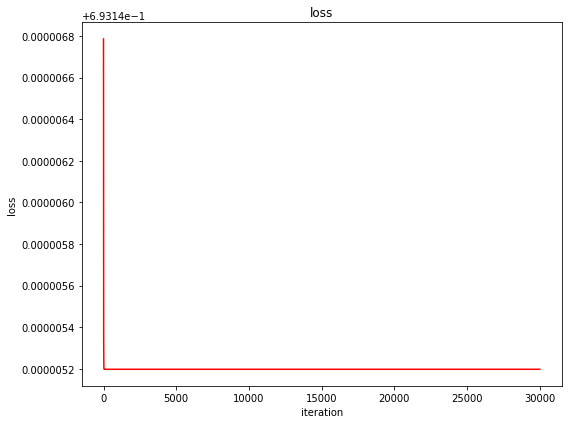

In [18]:
plot_loss_curve(loss1_iteration)

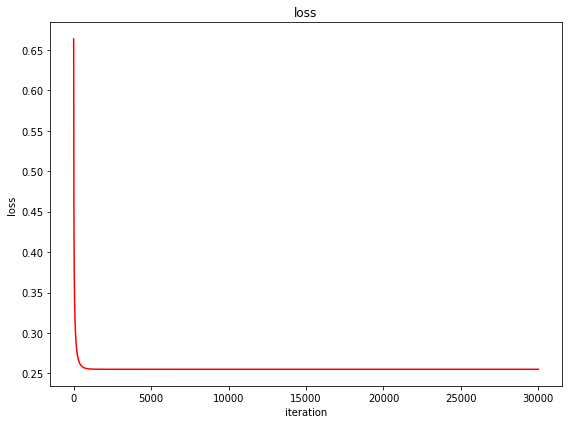

In [19]:
plot_loss_curve(loss2_iteration)

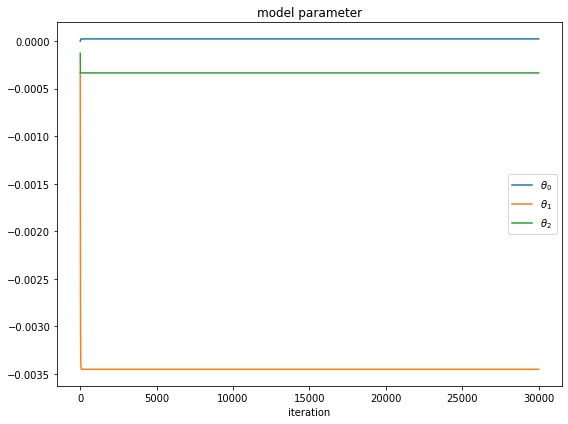

In [20]:
plot_model_parameter(theta1_iteration)

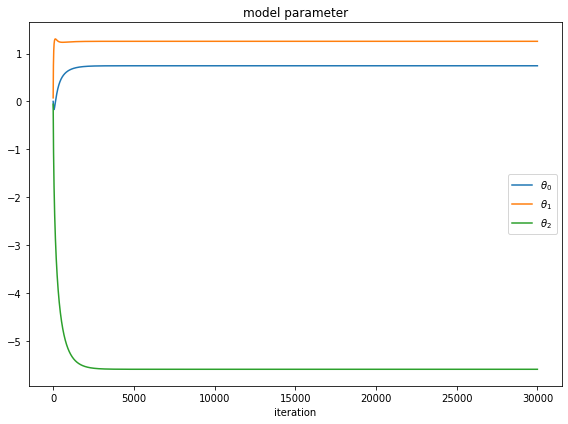

In [21]:
plot_model_parameter(theta2_iteration)

In [22]:
def plot_classifier1(data, theta):
    
    plt.figure(figsize=(8,8)) # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

In [23]:
def plot_classifier2(data, theta):
    
    plt.figure(figsize=(8,8)) # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

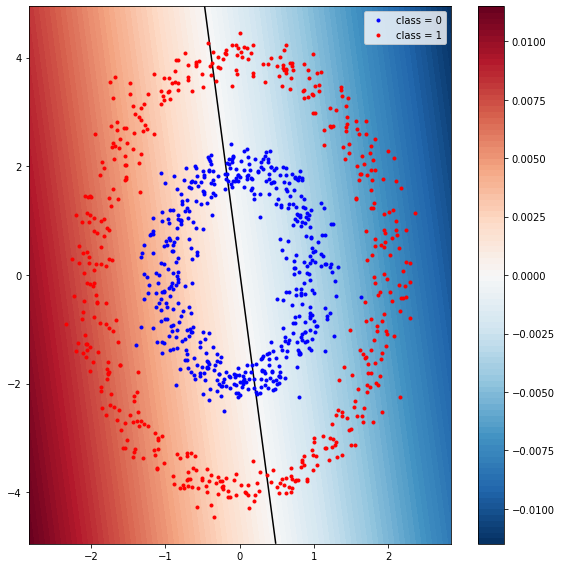

In [24]:
plot_classifier1(data1, theta1_optimal)

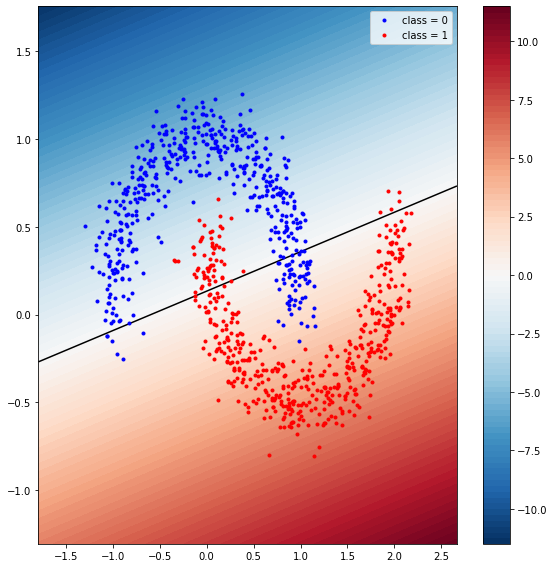

In [25]:
plot_classifier2(data2, theta2_optimal)

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

# * results

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

### # 01. plot the input data (data1) from the file [assignment_09_data1.txt] in blue for class 0 and in red for class 1

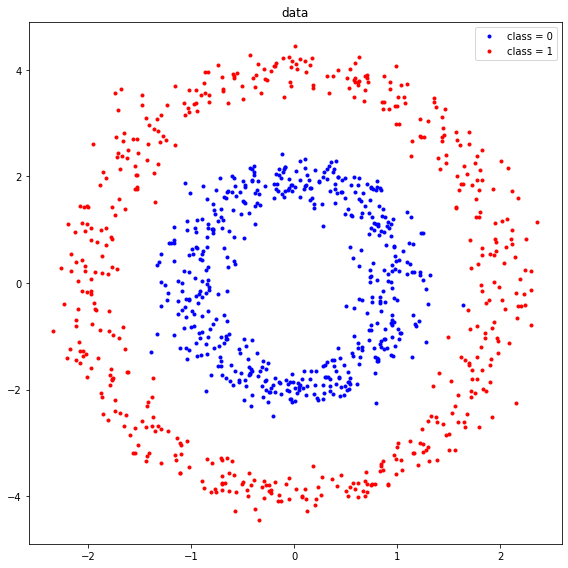

In [26]:
plot_data(data1)

### # 02. plot the input data (data2) from the file [assignment_09_data2.txt] in blue for class 0 and in red for class 1

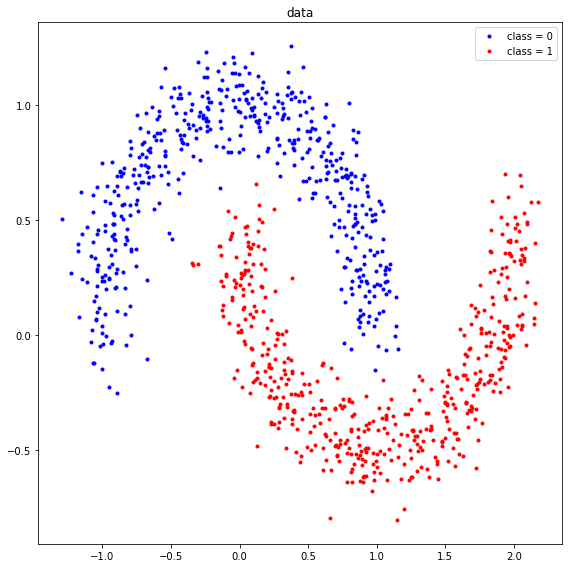

In [27]:
plot_data(data2)

### # 03. plot the values of the model parameters $\theta$ as curves over the gradient descent iterations using different colors for data1

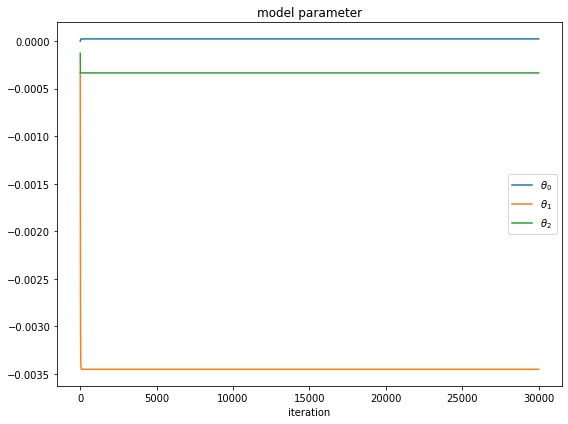

In [28]:
plot_model_parameter(theta1_iteration)

### # 04. plot the values of the model parameters $\theta$ as curves over the gradient descent iterations using different colors for data2

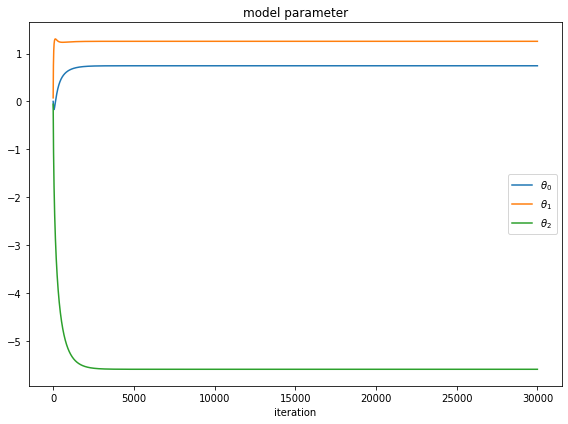

In [29]:
plot_model_parameter(theta2_iteration)

### # 05. plot the loss values in red curve over the gradient descent iterations for data1

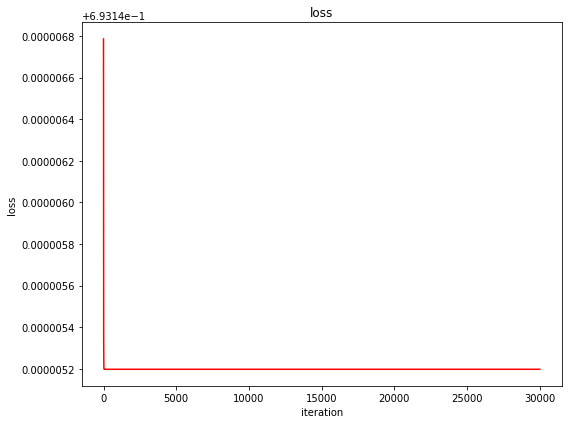

In [30]:
plot_loss_curve(loss1_iteration)

### # 06. plot the loss values in red curve over the gradient descent iterations for data2

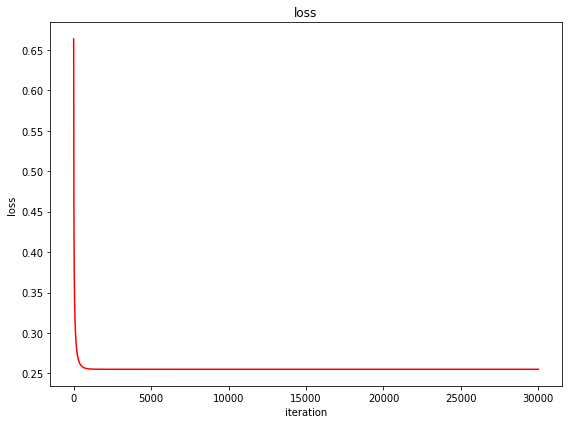

In [31]:
plot_loss_curve(loss2_iteration)

### # 07. plot the classifier with the given data points superimposed for data1

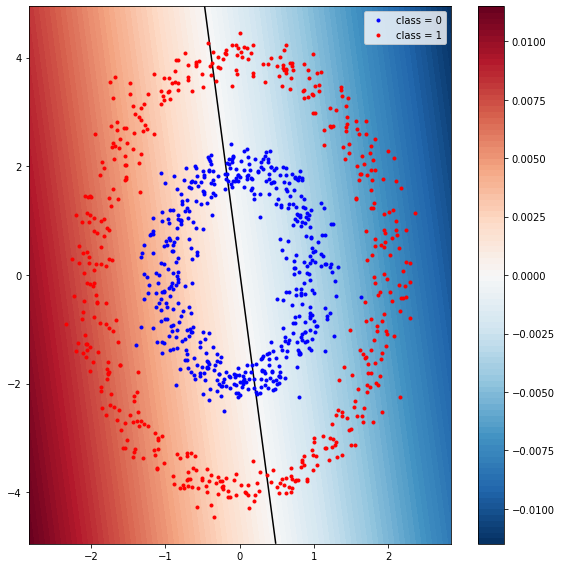

In [32]:
plot_classifier1(data1, theta1_optimal)

### # 08. plot the classifier with the given data points superimposed for data2

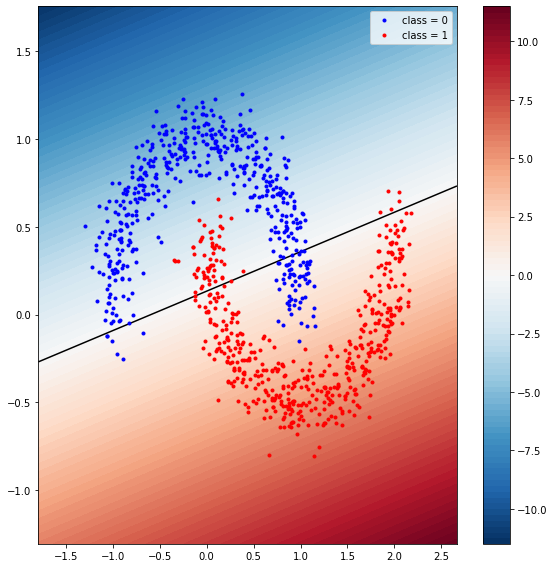

In [33]:
plot_classifier2(data2, theta2_optimal)

### # 09. print out the accuracy of the obtained classifier1 for data1

In [34]:
print(accuracy_classifier1)

0.505


### # 10. print out the accuracy of the obtained classifier2 for data1

In [35]:
print(accuracy_classifier2)

0.868
